In [1]:
import matplotlib.pyplot as plt
import numpy as np
from data_read import read_obs
import copy
import torch
import pickle
from analysis_utils import marked_dist_plot, plot_actual_data, violin_plots, glassdelta_effect_size, rmse
import os
import pandas as pd
from scipy.stats import gaussian_kde, bayes_mvs
import seaborn as sns
from sbi import utils as utils
from sbi.inference.base import infer
import time
import configparser
from model import Model

train = False

In [2]:
all_labels = ['Aud Delay (ms)',
          'Somat Delay (ms)',
          'Fb Noise Var (log)',
          'Fb Noise Ratio (Aud:Som)',
          'Controller Gain']

def simulator_no_noise(parameter_set):
    config = configparser.ConfigParser()
    config.read('pitch_pert_configs.ini')
    override_params(config,parameter_set)
    model = Model(config)
    y_output,errors = model.run()
    pitch_output = y_output[:,0,0]
    pitch_output[pitch_output < 50] = 50
    pitch_baseline = np.mean(pitch_output[0:50])
    pitch_output_cents = 1200 * np.log2(pitch_output/pitch_baseline)
    return pitch_output_cents

def override_params(config,parameter_set):
    config['Observer']['aud_fdbk_delay'] = str(parameter_set[0].item())
    config['Observer']['somat_fdbk_delay'] = str(parameter_set[1].item())
    config['Vocal_Tract']['aud_noise_covariance'] = str(10**parameter_set[2].item())
    config['Vocal_Tract']['somat_noise_covariance'] = str(10**parameter_set[2].item() / parameter_set[3].item())
    config['Controller']['controller_gain'] = str(parameter_set[4].item())

def simulator(parameter_set):
    training_noise_scale = 7
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise
            
def sbi_train(simulator,prior_min,prior_max,seed,n_simulations,filename):
    prior = utils.torchutils.BoxUniform(low=torch.as_tensor(prior_min), high=torch.as_tensor(prior_max))
    np.random.seed(seed)
    torch.manual_seed(seed)
    start = time.time()
    posterior = infer(simulator,prior,method='SNPE', num_simulations=n_simulations, num_workers=4)
    end = time.time()
    posterior_save = {'prior_min':prior_min,'prior_max':prior_max,'posterior':posterior,'seed':seed}
    with open('posterior/'+ filename + '_seed' + str(seed) + '.pkl', "wb") as handle:
        pickle.dump(posterior_save,handle)
    minutes = (end-start) / 60
    print('TRAINING TIME: ' + str(minutes) + ' min')
    
def sample_posterior(filename,obs_list,seed,labels,plot=True):
    np.random.seed(seed)
    torch.manual_seed(seed)
    with open('posterior/'+ filename + '_seed' + str(seed) + '.pkl', 'rb') as handle:
        posterior_dict = pickle.load(handle)
    posterior_new = posterior_dict.get('posterior')
    prior_min = posterior_dict.get('prior_min')
    prior_max = posterior_dict.get('prior_max')
    all_samples = np.ndarray([n_samples,len(labels),len(obs_list)])
    for i, observation in enumerate(obs_list):
        start = time.time()
        samples = posterior_new.sample((n_samples,), x=observation.get('data'))
        end = time.time()
        all_samples[:,:,i] = samples.numpy()
        log_probability = posterior_new.log_prob(samples, x=observation.get('data'))
        max_joint_likelihood = samples[torch.argmax(log_probability)]
        medians = torch.median(samples,axis=0).values
        print('SAMPLING TIME: ' + str((end-start)/60) + ' min')
        if plot: 
            fig = marked_dist_plot(samples, prior_min, prior_max, labels, max_likelihood=max_joint_likelihood, medians=medians, name=observation.get('name'))
            if not os.path.exists('sbi_figures/'): os.makedirs('sbi_figures/')
            fig.savefig('sbi_figures/marginal_dist_' + observation.get('name') + '_' + filename + '_seed' + str(seed) + '.png',format='png')
            plt.show()
    if plot:
        effect_size = glassdelta_effect_size(all_samples[:,:,0],all_samples[:,:,1])
        fig = violin_plots(obs_list,all_samples,prior_min,prior_max,effect_size_list=effect_size,labels=labels,show=False)
        fig.savefig('sbi_figures/violin_plots_' + observation.get('name') + '_' + filename + '_seed' + str(seed) + '.png',format='png')
        plot_actual_inferred_data(obs_list,np.median(all_samples,axis=0),xlabel=True,ylabel=True,legend=True)
    return all_samples

def plot_actual_inferred_data(obs_list,max_likelihood_params,ax=None,name=None,xlabel=False,ylabel=False,ylim=[-5,45],legend=True,title='',figlabel=''):
    ntrials = 100
    rmse_all = np.ndarray((len(obs_list), ntrials))
    if ax is None:
        fig, ax = plt.subplots()
    ax.text(-0.6,20,title,ha='center',va='center',rotation=90,size=24,fontweight='bold')
    ax.text(-0.7,50,figlabel,ha='center',va='center',size=45)
    plot_actual_data(obs_list,ax,xlabel,ylabel,ylim,legend=True)
    for i, obs in enumerate(obs_list):
        plot_color = obs.get('color')
        taxis = obs_list[0].get('taxis')
        inferred_all = np.ndarray((ntrials,len(taxis)))
        for j in range(ntrials):
            sim_output = simulator_no_noise(max_likelihood_params[:,i])
            inferred_all[j,:] = sim_output
            error = rmse(obs.get('data'), sim_output)
            rmse_all[i,j] = error
        inferred = np.mean(inferred_all,axis=0)
        sterr = np.std(inferred_all,axis=0) / np.sqrt(ntrials)
        ax.plot(taxis,inferred,label=obs.get('name')+' inferred',linewidth=5,color=plot_color)
        ax.plot(taxis,inferred-sterr, linewidth=2,color=plot_color)
        ax.plot(taxis,inferred+sterr, linewidth=2, color=plot_color)
    rmse_mean = np.mean(rmse_all,axis=1)
    rmse_sterr = np.std(rmse_all,axis=1) / np.sqrt(ntrials)
    return rmse_mean, rmse_sterr

def run_sbi(filename,obs_list,nreps,prior_min_all,prior_max_all,all_labels,train=True,ablate=None,verbose=True):
    labels = copy.deepcopy(all_labels)
    prior_min = copy.deepcopy(prior_min_all)
    prior_max = copy.deepcopy(prior_max_all)
    if ablate is not None:
        ablated_label = labels.pop(ablate)
        prior_min.pop(ablate)
        prior_max.pop(ablate)
        title = 'Fixed ' + ablated_label.split('(')[0]
        figlabel = ['A','B','C','D','E'][ablate]
    else: 
        title = ''
        figlabel = ''
    combined_samples = np.ndarray((n_reps*n_samples,len(labels),len(obs_list)))
    for seed in range(nreps):
        # train
        if train: sbi_train(simulator,prior_min,prior_max,seed,n_simulations,filename)
        # sample
        all_samples = sample_posterior(filename,obs_list,seed,labels,plot=verbose)
        for i in range(len(obs_list)):
            combined_samples[n_samples*seed:n_samples*(seed+1),:,i] = all_samples[:,:,i]
    inferred_values = np.median(combined_samples, axis=0)
    # bootstrap
    start = time.time()
    n_bootstrap = 100
    size_bootstrap = 1000
    combined_effect_size = np.ndarray([len(labels),n_bootstrap])
    for b in range(n_bootstrap):
        indeces = np.random.randint(0,n_samples*n_reps,size_bootstrap)
        subset = combined_samples[indeces,:,:]
        combined_effect_size[:,b] = glassdelta_effect_size(np.squeeze(subset[:,:,0]),np.squeeze(subset[:,:,1]))
    end = time.time()
    print('BOOTSTRAP TIME: ' + str((end-start)/60) + ' min')
    effect_size_list = np.mean(combined_effect_size, axis=1)
    effect_size_stderr = np.std(combined_effect_size,axis=1) / np.sqrt(n_bootstrap)
    start = time.time()
    rmse_mean, rmse_sterr = plot_actual_inferred_data(obs_list,inferred_values,xlabel=True,ylabel=True,legend=True,title=title,figlabel=figlabel)
    end = time.time()
    print('PLOT SIM TIME: ' + str((end-start)/60) + ' min')
    start = time.time()
    violin_plots(obs_list,combined_samples,prior_min,prior_max,effect_size_list=effect_size_list,effect_size_stderr=effect_size_stderr,labels=labels,conf_int_level=0.95,show=True)
    end = time.time()
    print('VIOLIN PLOT TIME: ' + str((end-start)/60) + ' min')
    return inferred_values, rmse_mean, rmse_sterr

In [3]:
observation_list = []
    
observation_list.append(read_obs('pitch_pert_data/CA_Data/','CA','jh','control',"#C7221F"))
observation_list.append(read_obs('pitch_pert_data/CA_Data/','CA','jh','patient',"#456990"))

C:\Users\jgaines\Anaconda3\envs\1d_sfc_env\lib\site-packages\numpy\core\fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


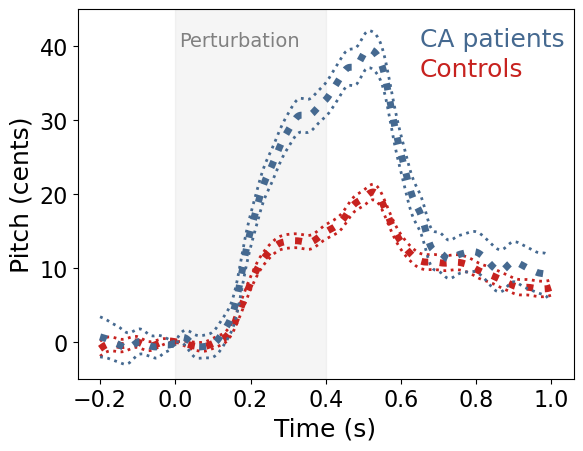

In [4]:
plot_actual_data(observation_list,xlabel='Time (s)',ylabel='Pitch (cents)',legend=True,show_pert=True,alpha=1)

In [5]:
n_simulations = 100000
n_samples = 10000
n_reps = 10
rmse_means_all = np.ndarray([6,len(observation_list)])
rmse_sterr_all = np.ndarray([6,len(observation_list)])

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013400002320607503 min


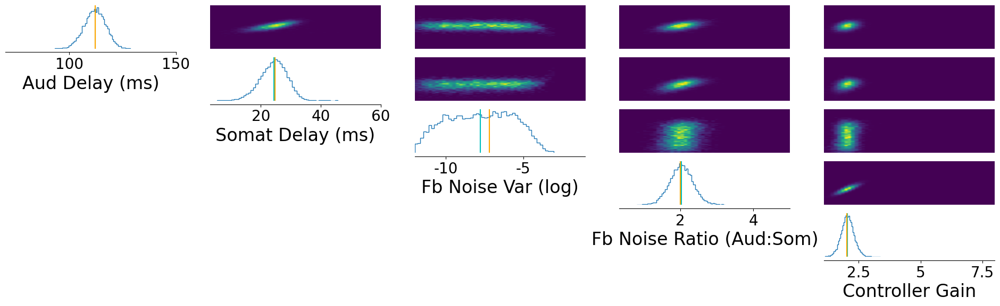

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013133347034454346 min


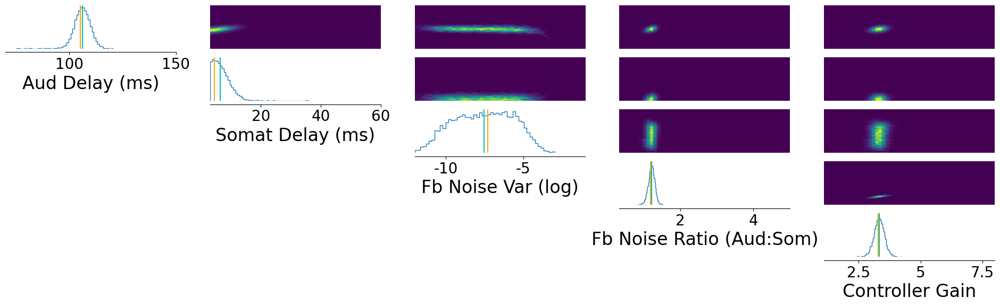

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.02326664129892985 min


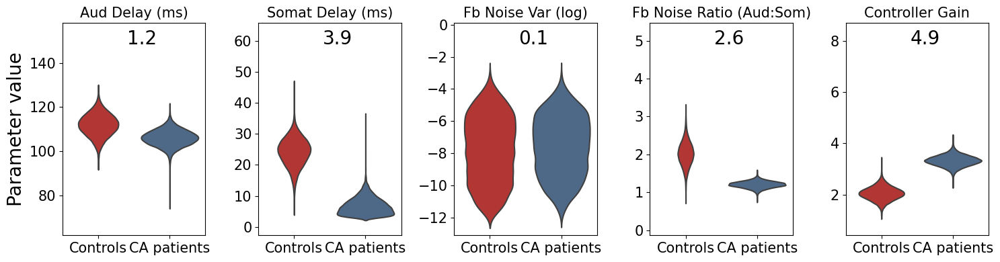

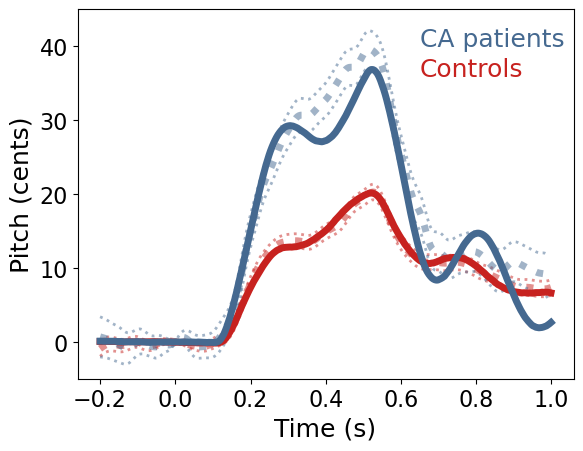

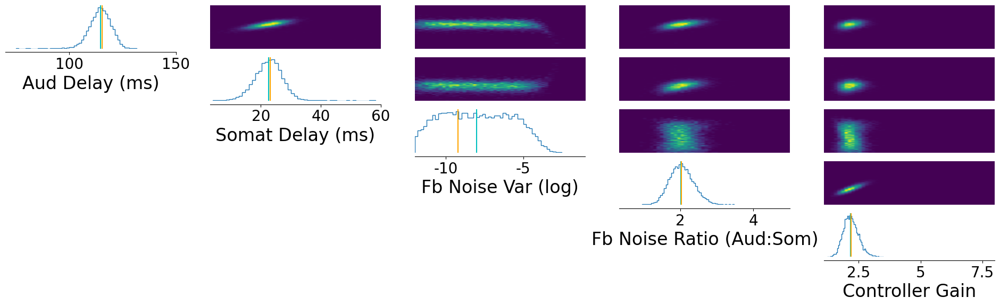

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.014866654078165691 min


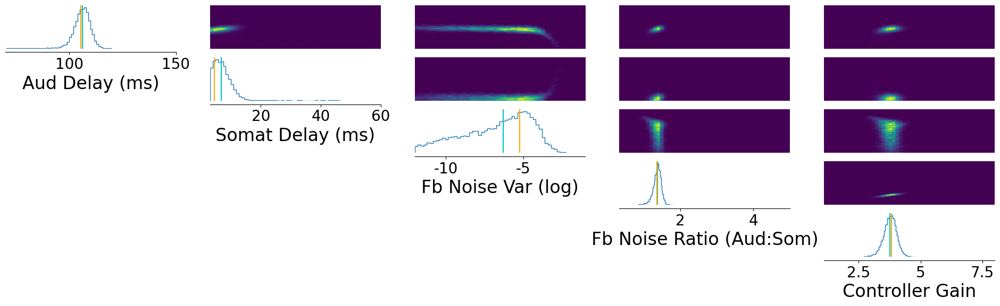

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013666657606760661 min


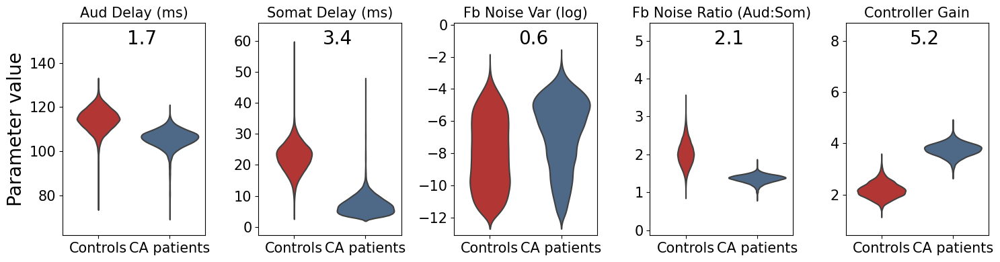

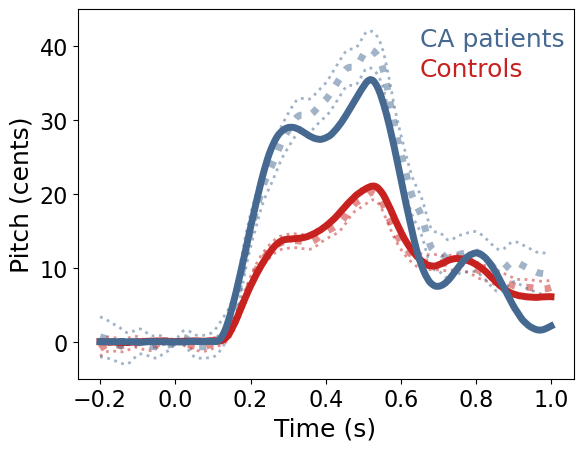

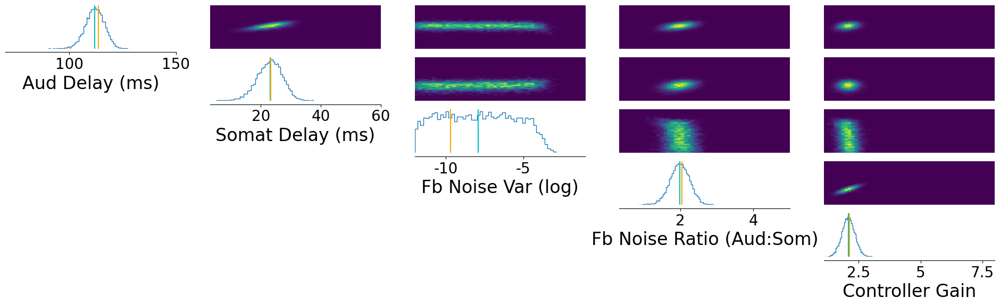

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.015383311112721761 min


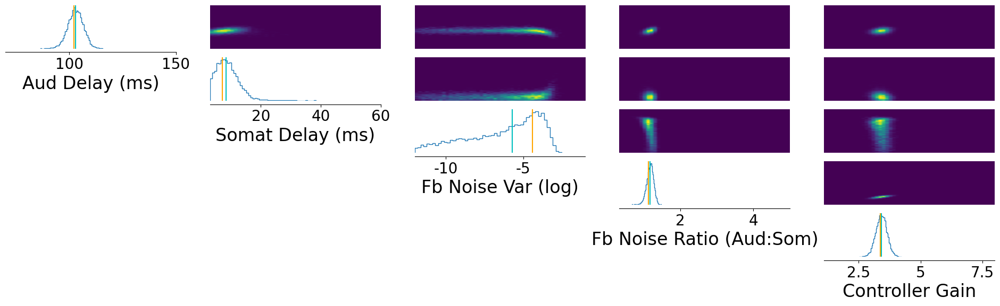

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012649997075398763 min


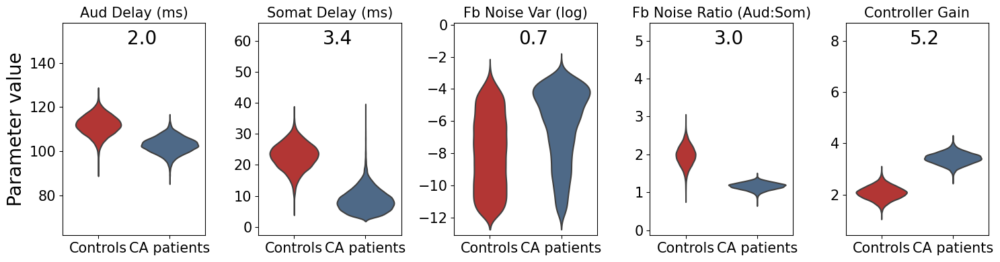

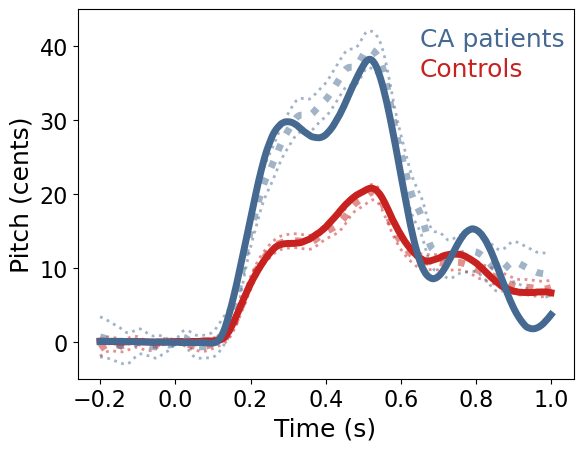

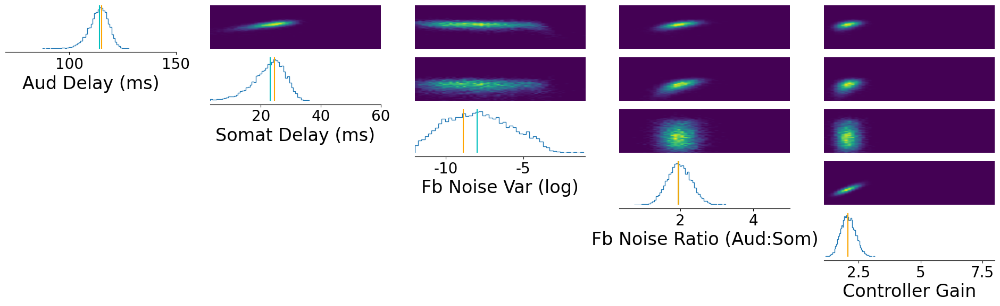

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013165489832560221 min


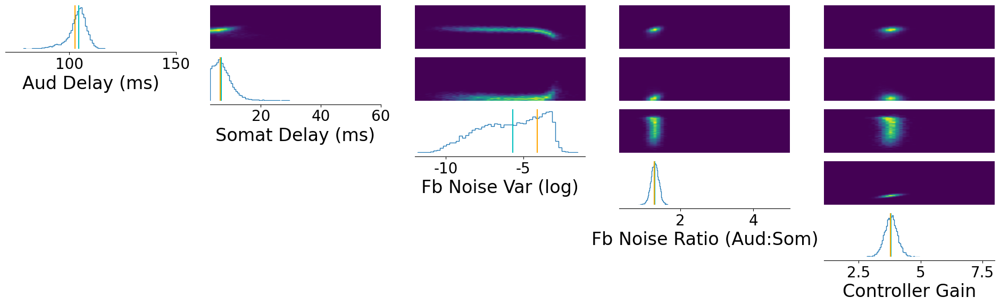

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013166622320810954 min


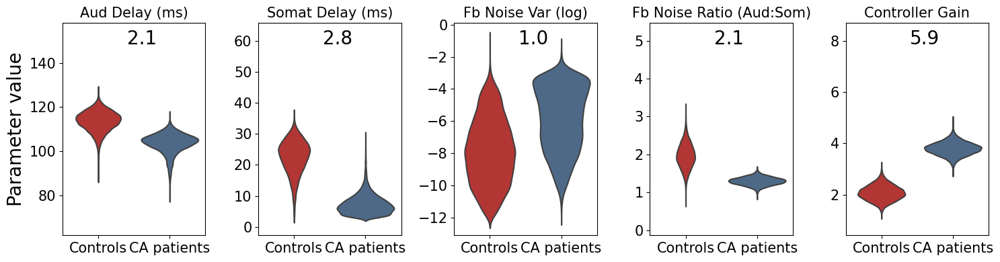

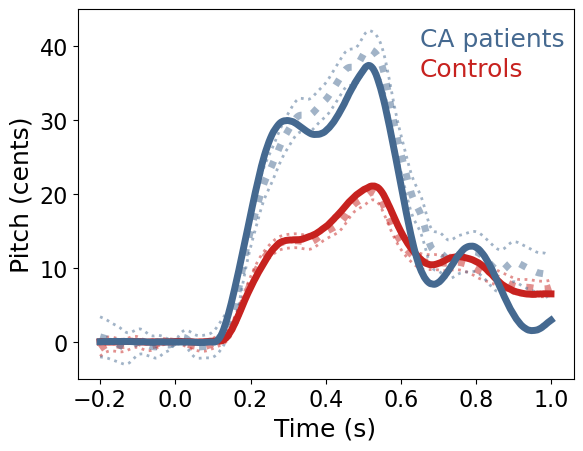

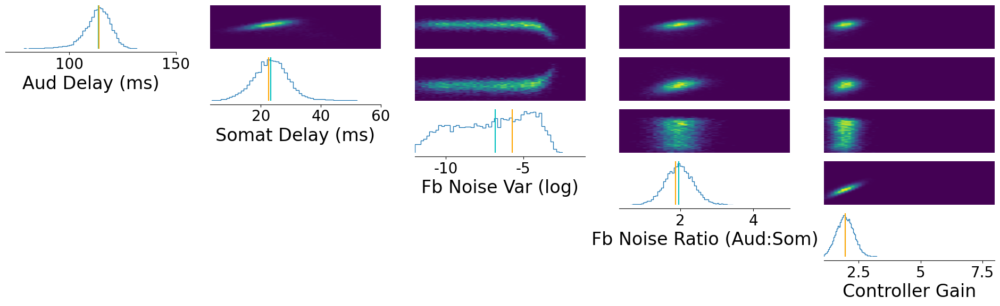

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.0238988200823466 min


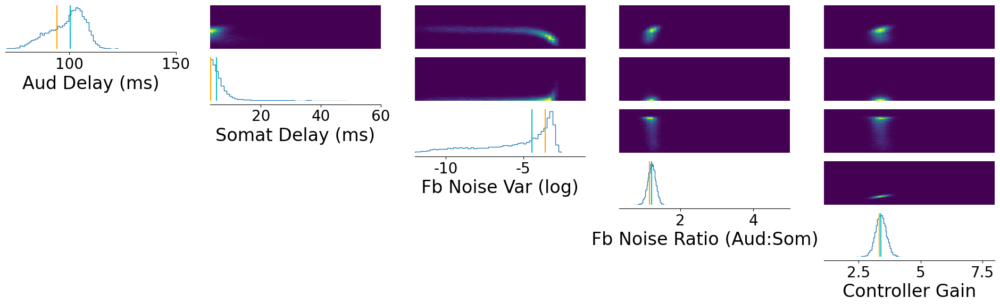

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013599960009257 min


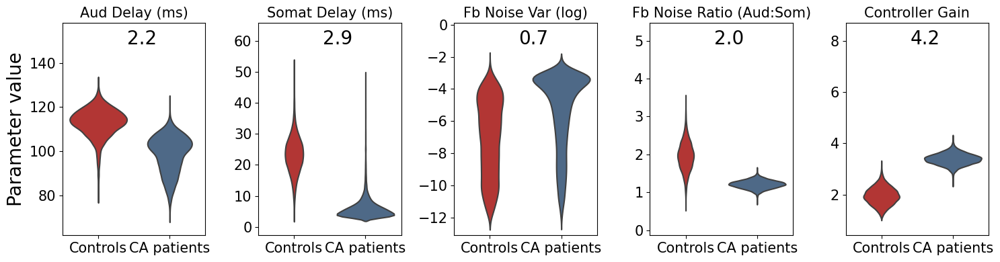

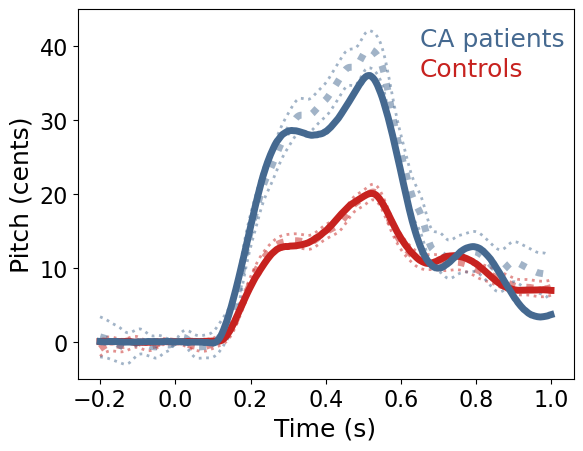

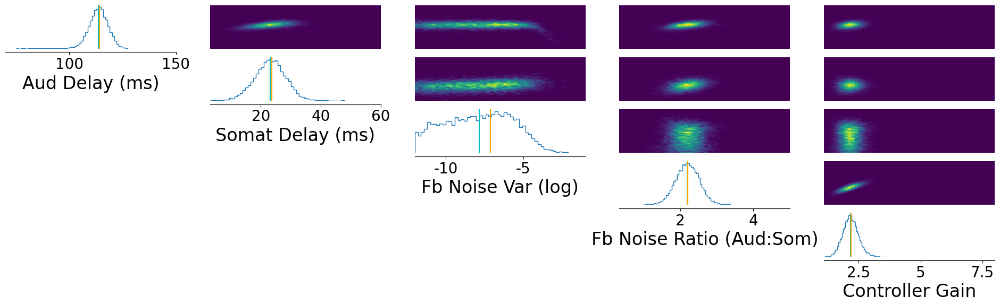

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.014516623814900716 min


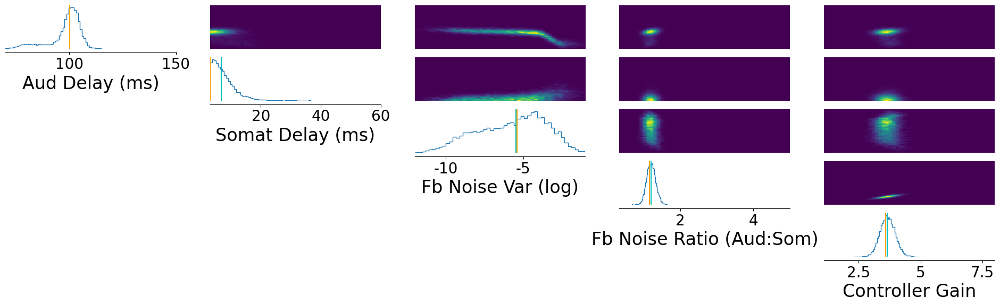

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01238170862197876 min


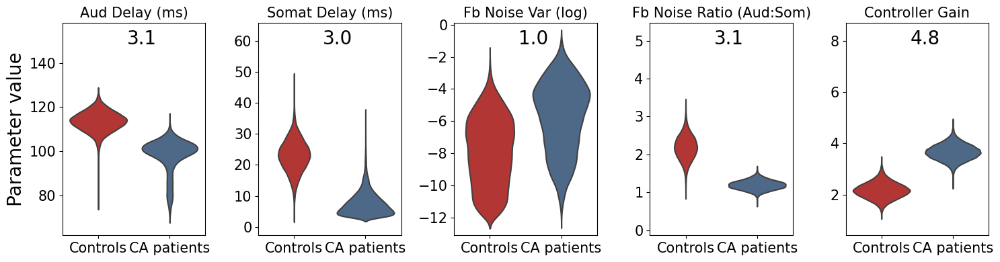

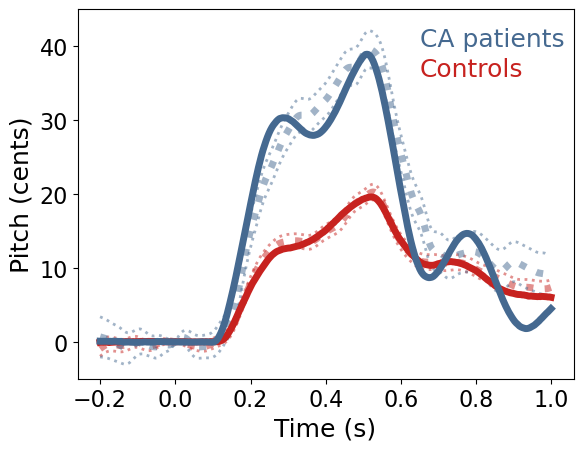

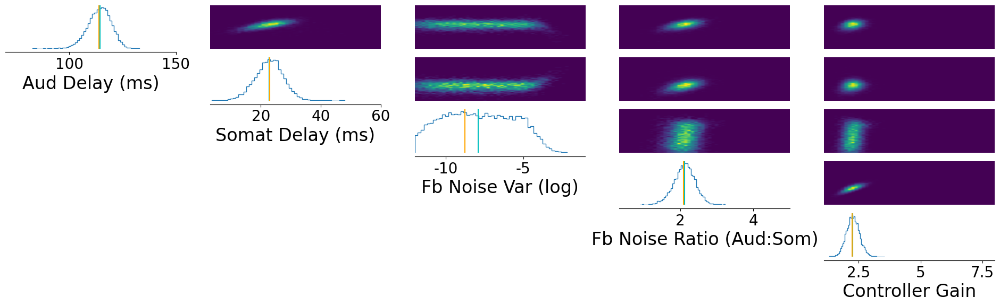

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01918295621871948 min


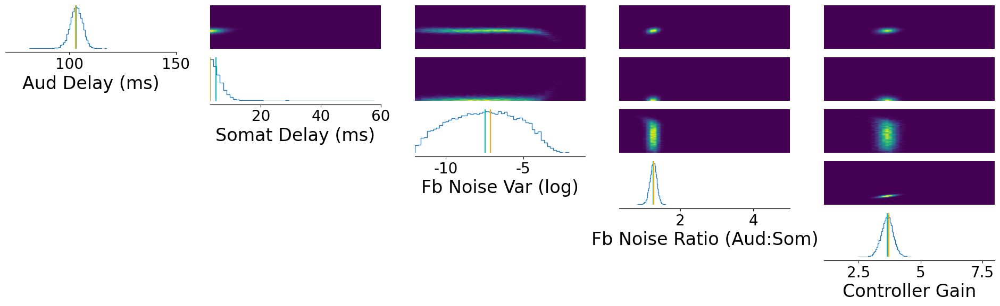

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012116650740305582 min


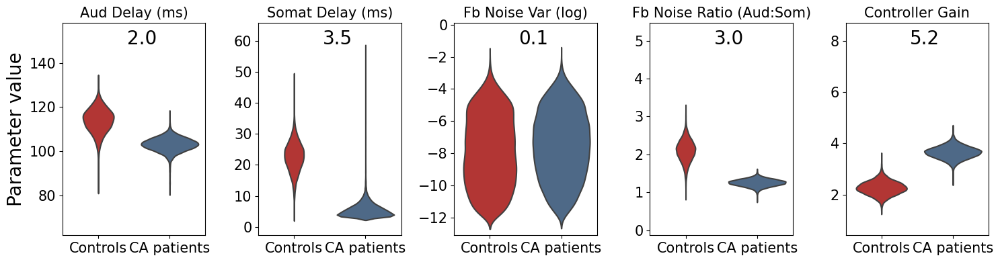

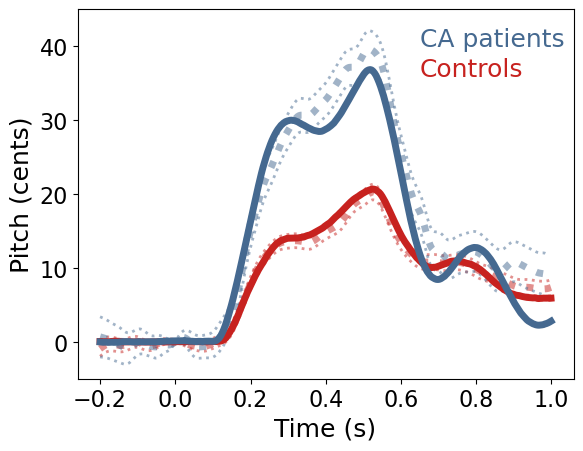

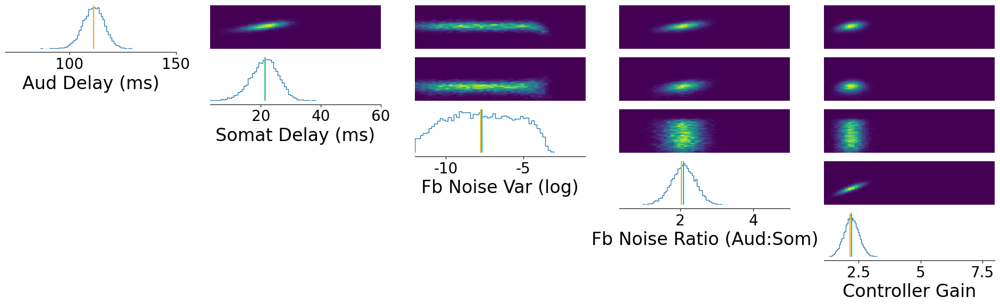

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.019015705585479735 min


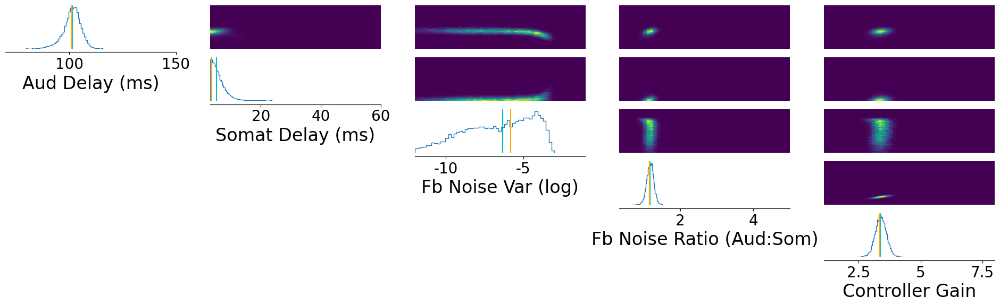

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013716653982798258 min


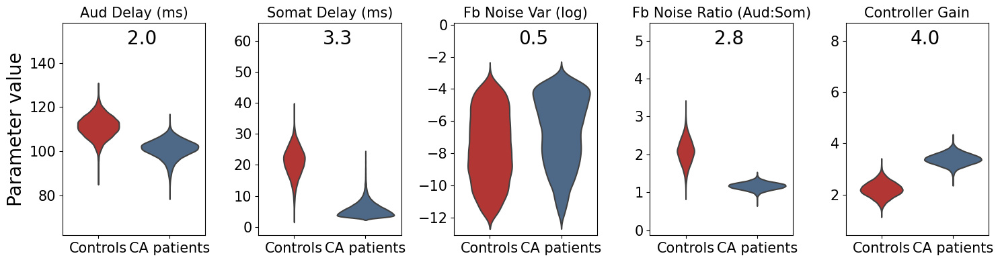

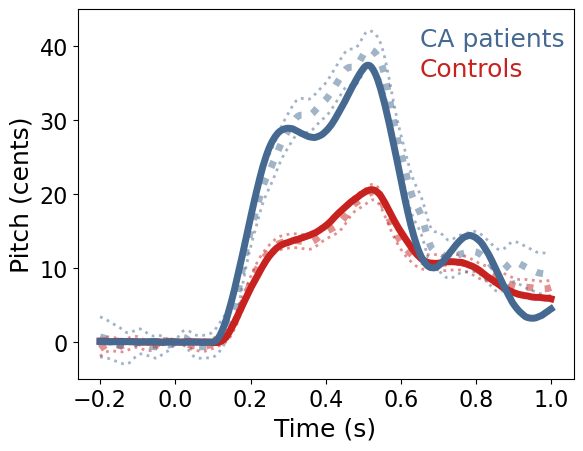

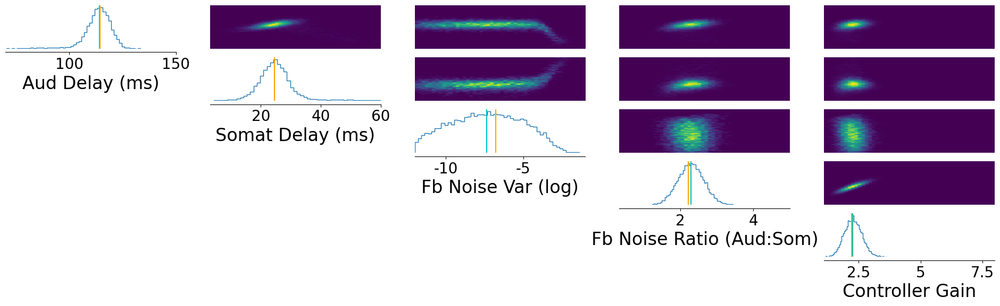

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.02083329757054647 min


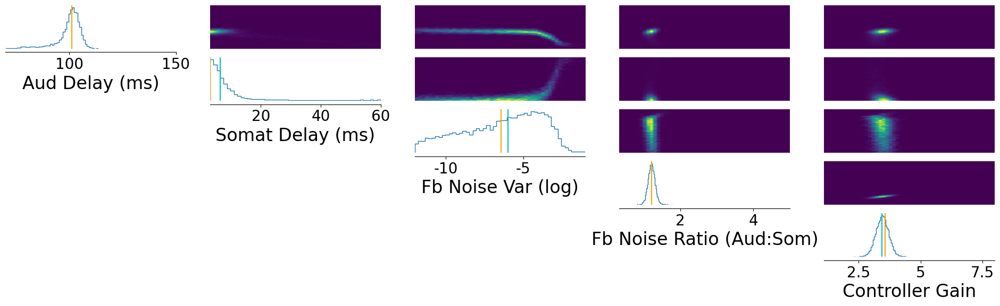

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01259998083114624 min


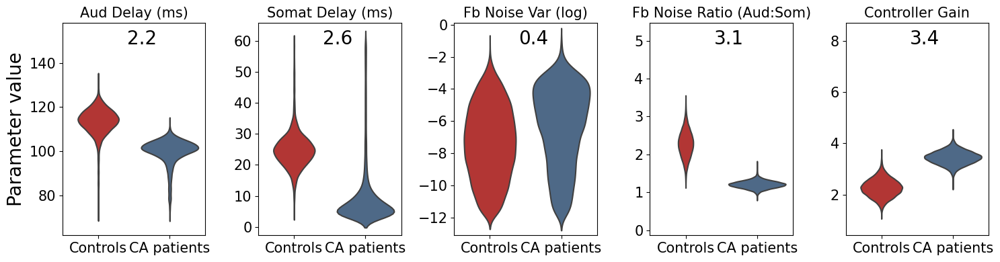

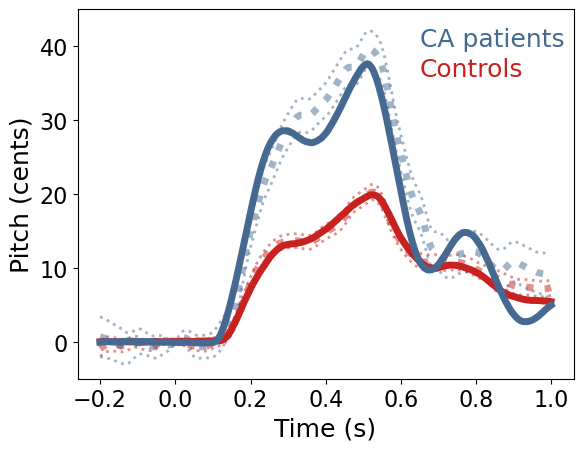

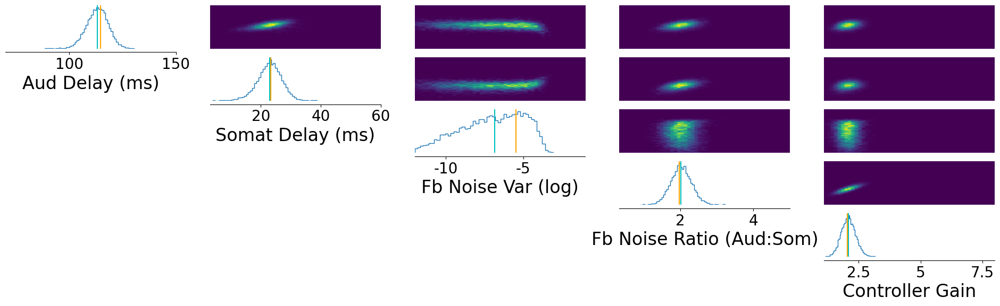

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012916628519694011 min


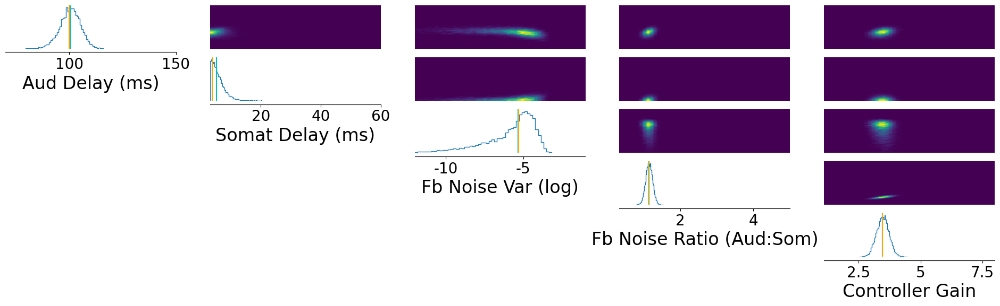

BOOTSTRAP TIME: 0.0003833333651224772 min
PLOT SIM TIME: 0.1534603277842204 min
VIOLIN PLOT TIME: 19.591823001702625 min


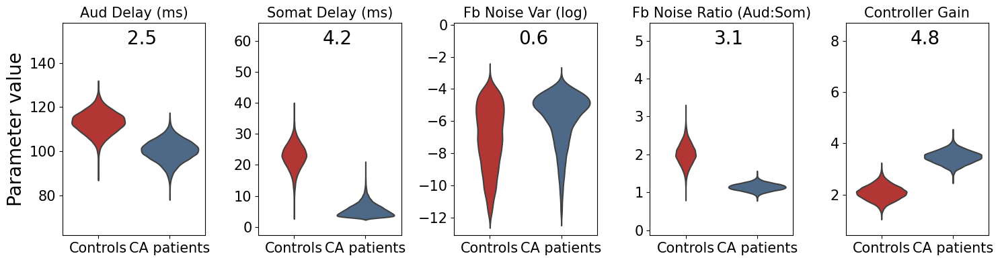

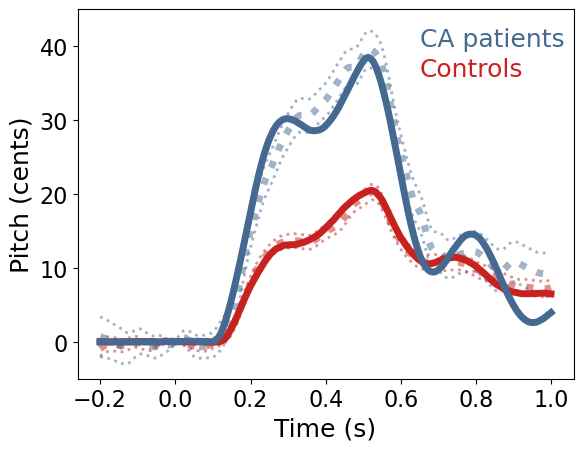

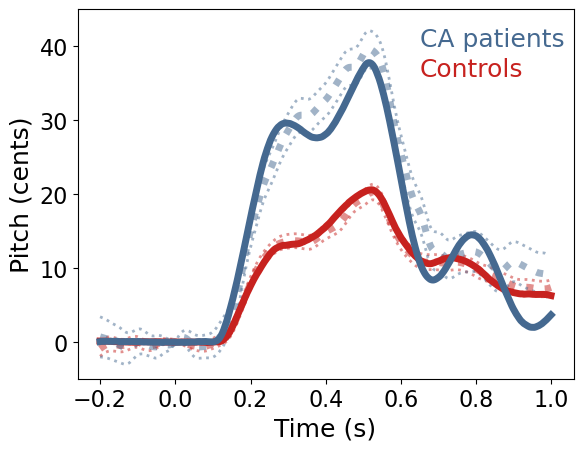

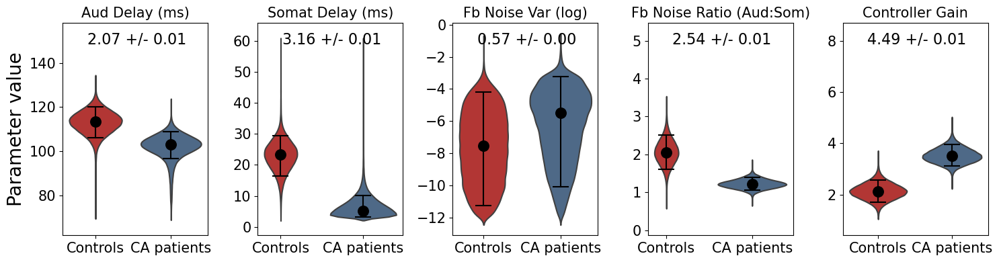

In [6]:
def simulator(parameter_set):
    training_noise_scale = 0
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

prior_min_all = [70, 3, -12, 0.3333, 1.1]
prior_max_all = [150, 60, -1, 5, 8]
inferred_values, rmse_means_all[0,:], rmse_sterr_all[0,:] = run_sbi('training_noise_0',observation_list,n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013399982452392578 min


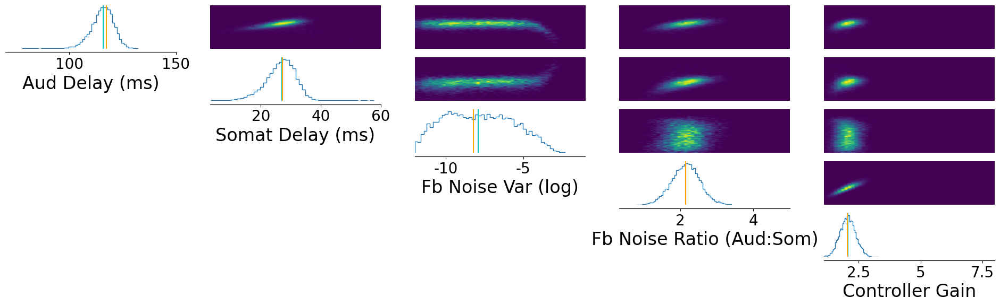

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.021316651503245035 min


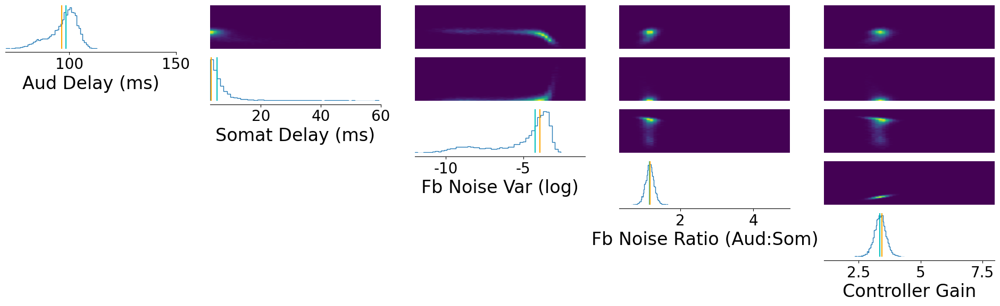

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.014699987570444743 min


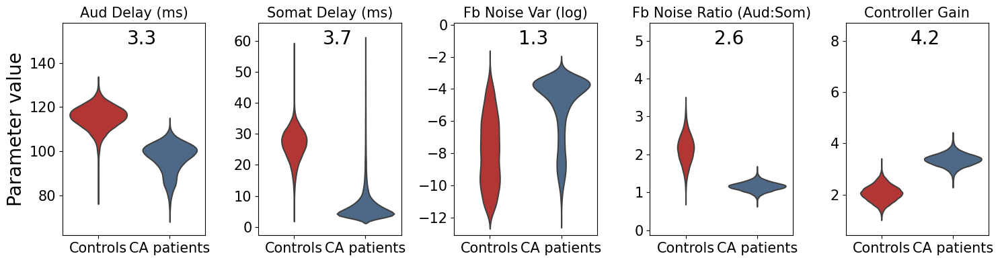

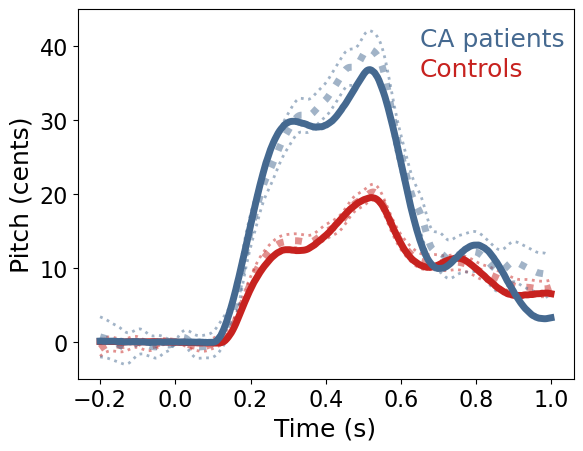

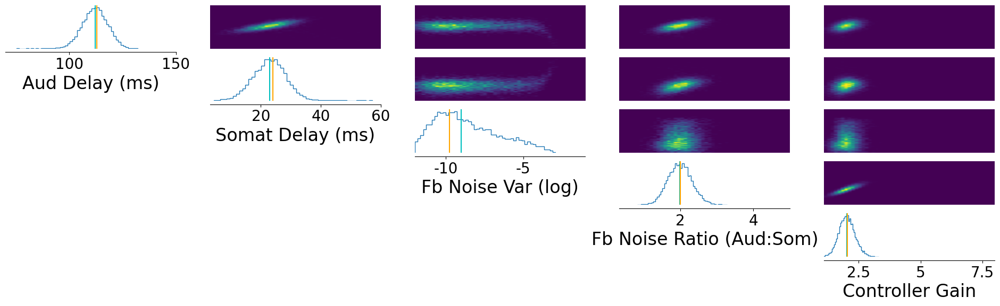

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01353314717610677 min


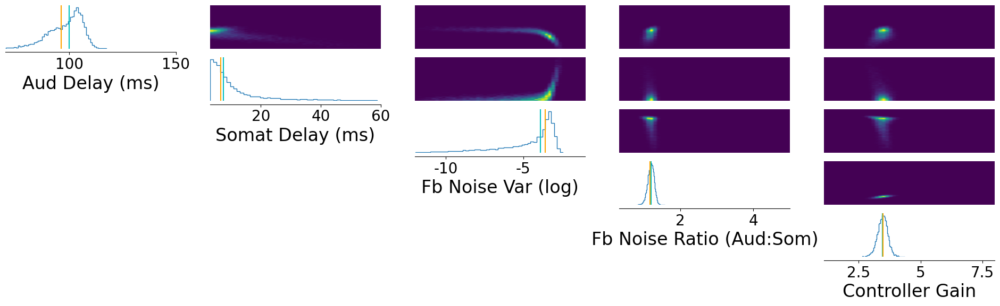

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013316655158996582 min


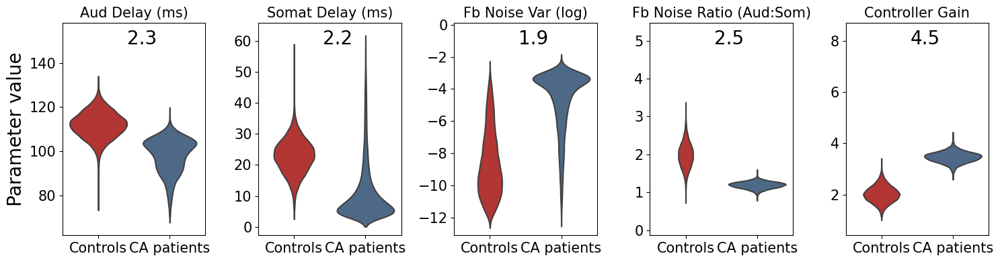

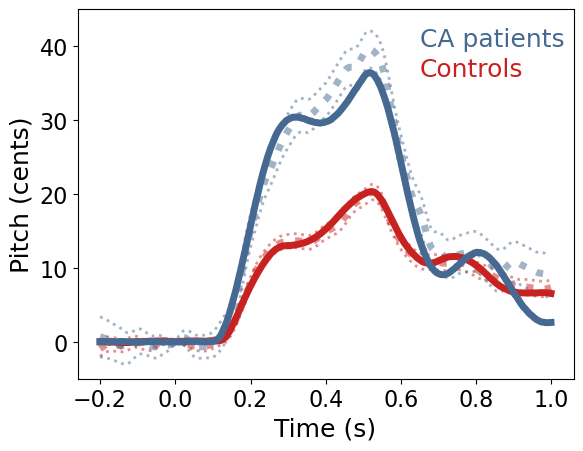

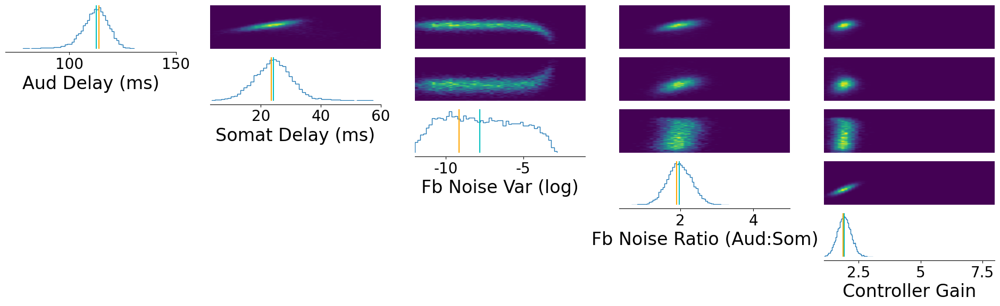

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013366663455963134 min


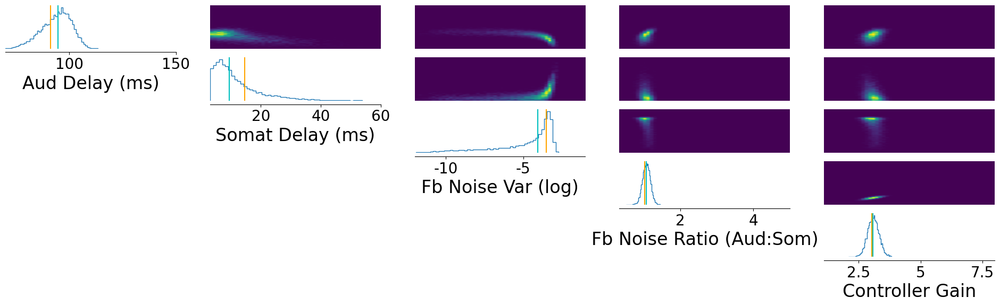

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.014066656430562338 min


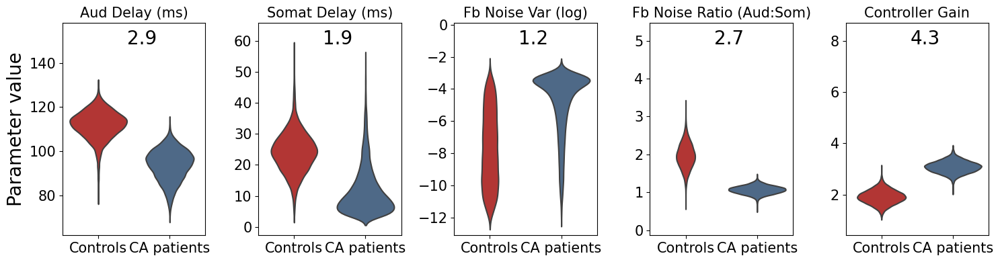

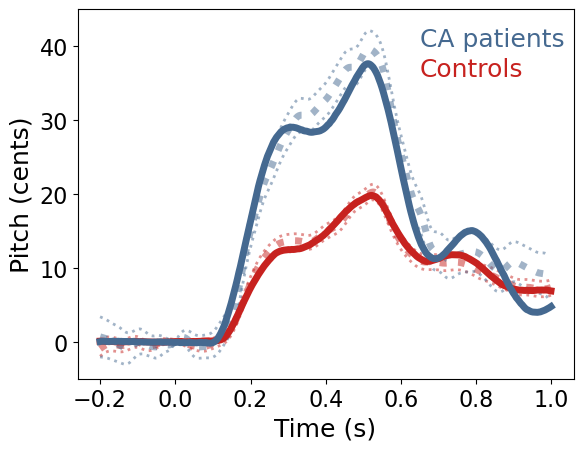

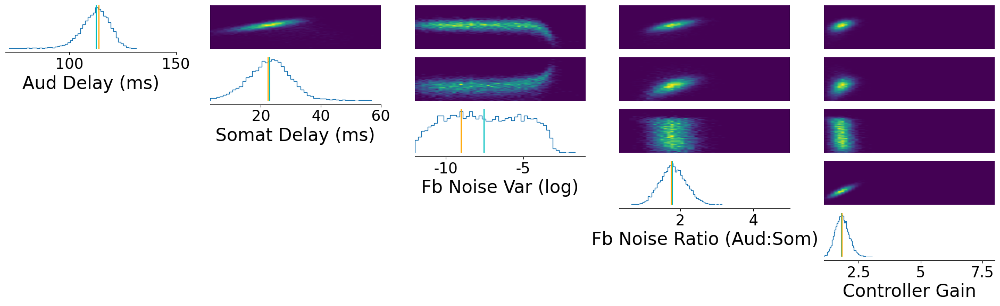

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013483341534932454 min


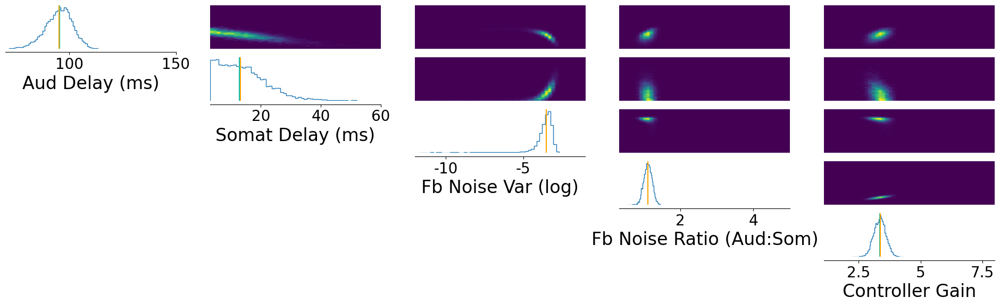

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012966656684875488 min


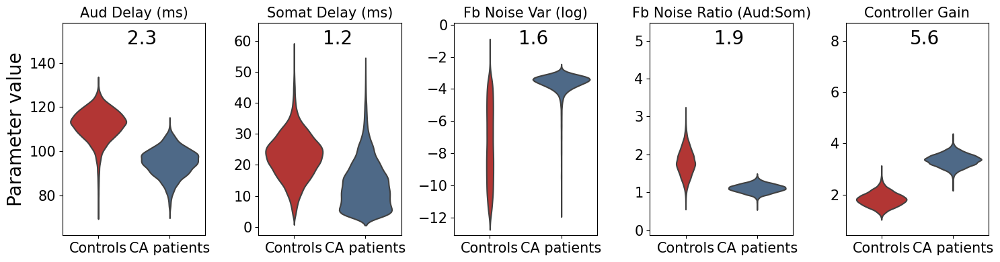

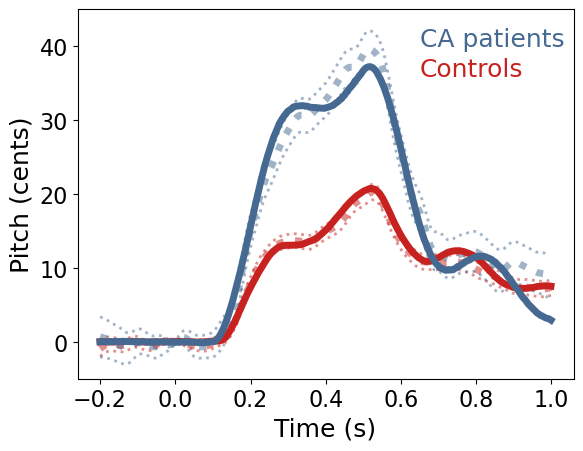

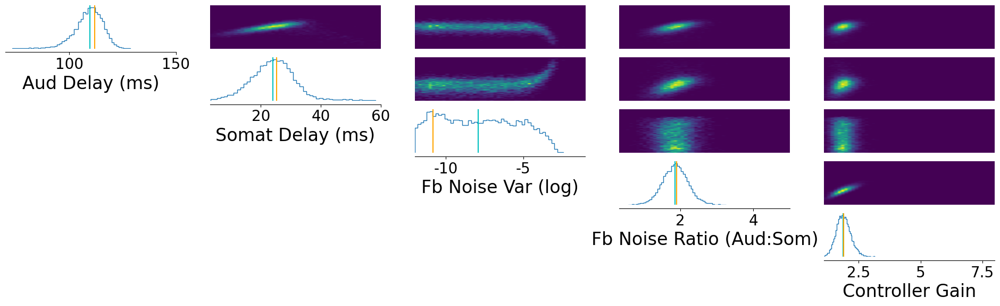

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013399728139241536 min


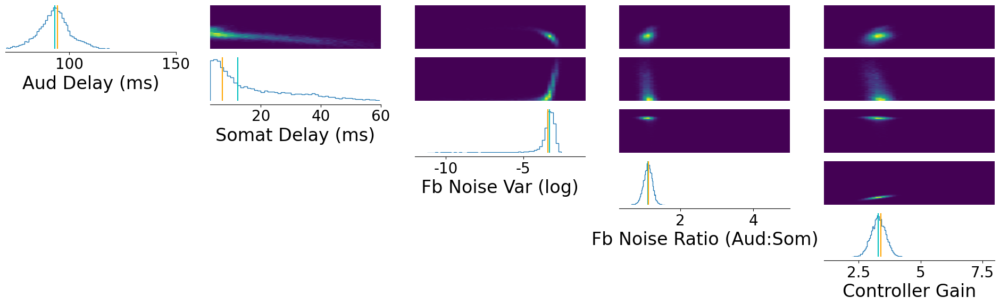

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01346211830774943 min


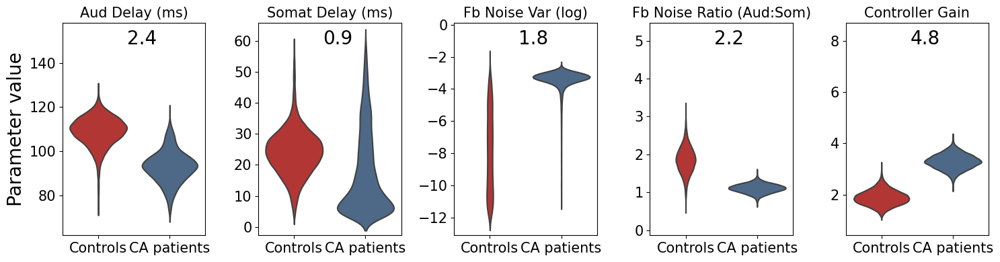

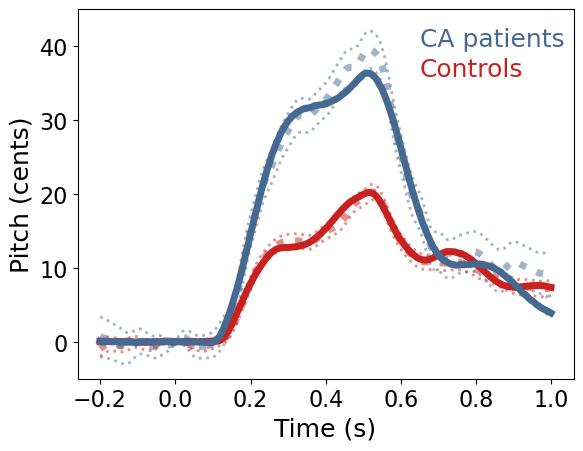

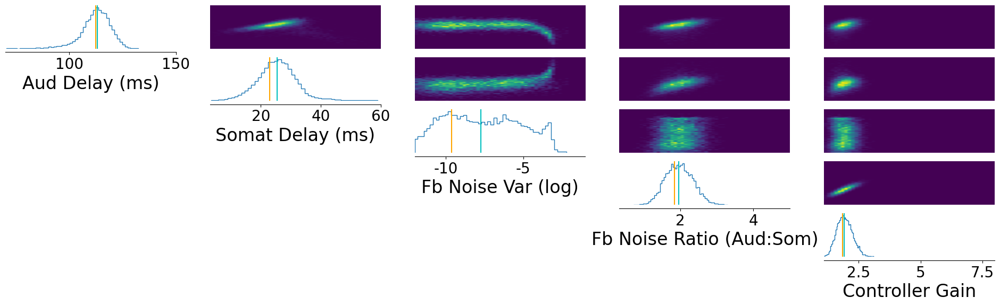

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01466666062672933 min


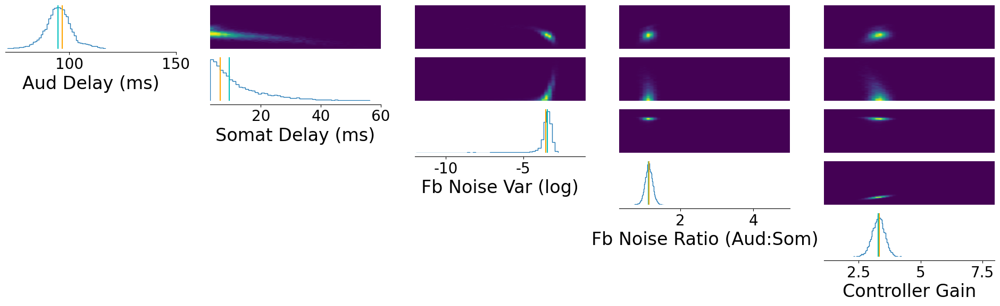

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013278722763061523 min


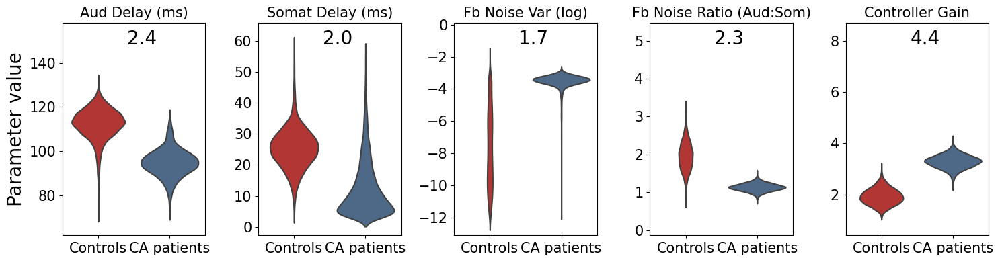

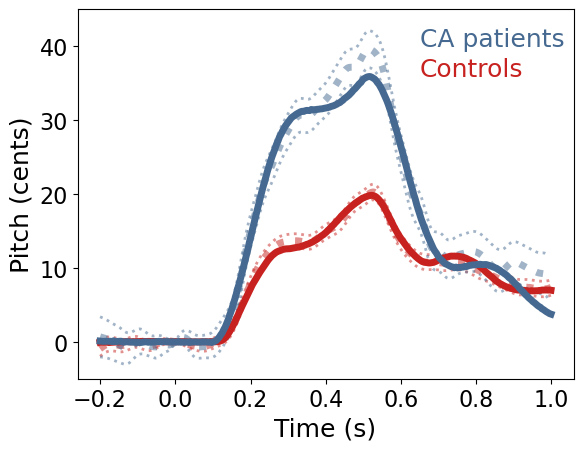

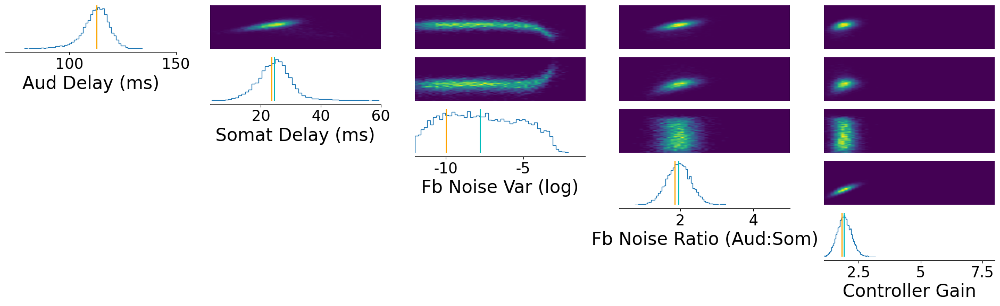

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.014349734783172608 min


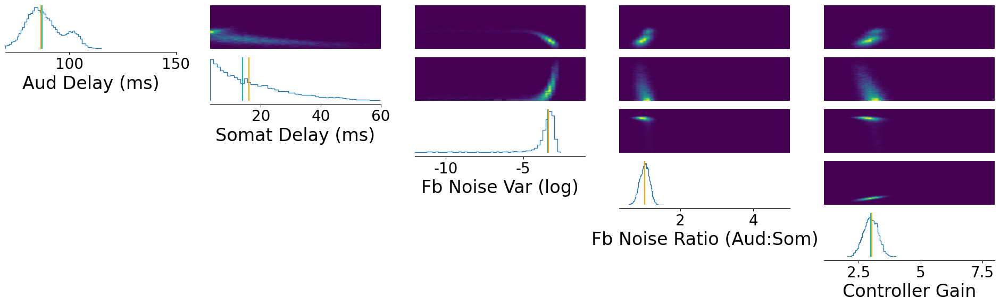

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012683316071828207 min


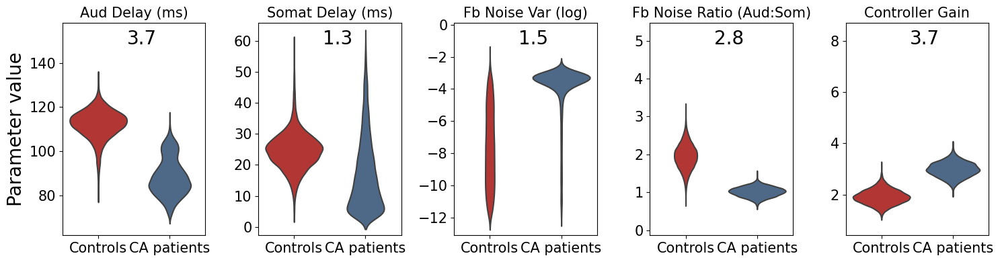

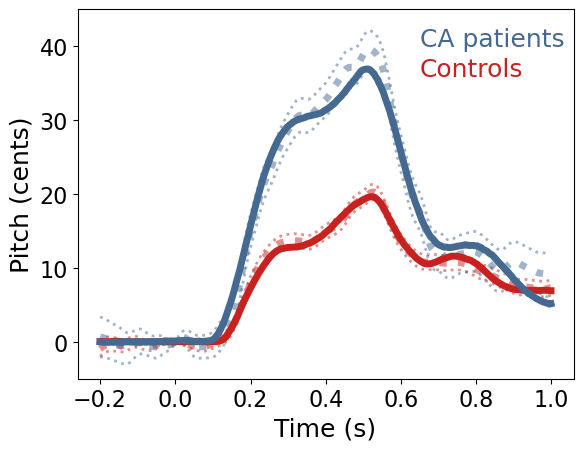

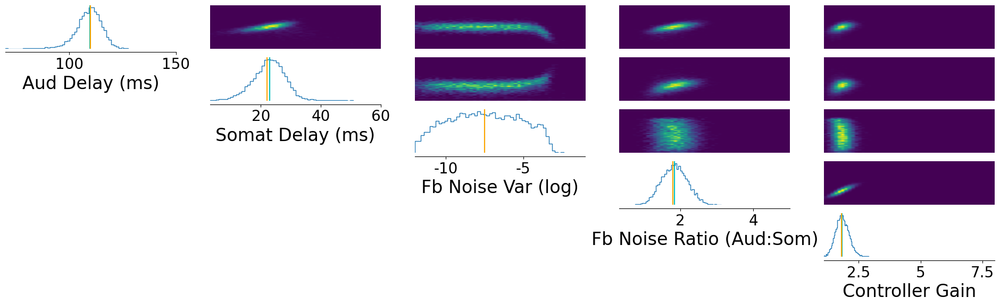

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.020799986521402993 min


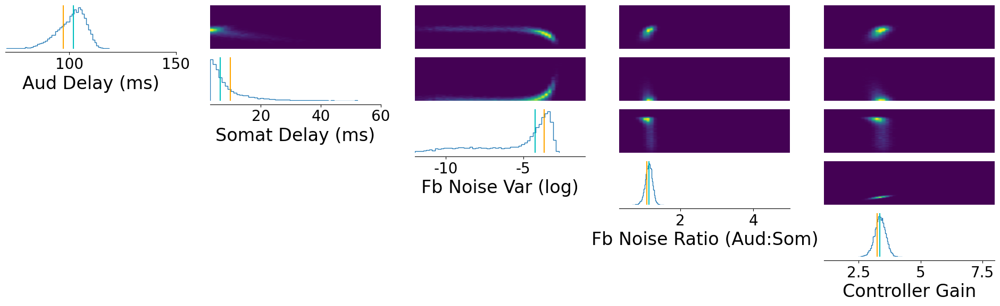

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012983163197835287 min


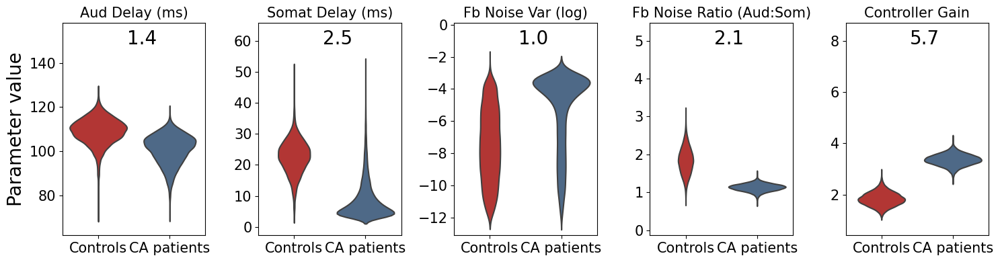

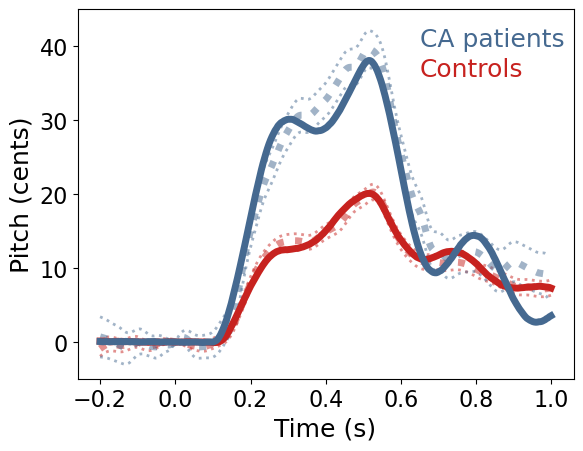

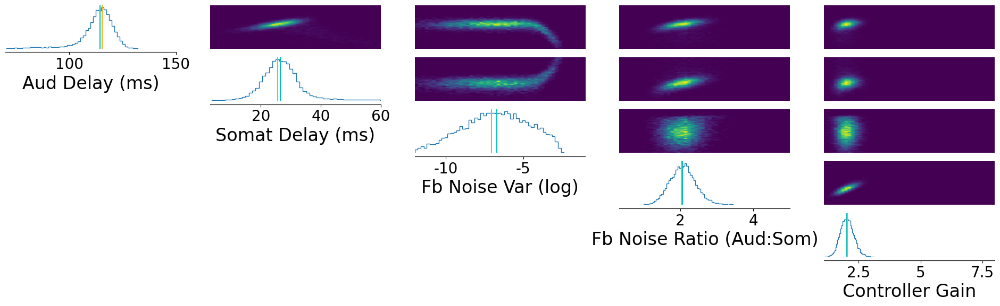

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013350069522857666 min


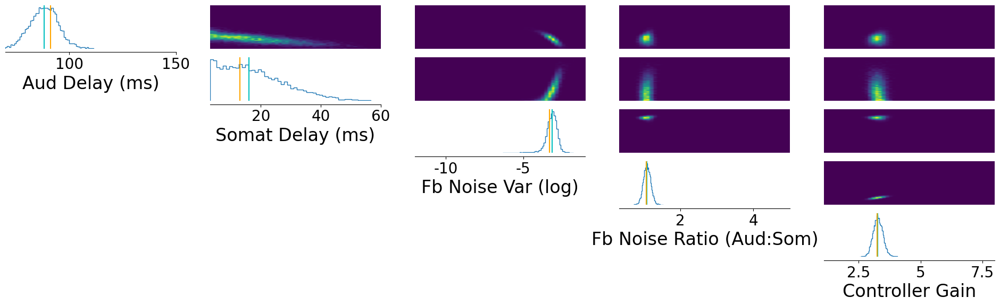

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01311569611231486 min


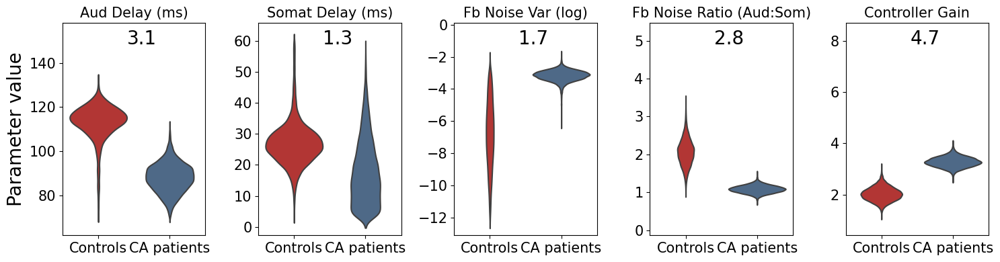

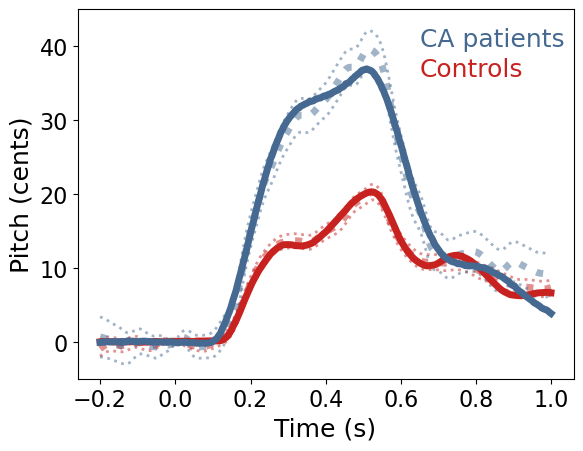

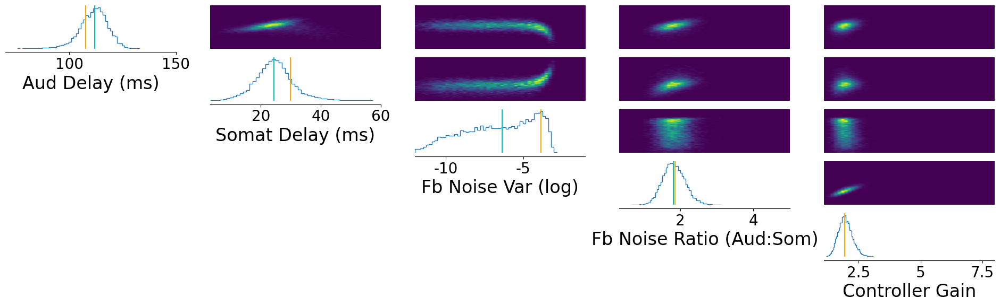

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.02028329372406006 min


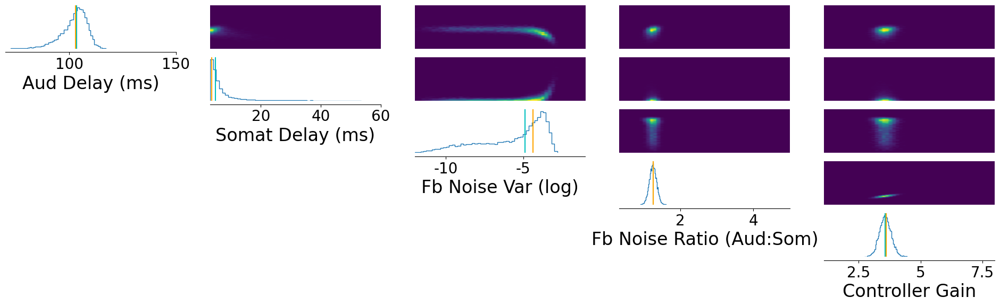

BOOTSTRAP TIME: 0.0004665652910868327 min
PLOT SIM TIME: 0.14523356358210246 min
VIOLIN PLOT TIME: 19.07371929883957 min


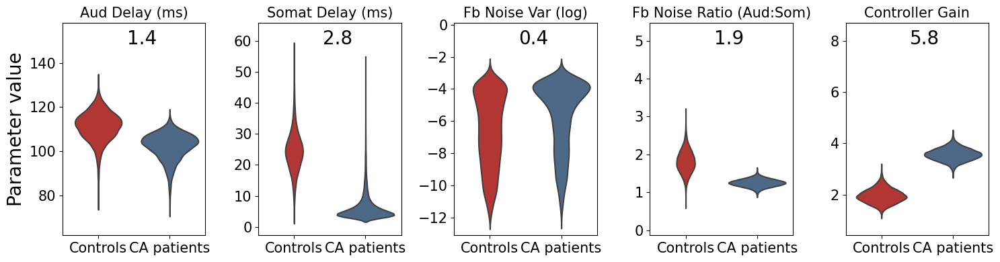

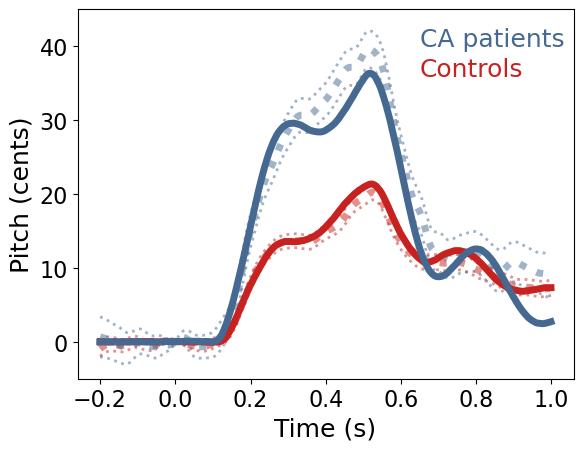

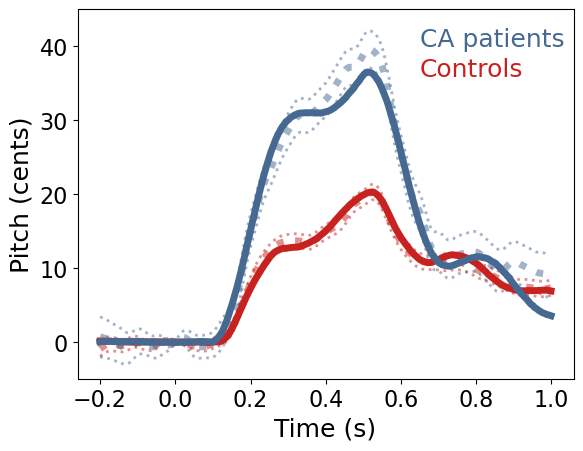

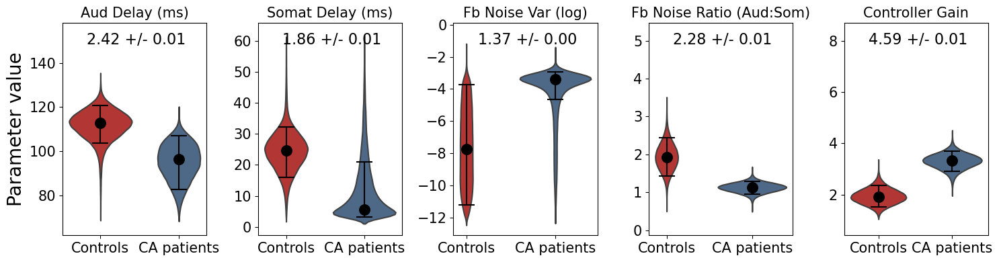

In [7]:
def simulator(parameter_set):
    training_noise_scale = 3
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

inferred_values, rmse_means_all[1,:], rmse_sterr_all[1,:] = run_sbi('training_noise_3',observation_list,n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013382172584533692 min


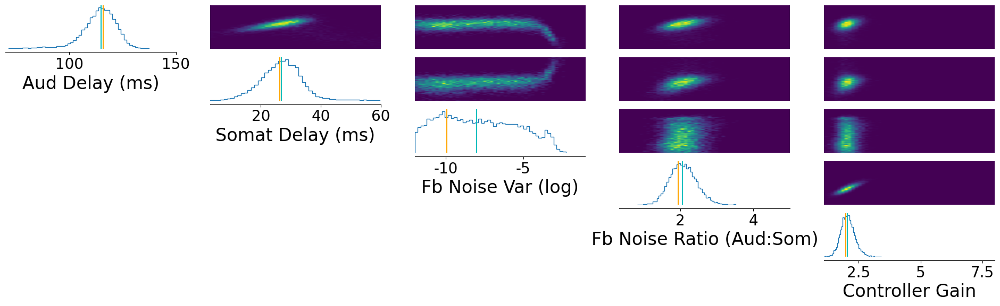

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.020216635862986245 min


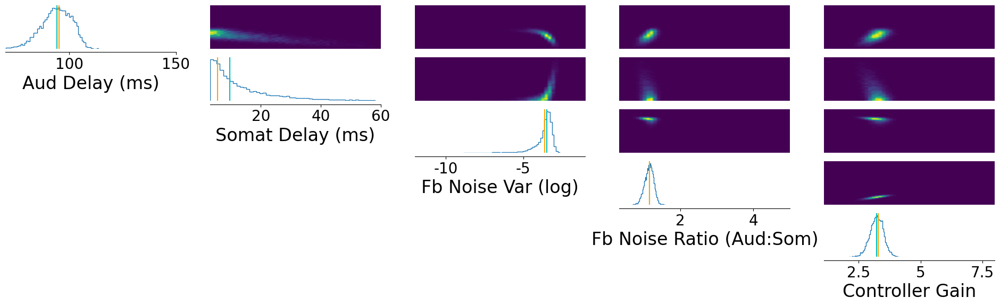

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01391662359237671 min


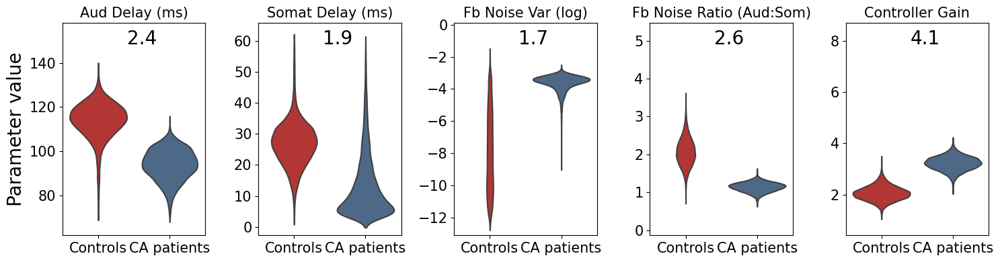

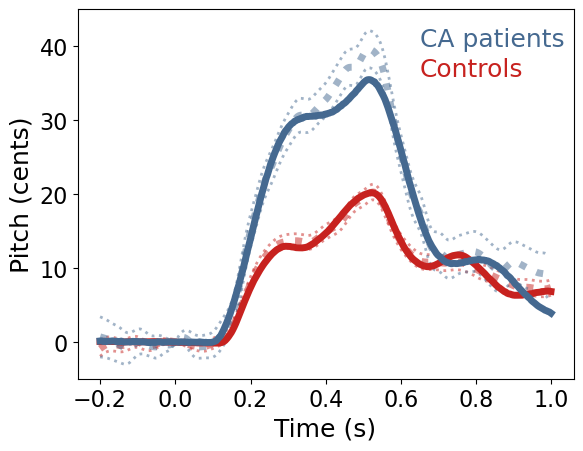

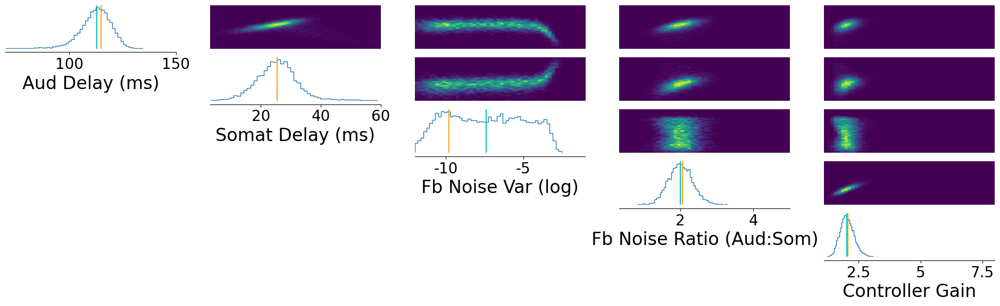

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013333276907602946 min


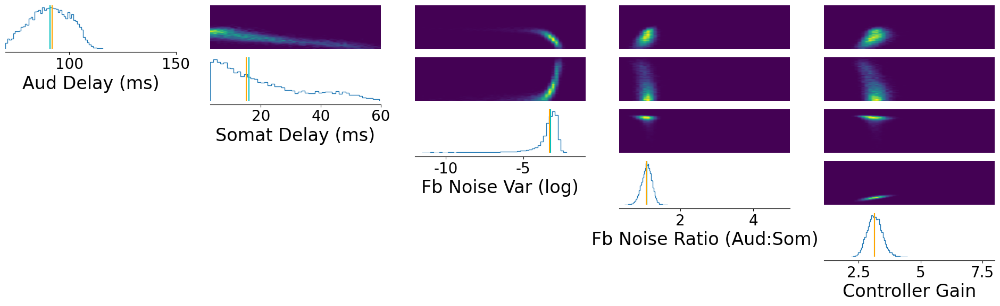

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012666630744934081 min


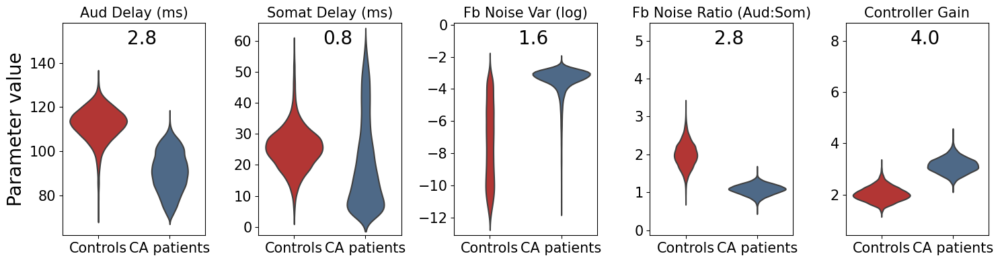

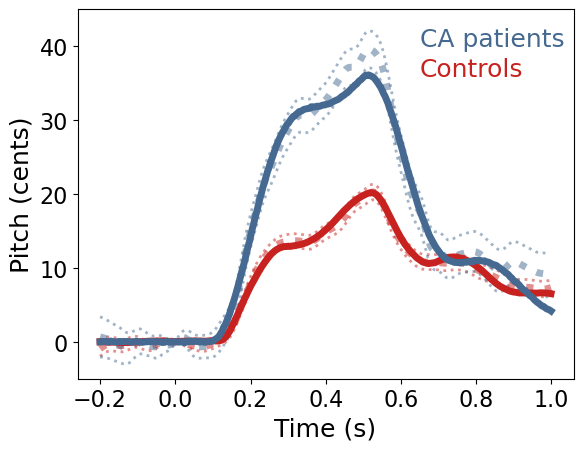

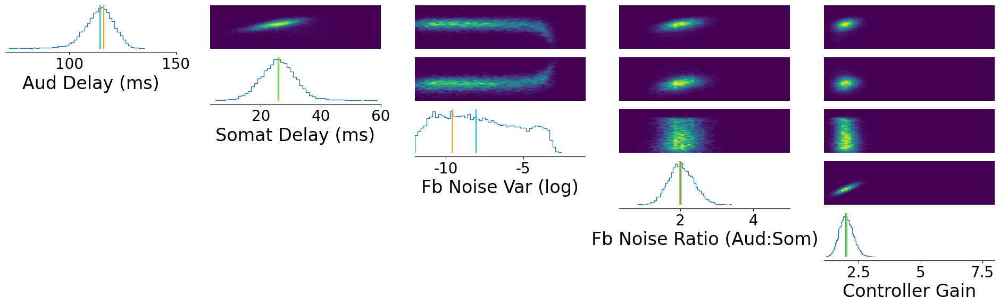

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012850018342336018 min


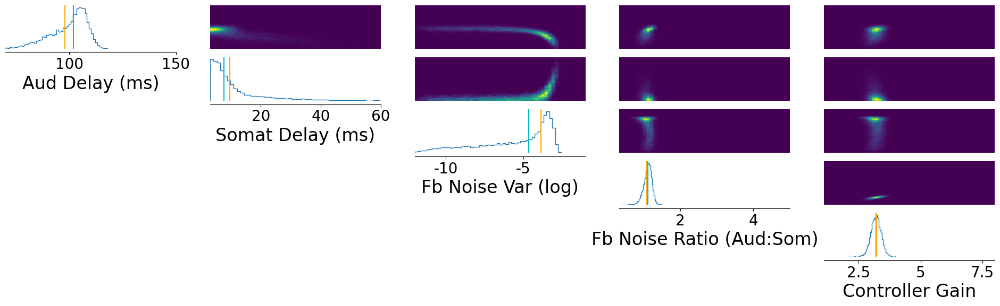

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012666507562001546 min


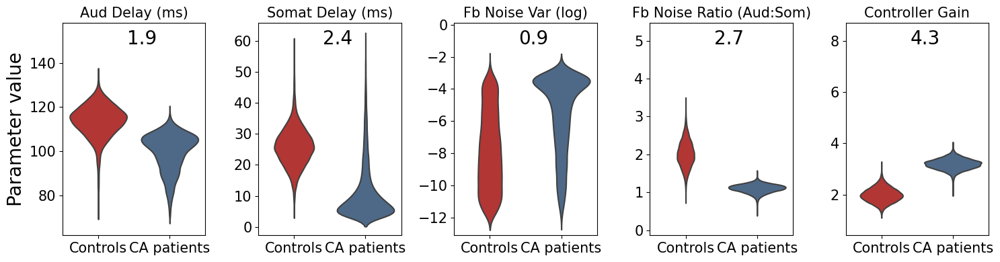

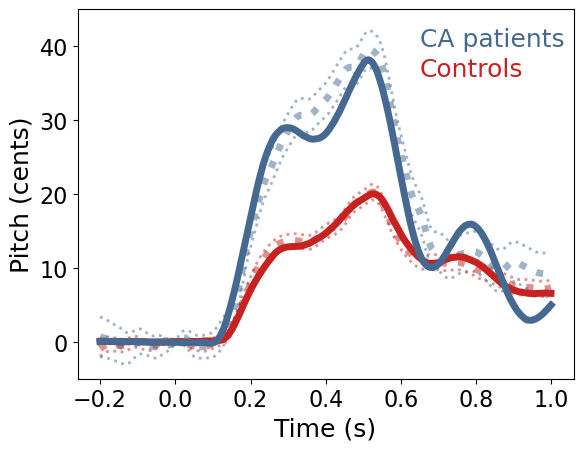

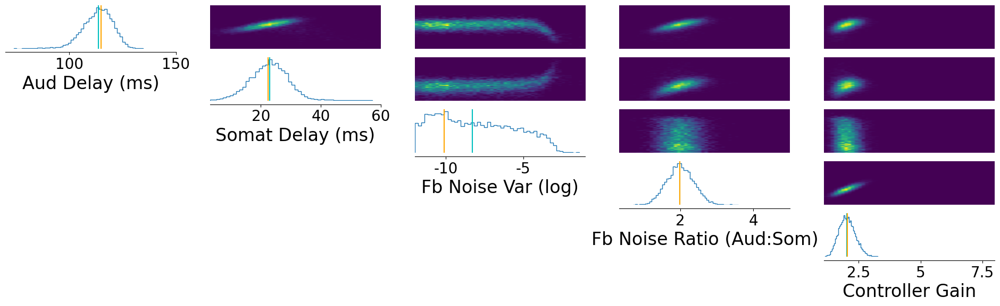

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01386664311091105 min


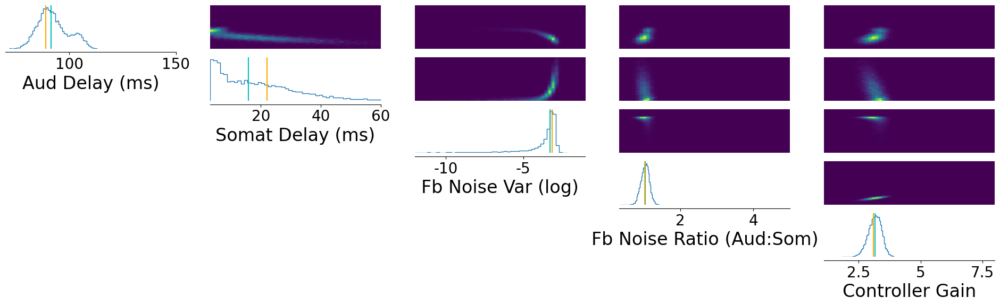

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013116617997487387 min


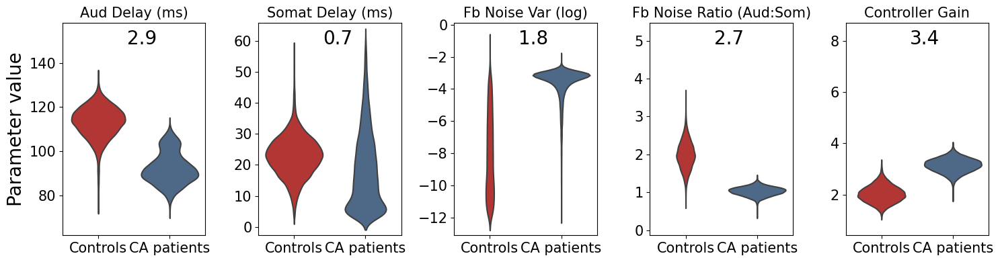

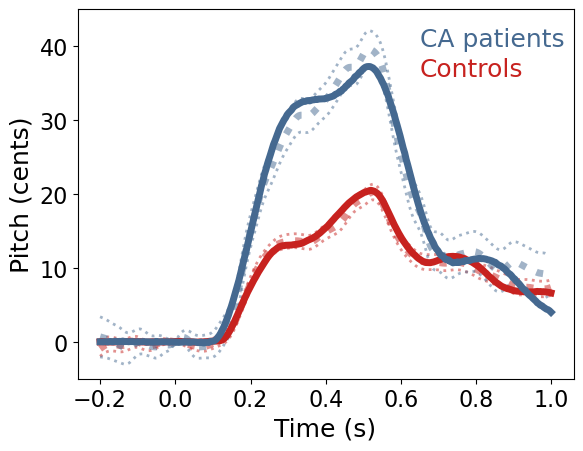

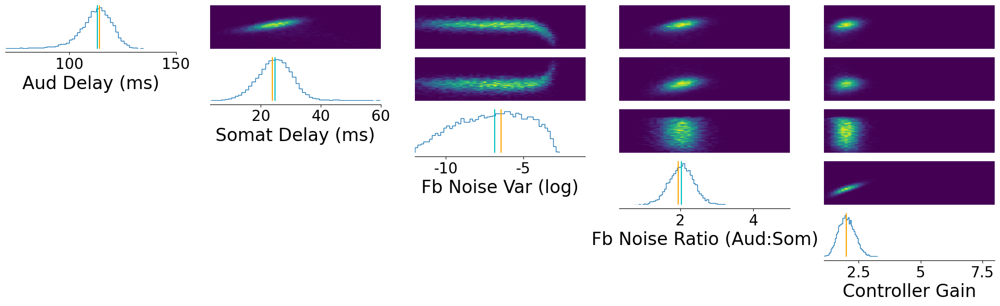

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.02583331267038981 min


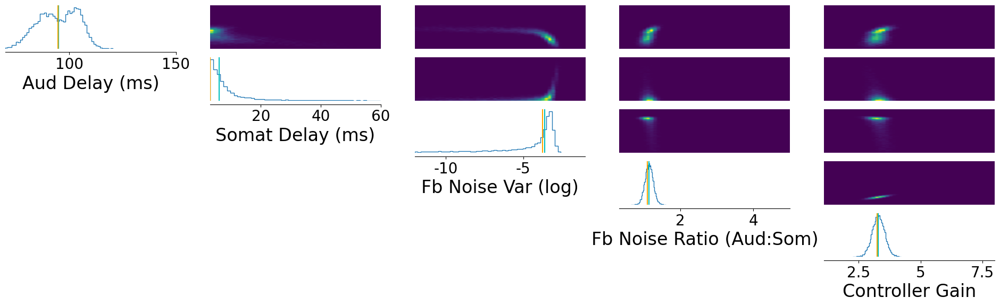

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012566641966501872 min


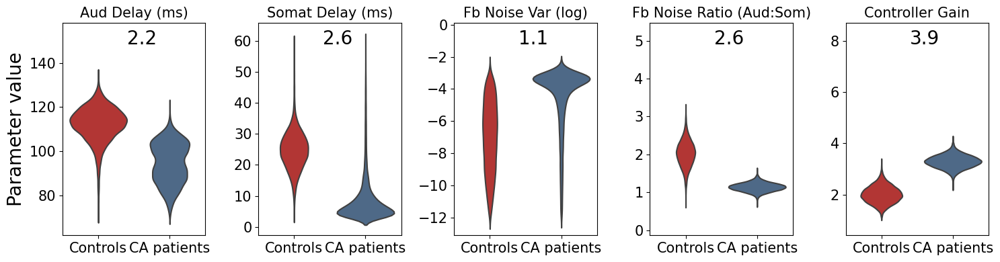

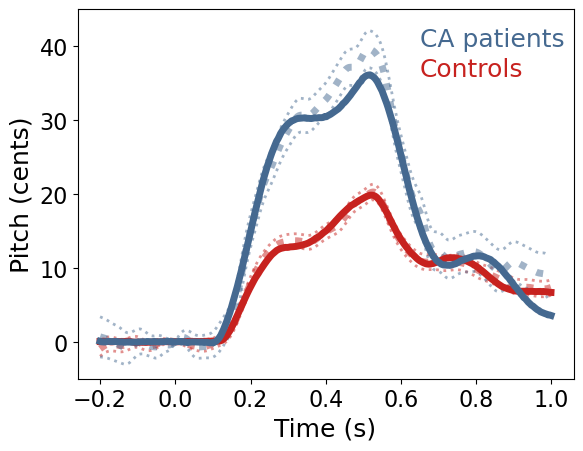

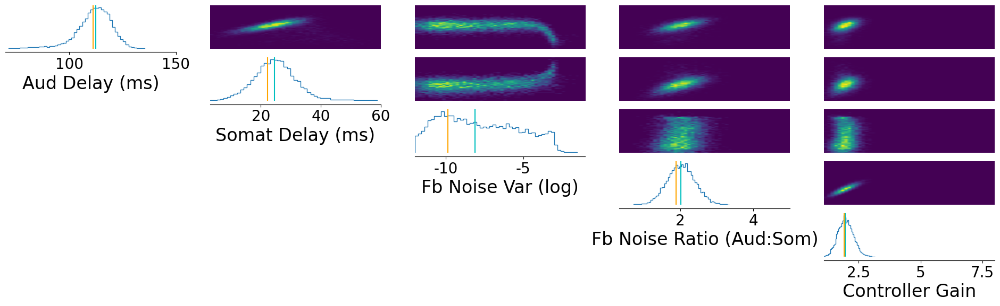

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013266646862030029 min


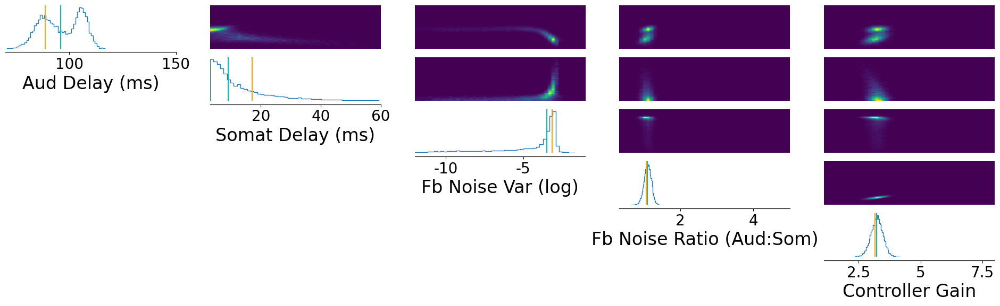

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01293331782023112 min


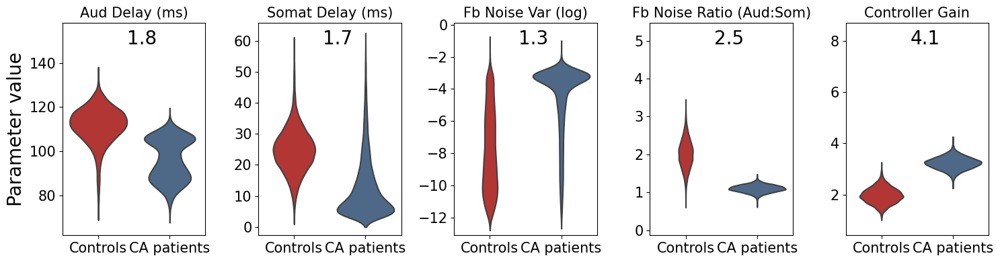

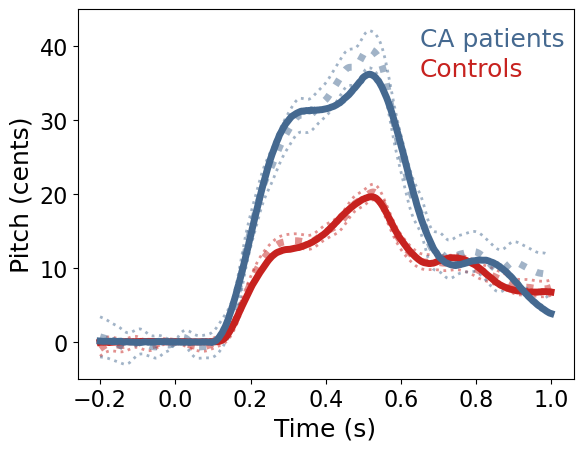

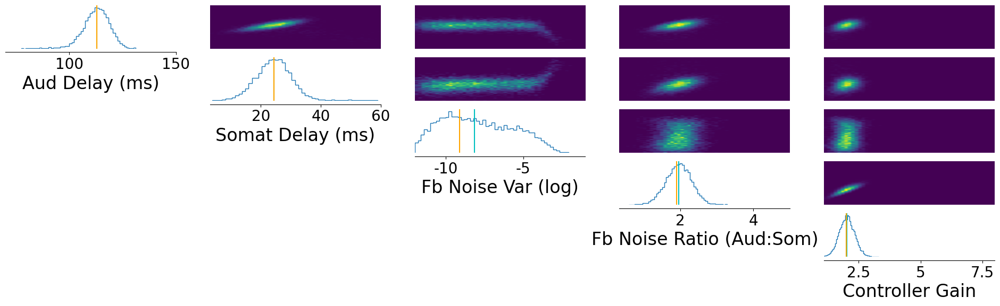

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.020783273379007976 min


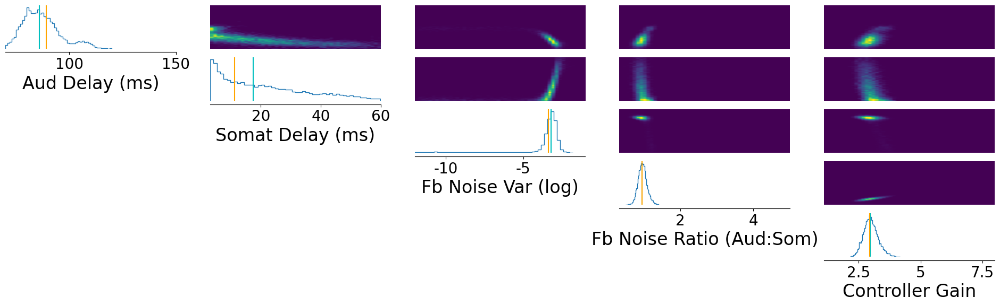

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013116498788197836 min


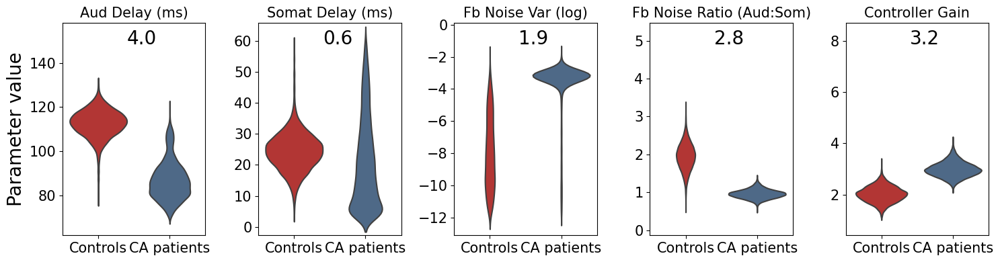

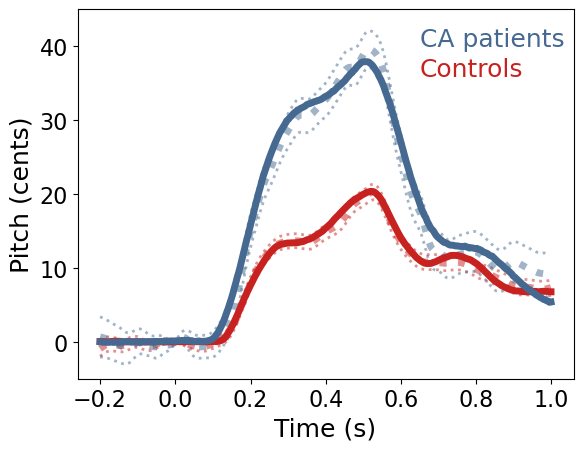

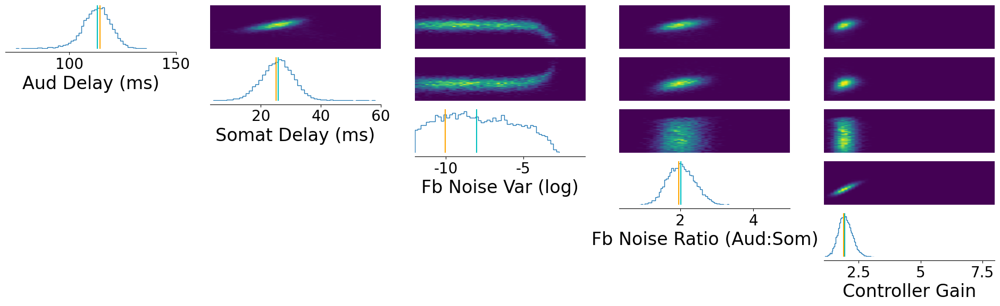

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.0204333225886027 min


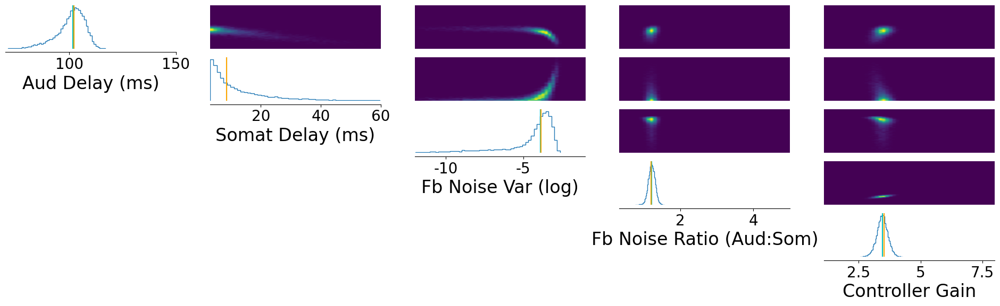

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013150012493133545 min


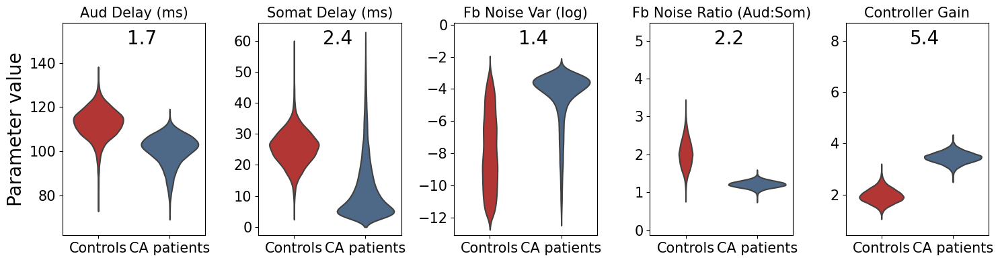

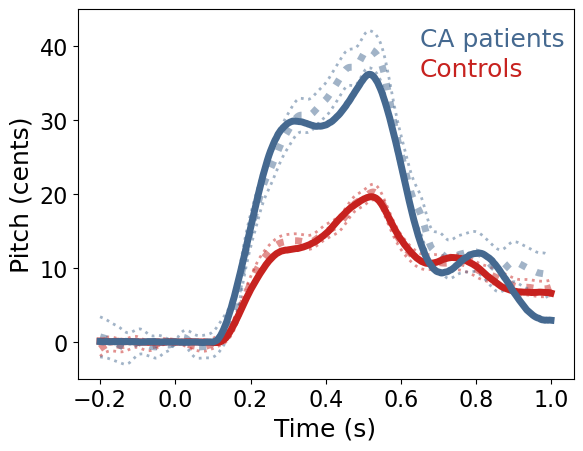

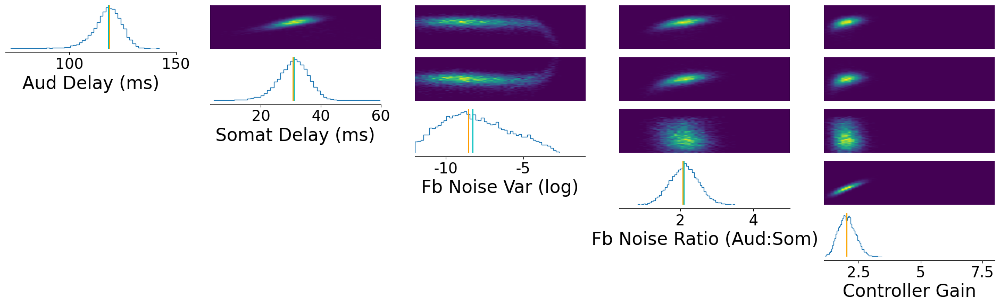

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01288214921951294 min


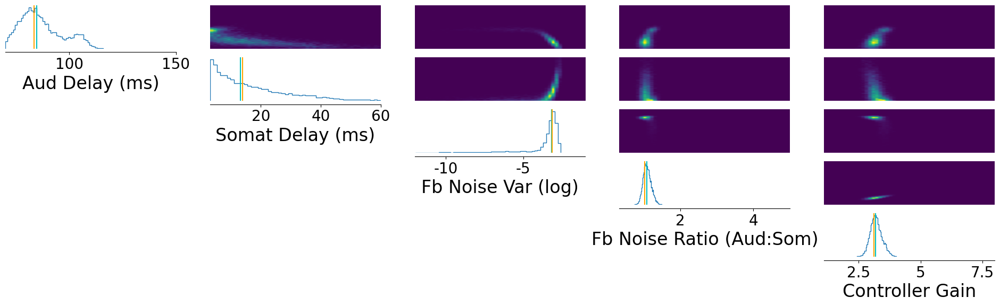

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013249997297922771 min


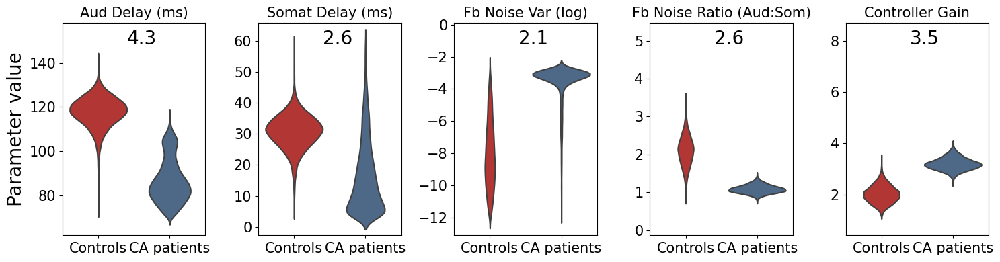

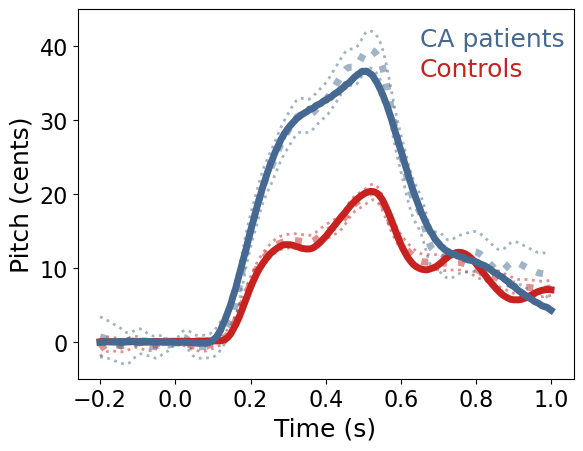

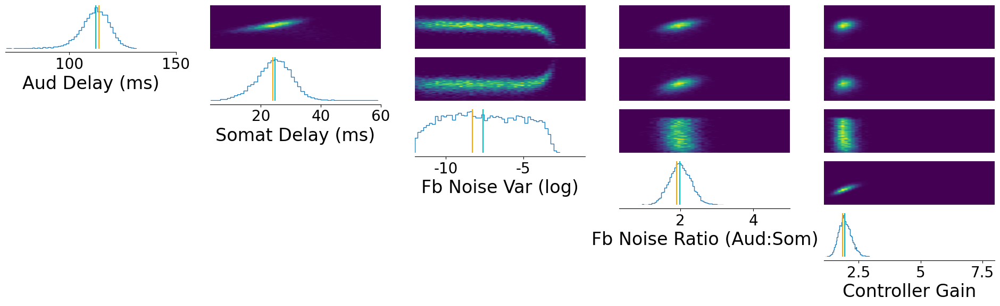

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01358332633972168 min


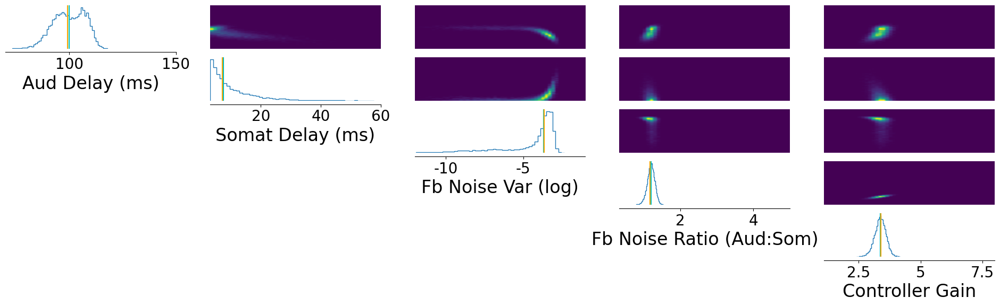

BOOTSTRAP TIME: 0.0003833373387654622 min
PLOT SIM TIME: 0.1555906136830648 min
VIOLIN PLOT TIME: 19.413570896784464 min


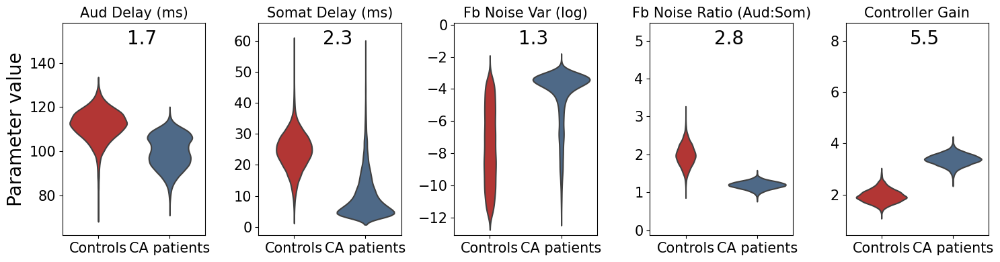

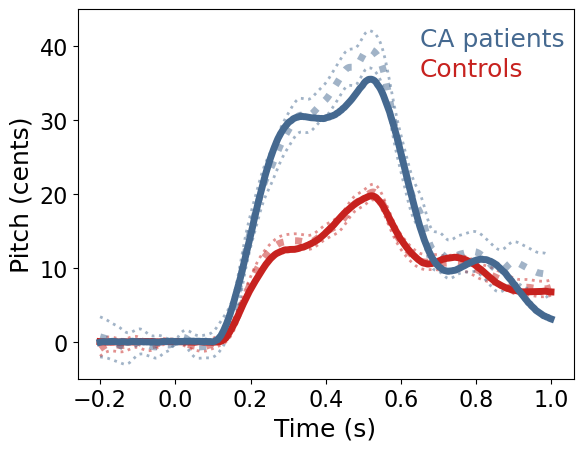

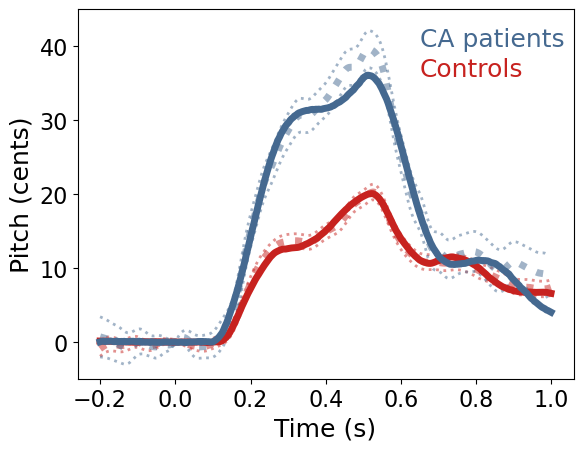

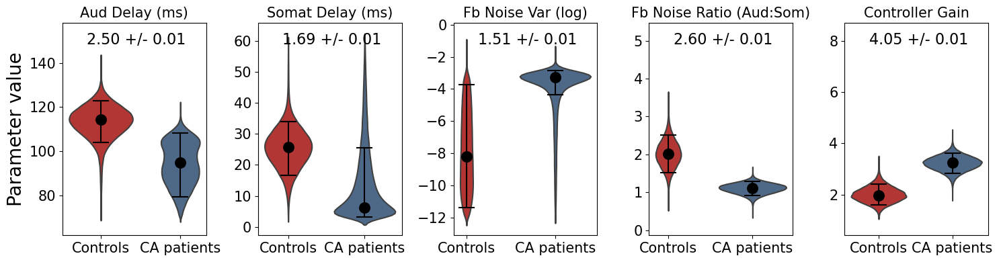

In [8]:
def simulator(parameter_set):
    training_noise_scale = 5
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

inferred_values, rmse_means_all[2,:], rmse_sterr_all[2,:] = run_sbi('training_noise_5',observation_list,n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012333333492279053 min


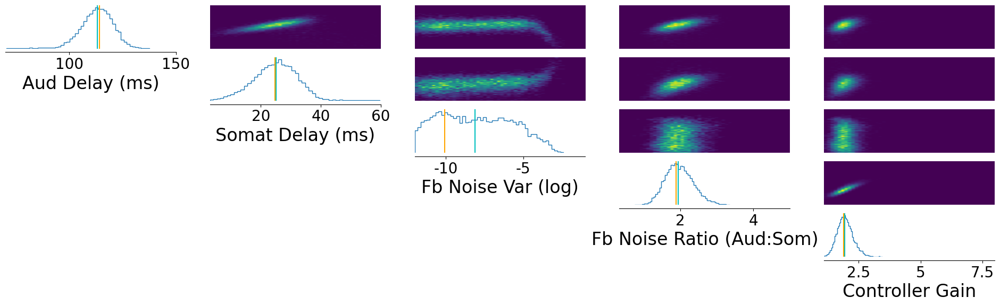

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012701785564422608 min


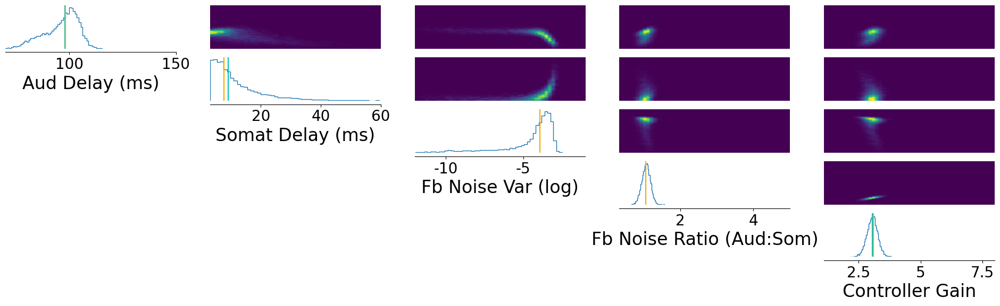

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012065474192301433 min


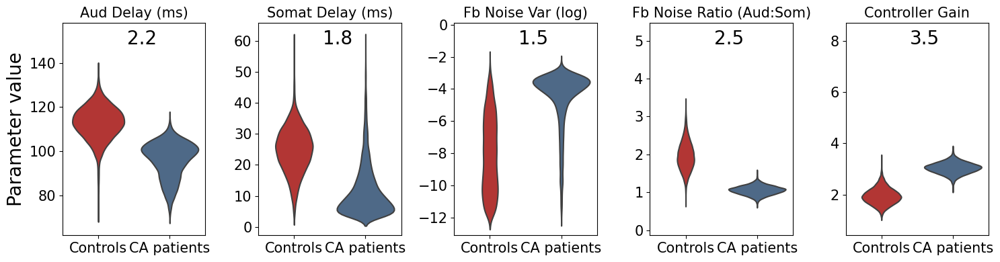

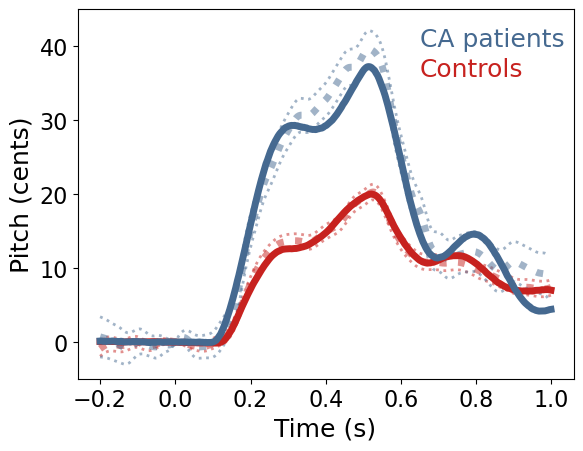

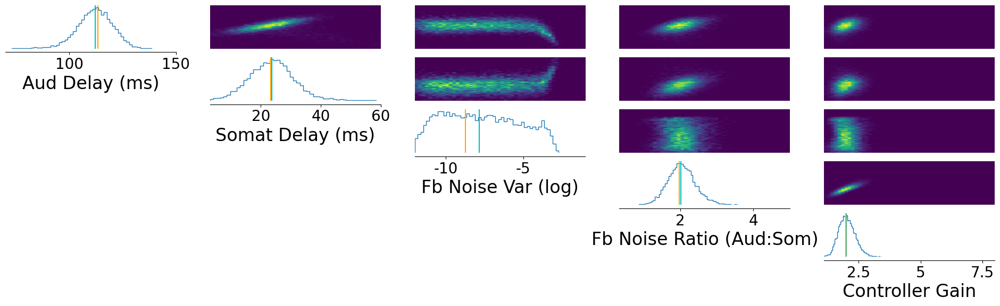

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013016645113627117 min


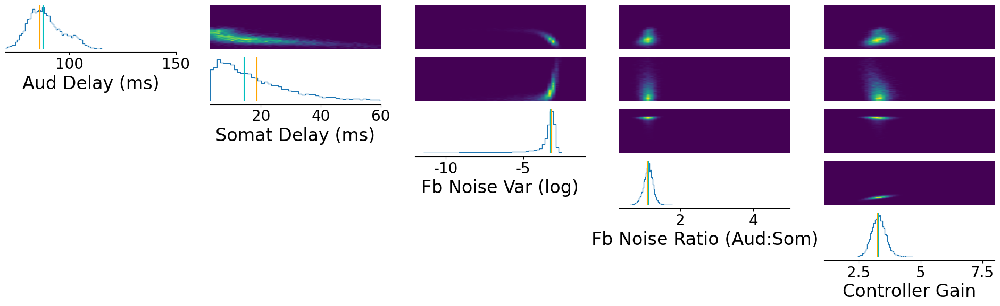

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013150004545847575 min


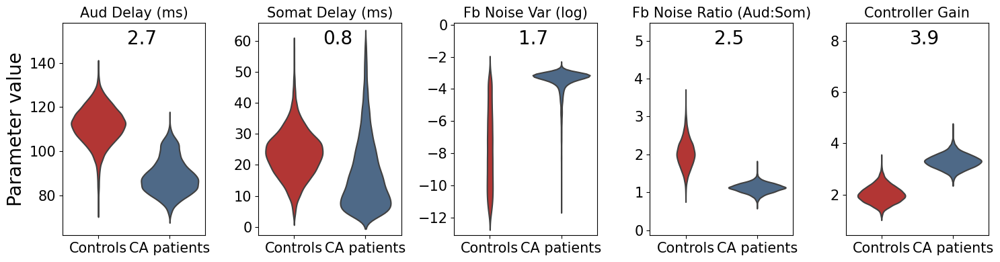

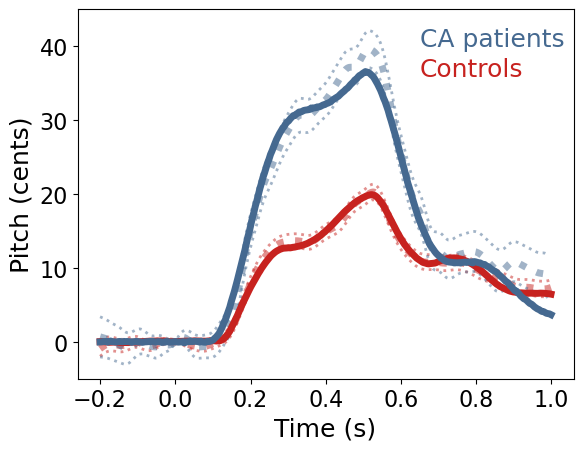

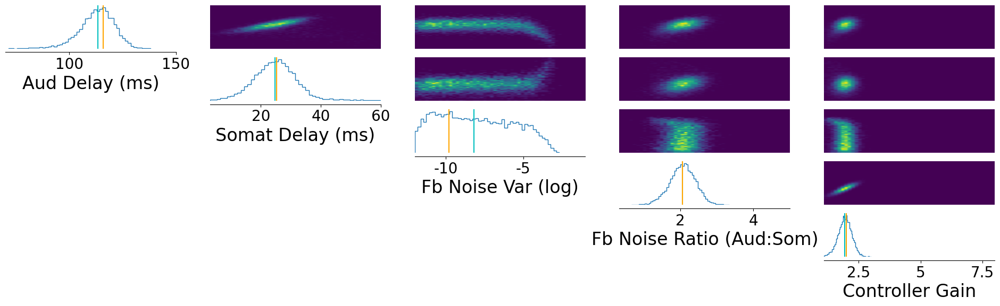

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011099958419799804 min


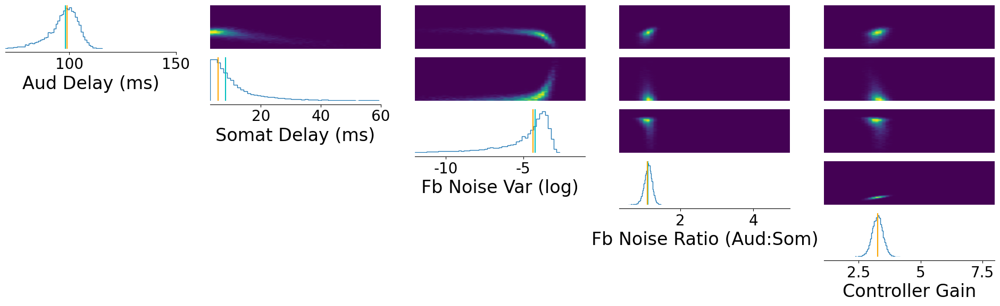

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011599957942962646 min


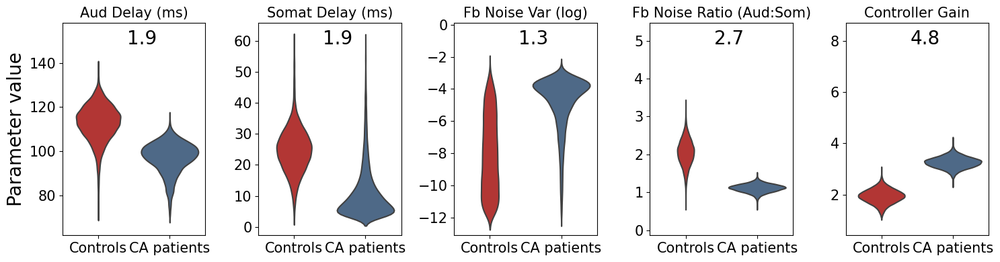

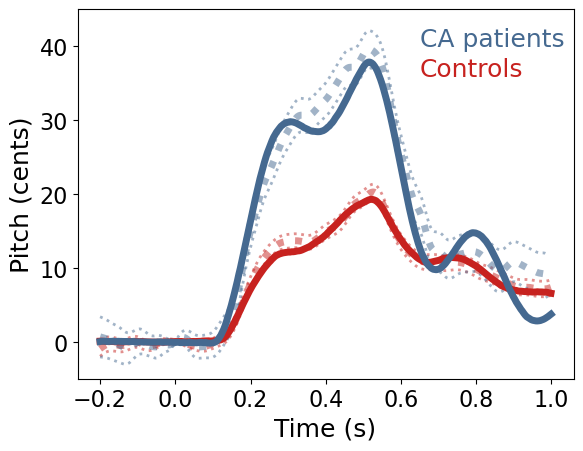

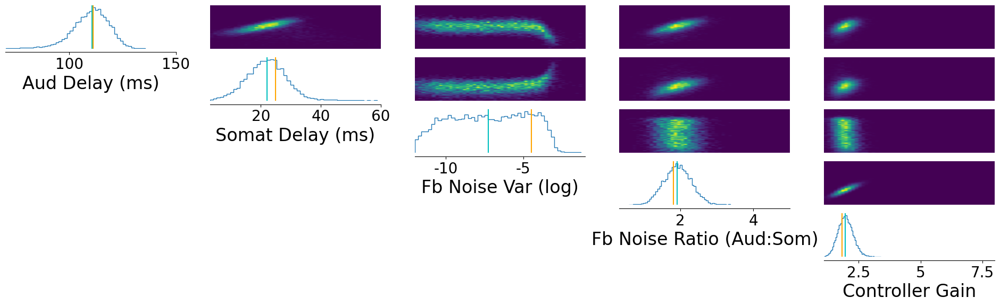

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012199163436889648 min


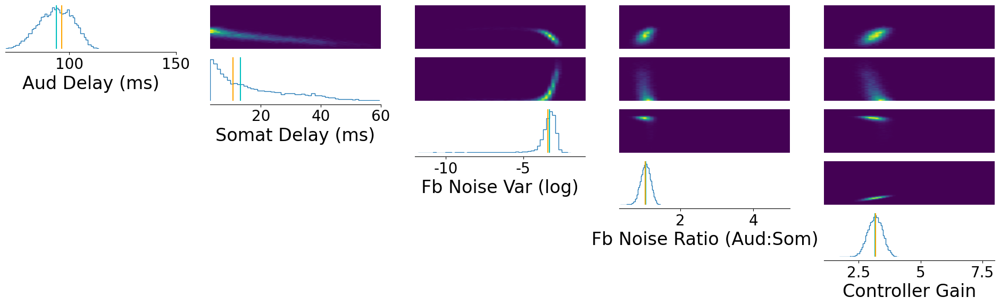

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013765498002370199 min


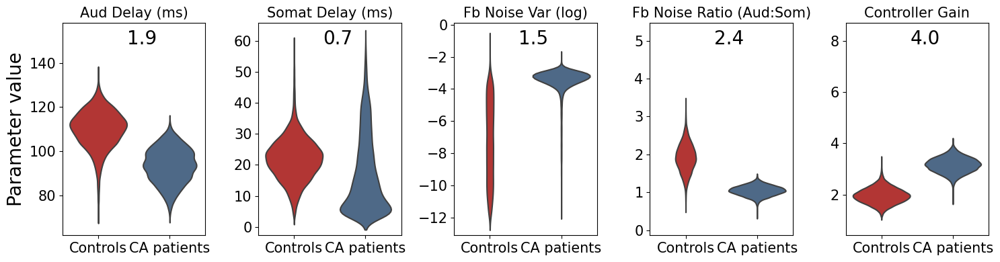

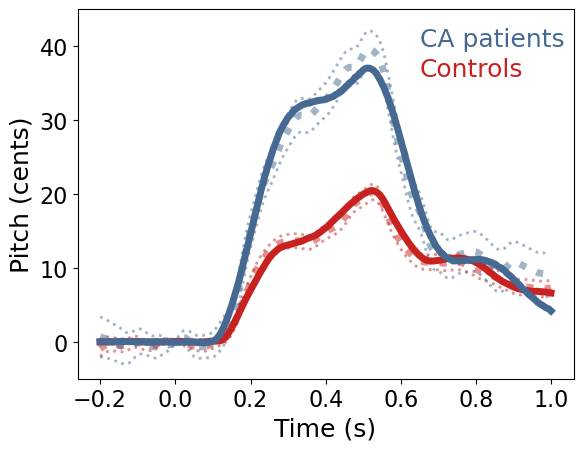

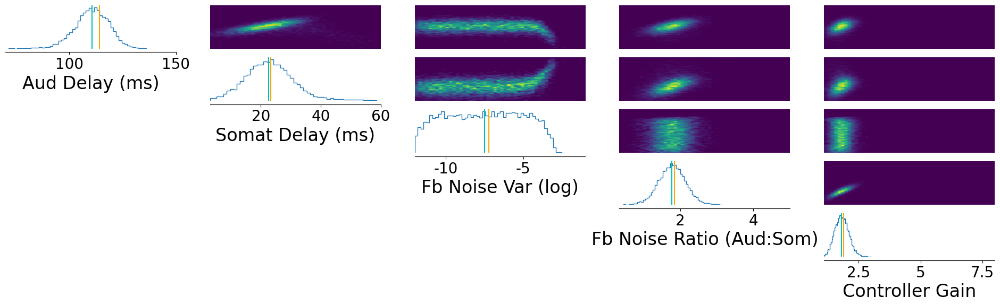

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01994999647140503 min


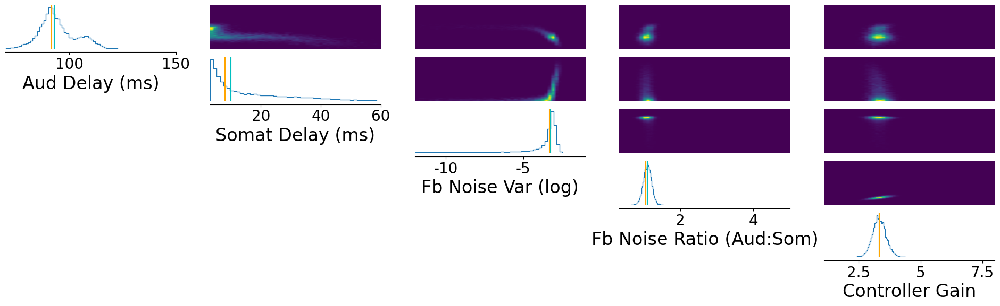

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01304999589920044 min


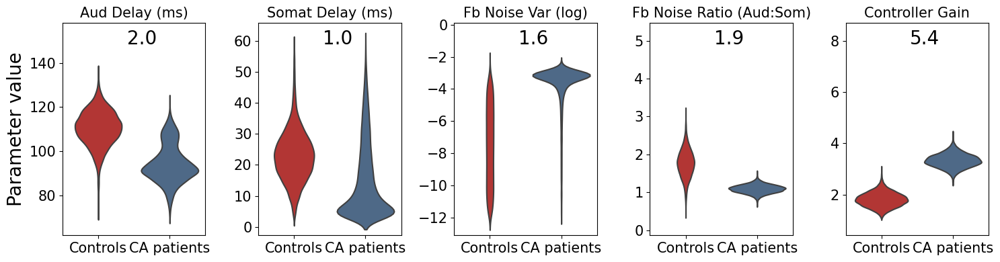

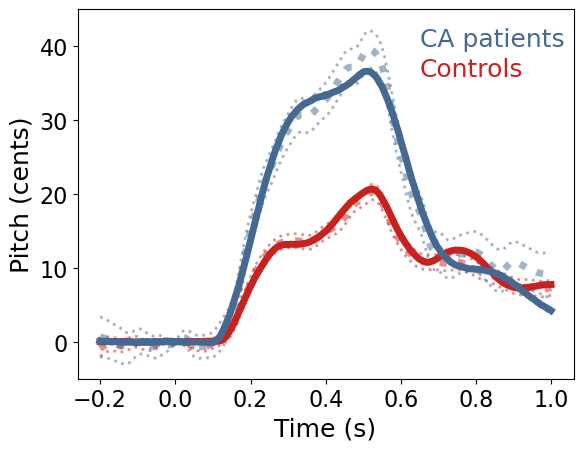

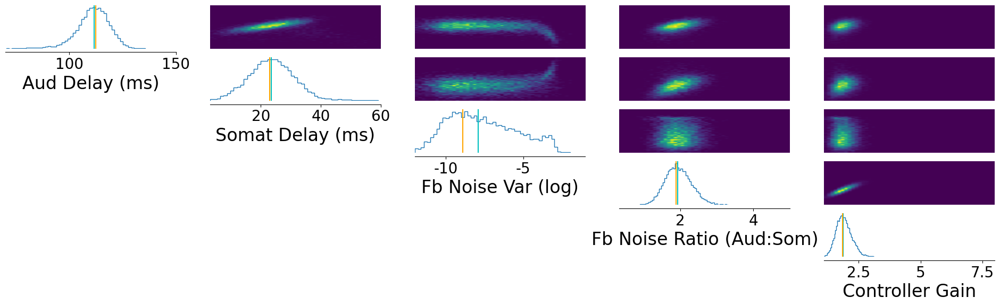

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012583331267038981 min


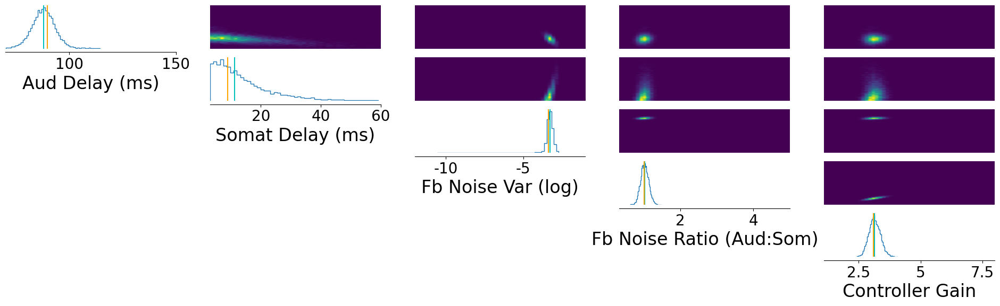

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012715498606363932 min


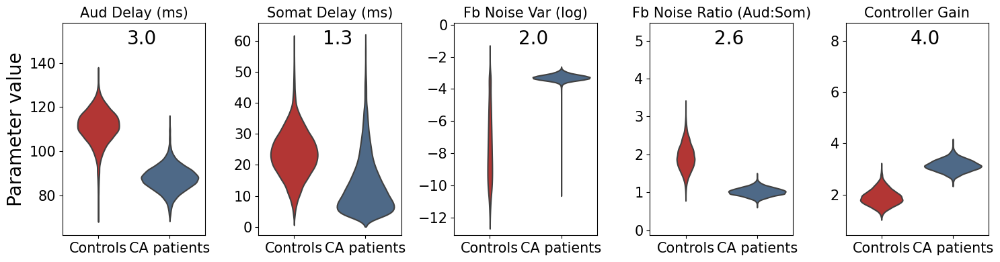

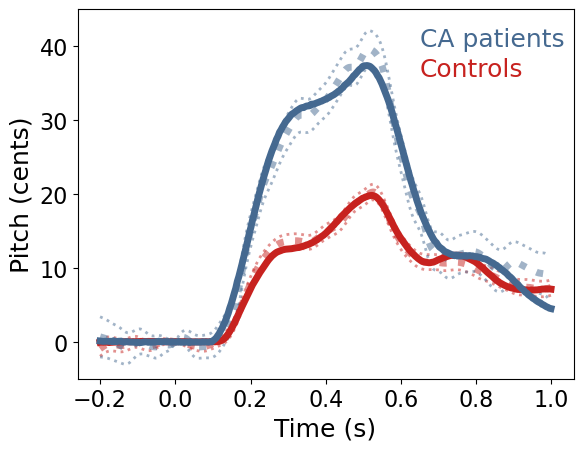

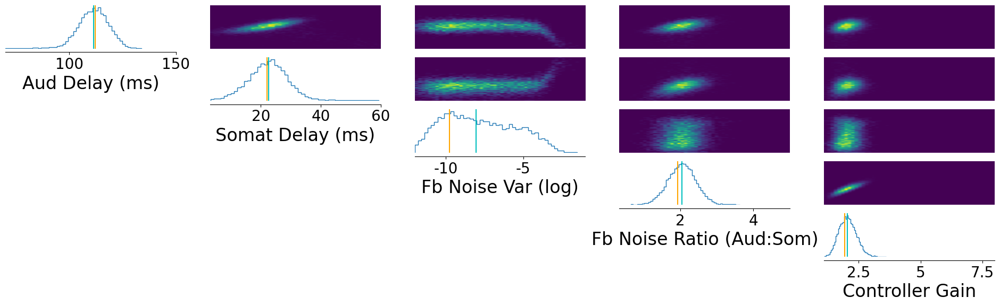

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013400010267893473 min


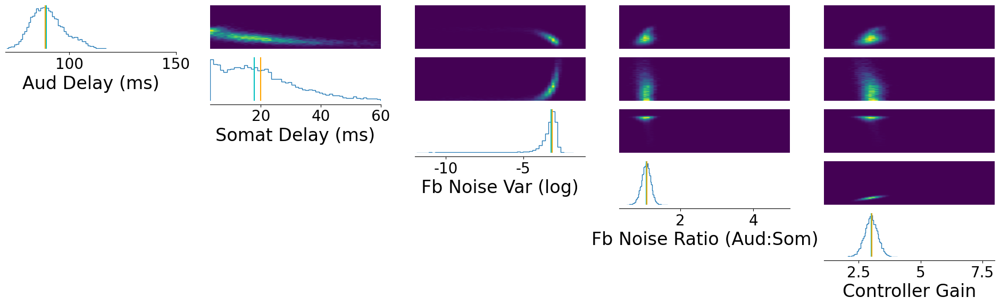

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012749989827473959 min


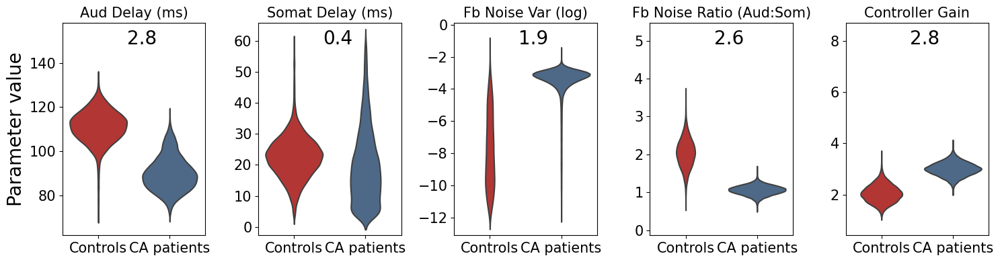

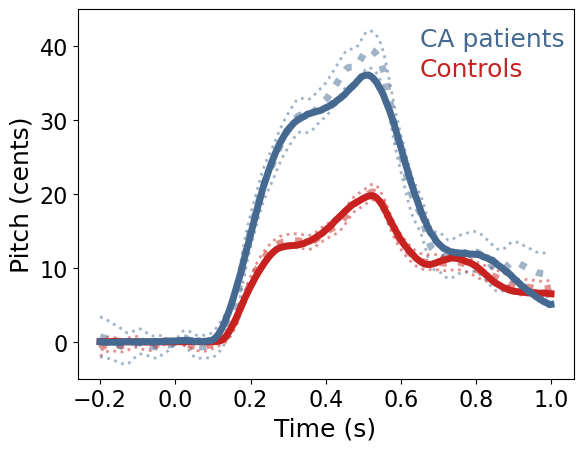

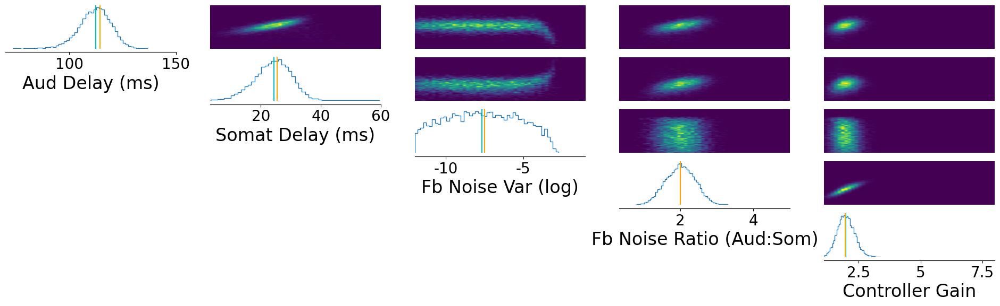

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013066657384236654 min


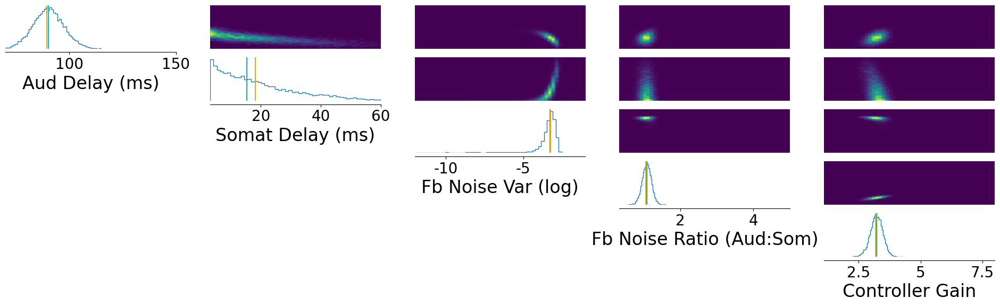

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012833336989084879 min


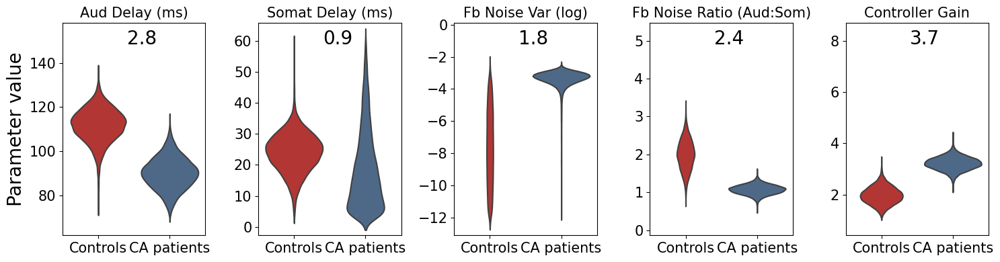

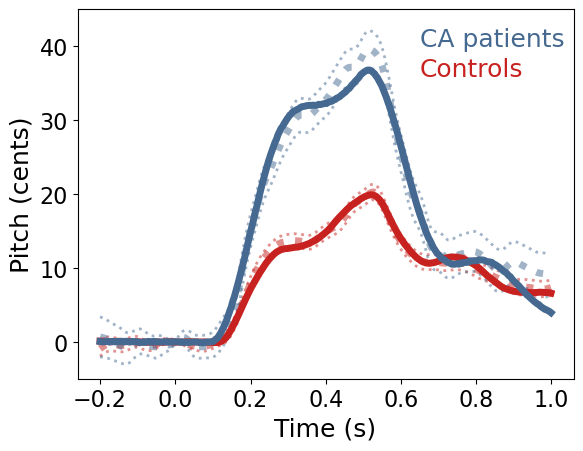

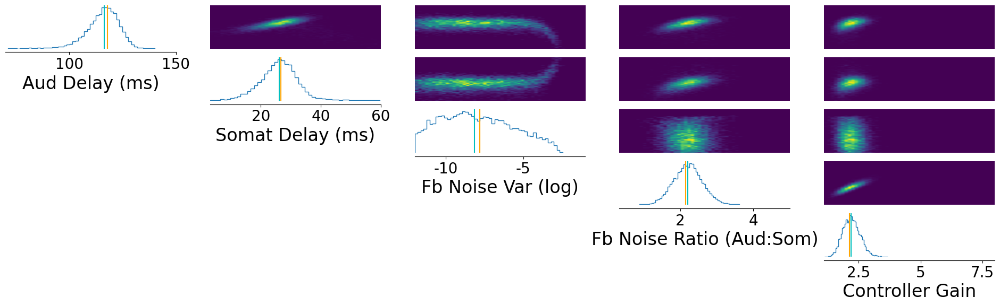

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013215458393096924 min


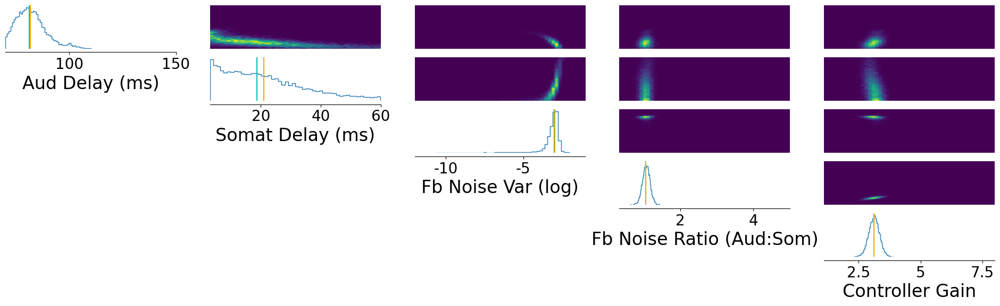

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013399958610534668 min


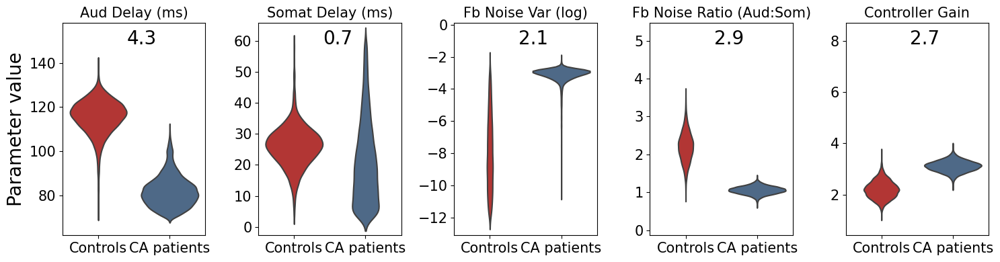

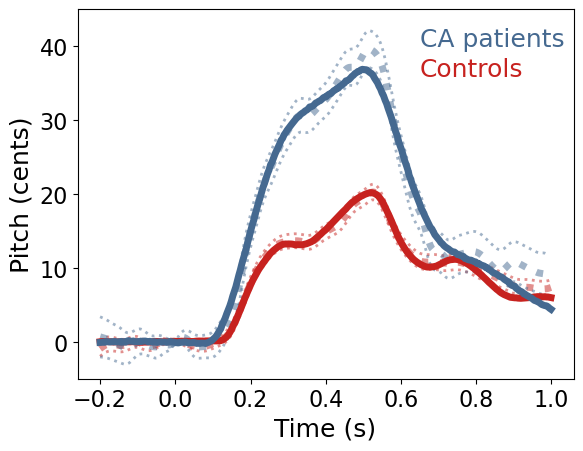

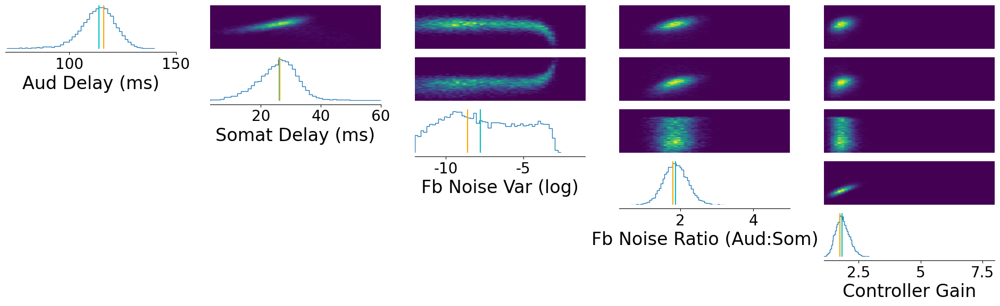

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012416692574818929 min


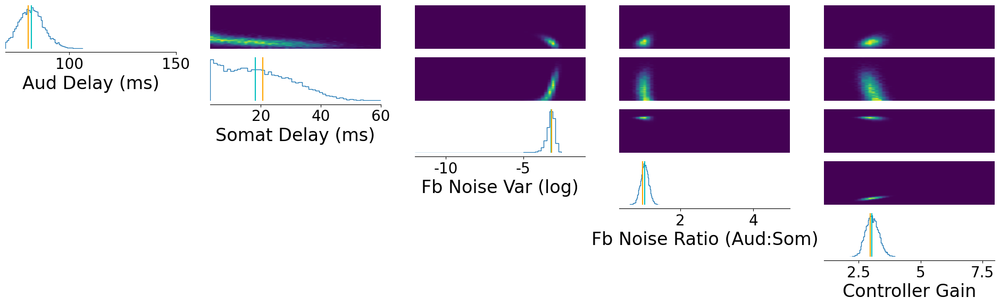

BOOTSTRAP TIME: 0.00043316284815470376 min
PLOT SIM TIME: 0.1491986592610677 min
VIOLIN PLOT TIME: 19.632461043198905 min


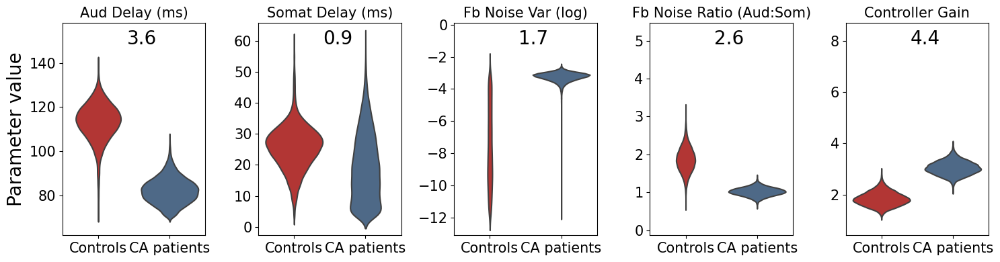

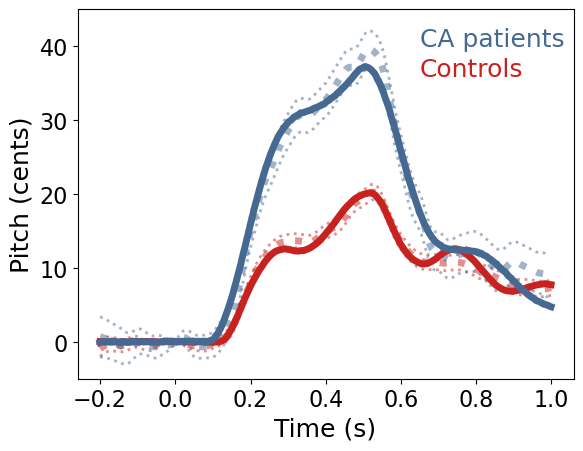

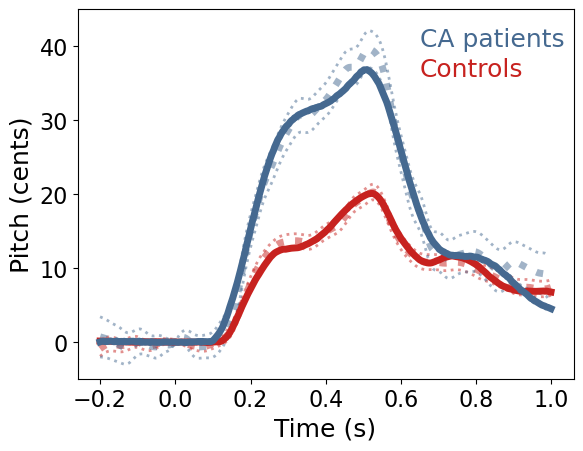

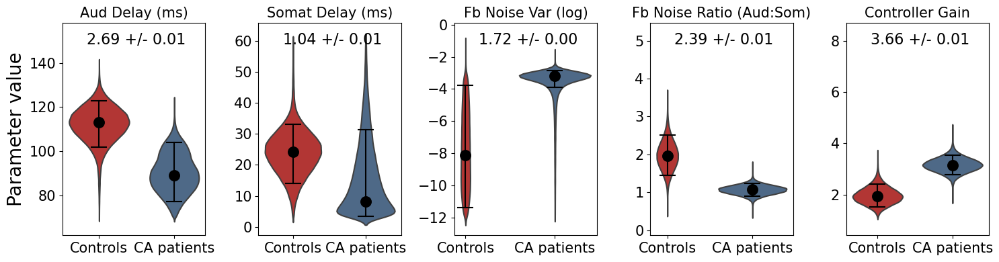

In [9]:
def simulator(parameter_set):
    training_noise_scale = 7
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

inferred_values, rmse_means_all[3,:], rmse_sterr_all[3,:] = run_sbi('training_noise_7',observation_list,n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01226663589477539 min


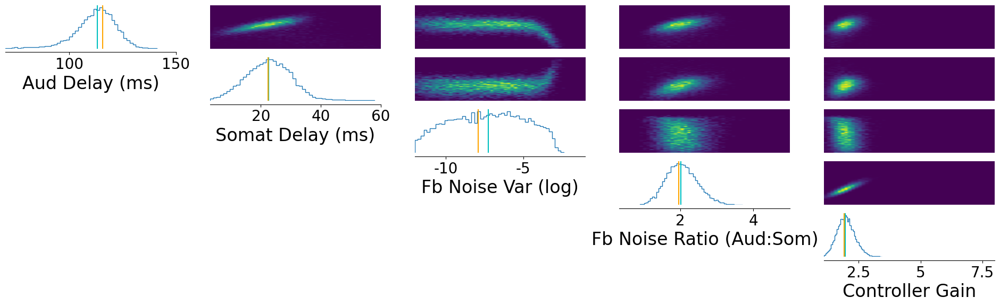

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012815507253011067 min


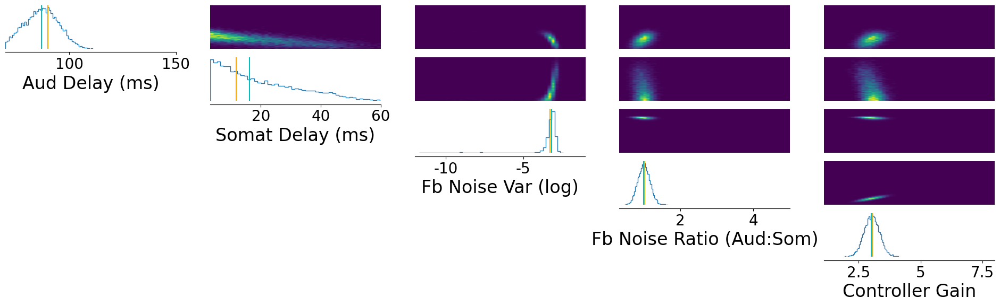

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012666638692220051 min


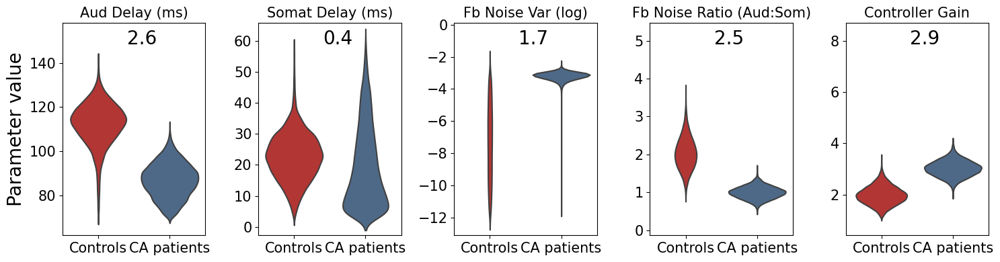

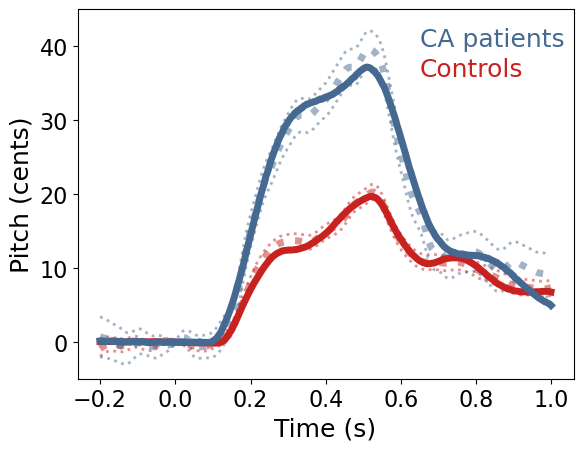

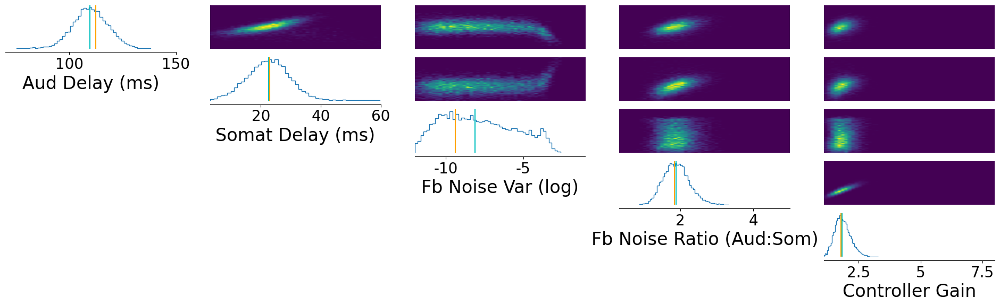

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012483346462249755 min


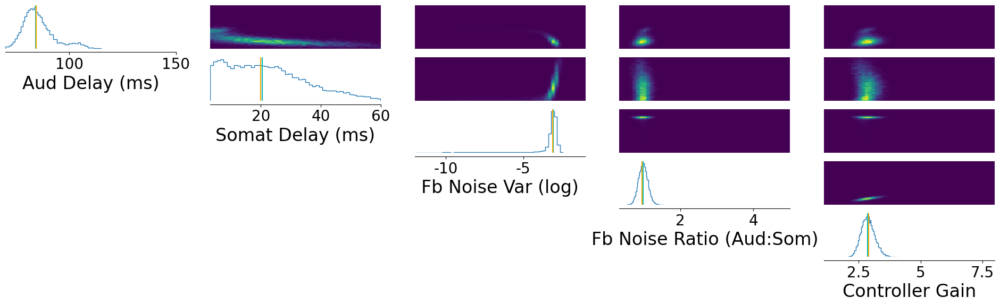

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012649953365325928 min


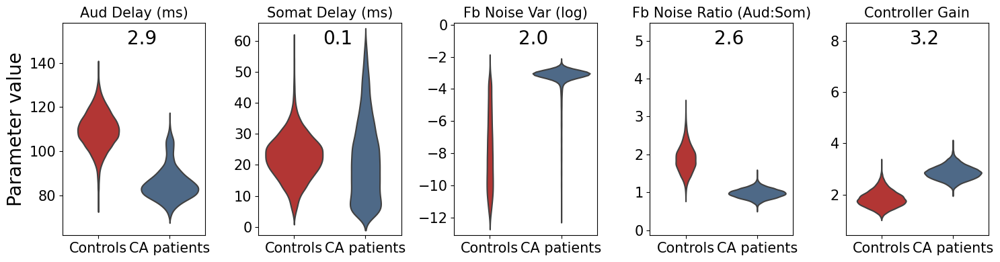

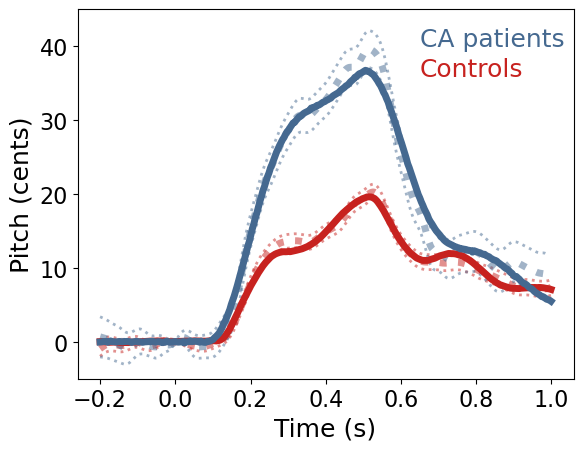

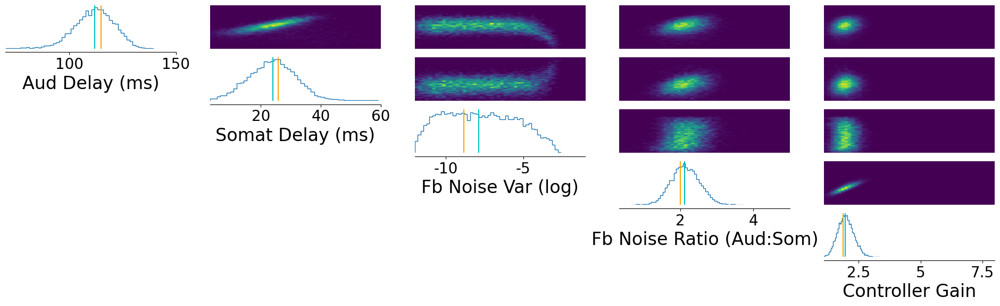

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01306666930516561 min


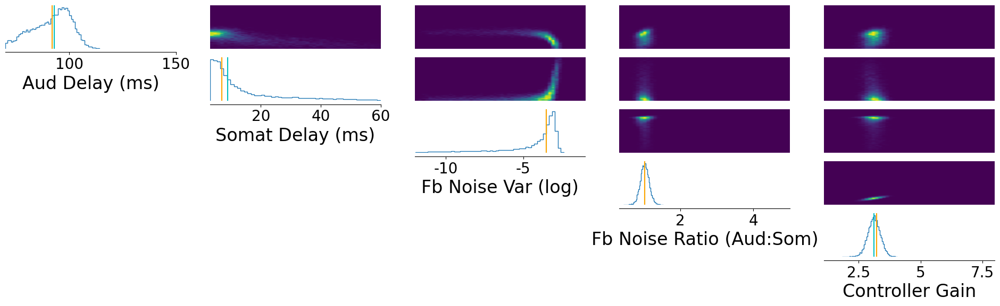

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012666682402292887 min


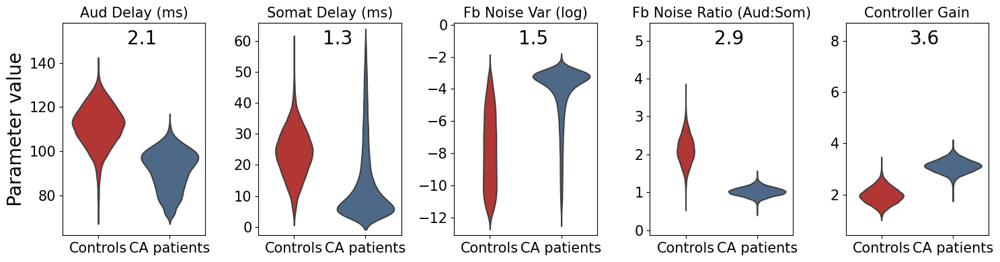

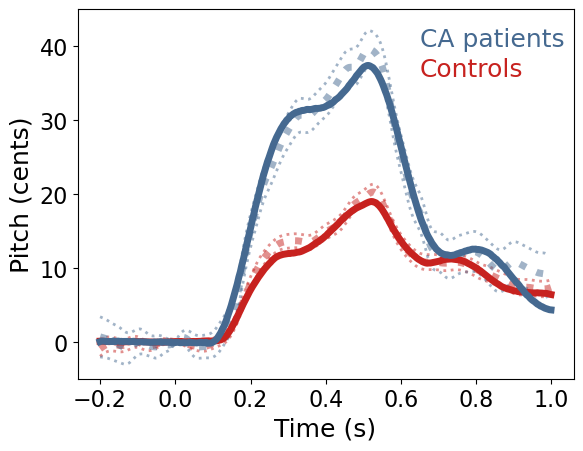

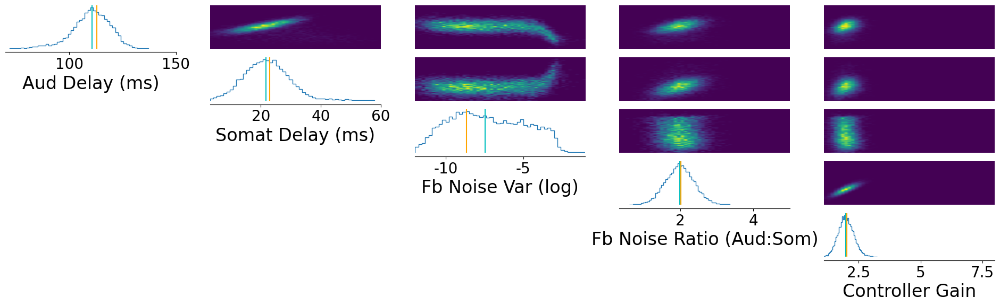

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01273333231608073 min


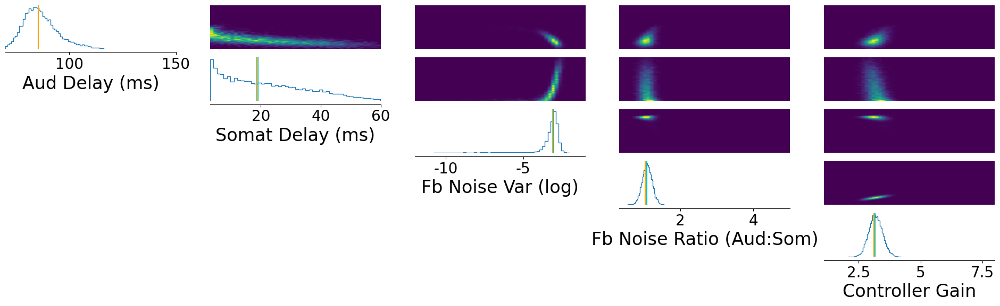

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011449988683064778 min


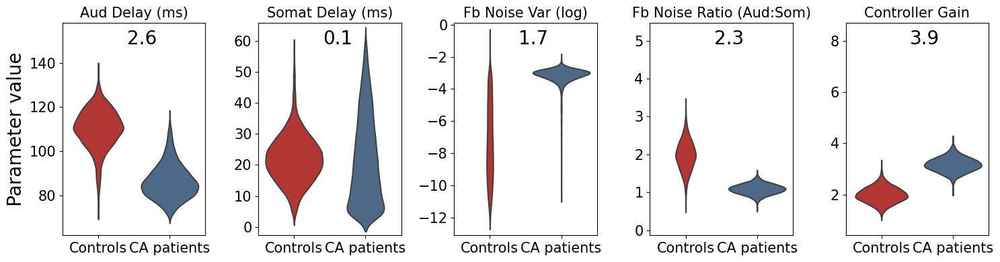

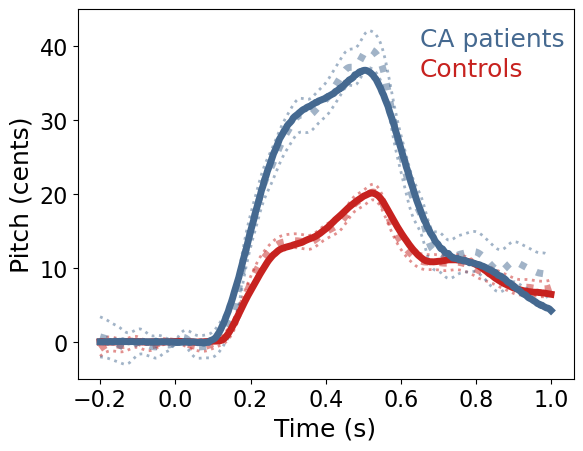

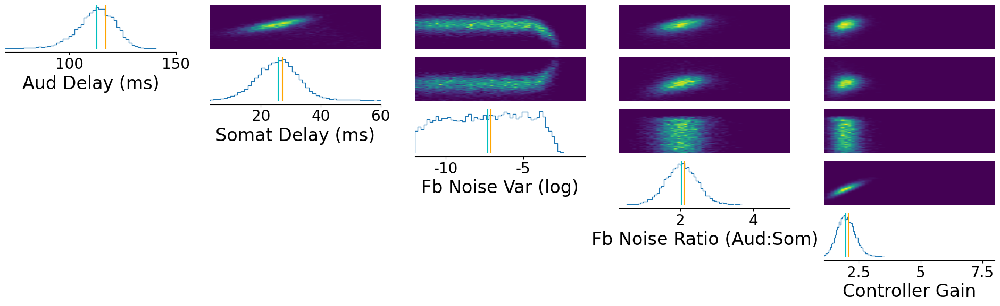

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012999995549519857 min


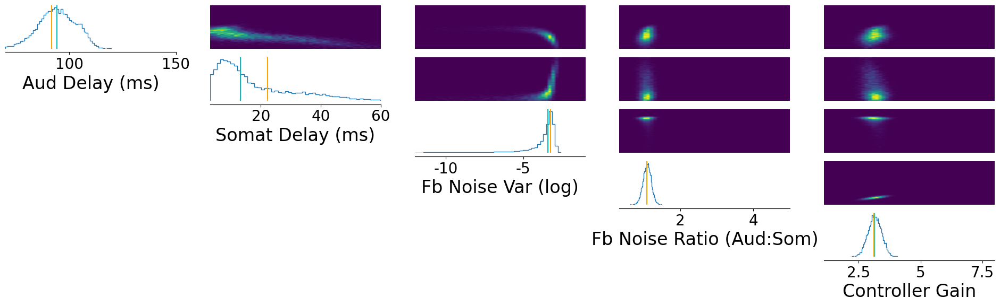

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013249778747558593 min


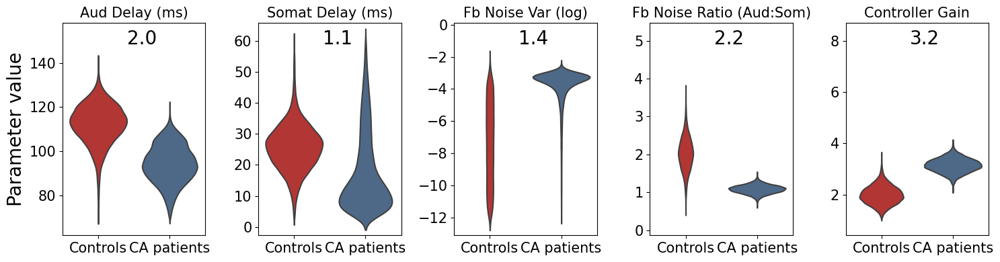

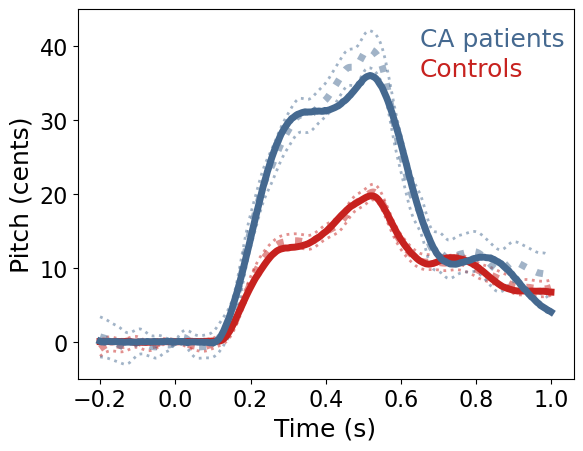

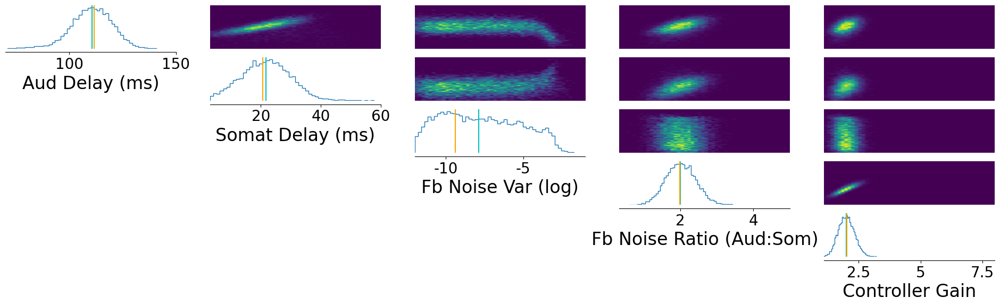

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013233160972595215 min


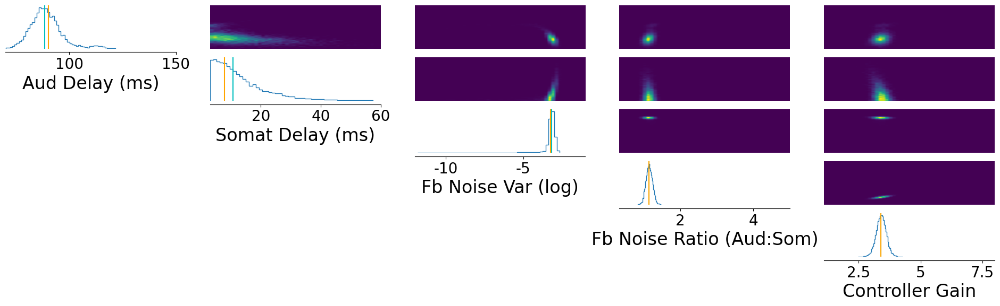

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012966620922088622 min


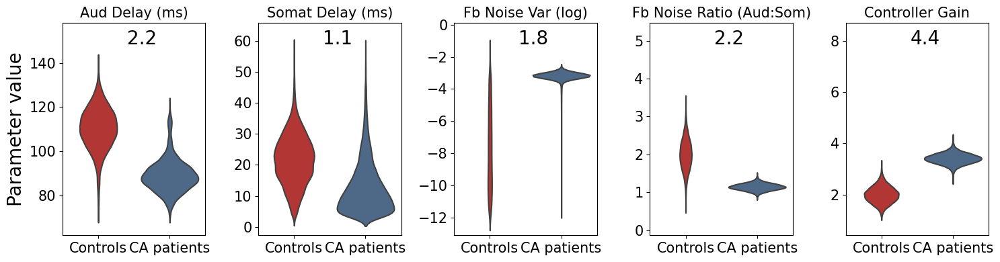

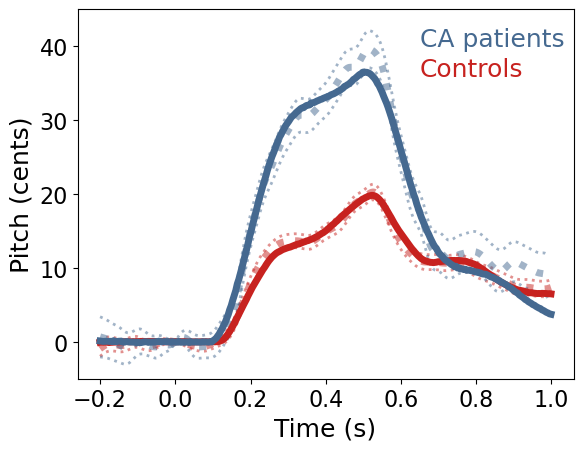

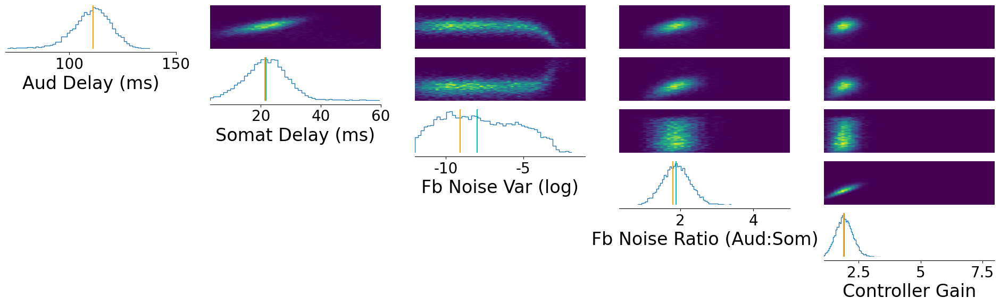

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.020566662152608235 min


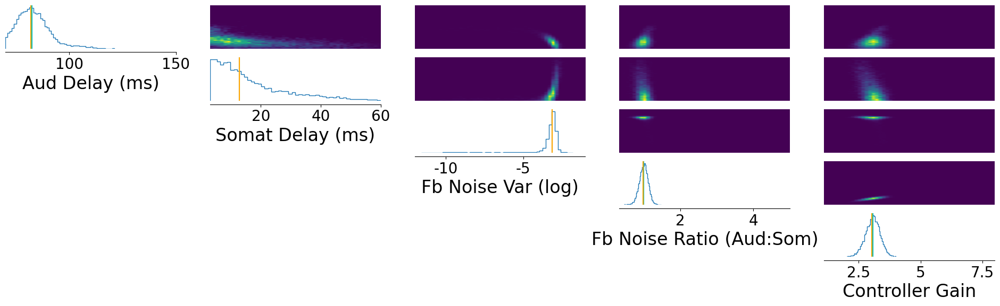

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013933328787485759 min


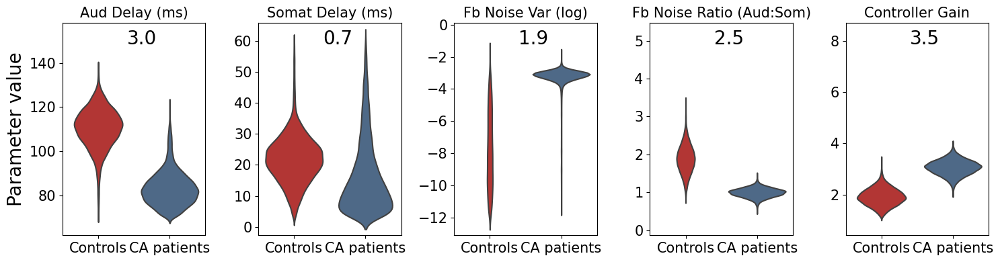

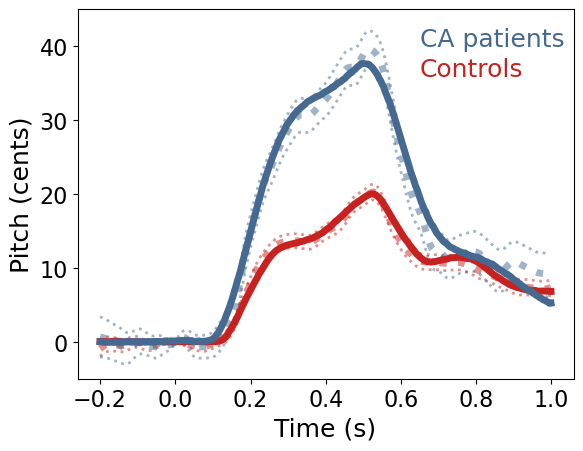

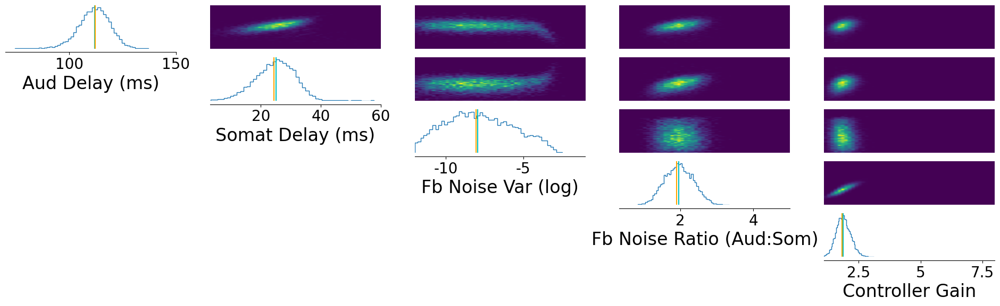

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013533294200897217 min


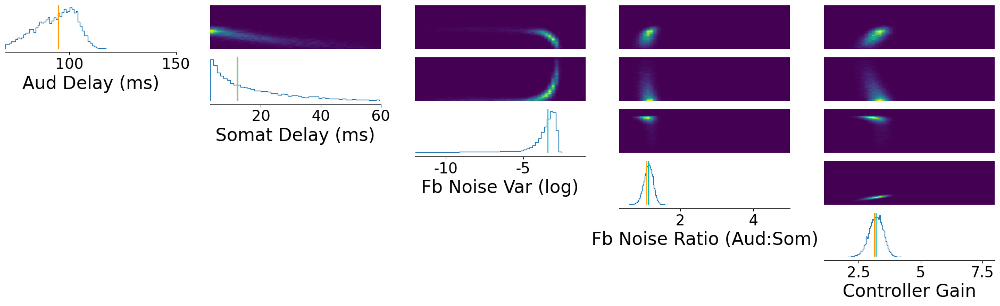

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01356665293375651 min


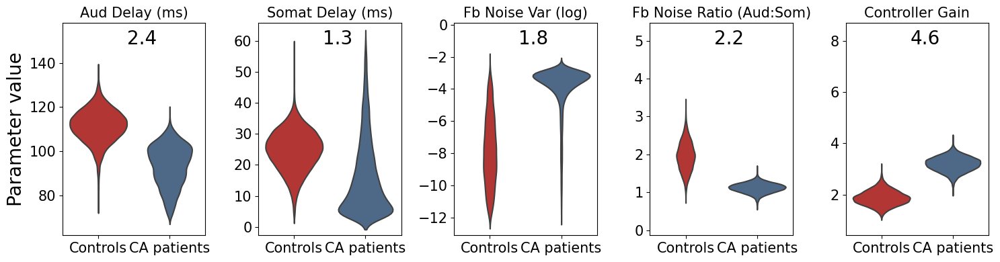

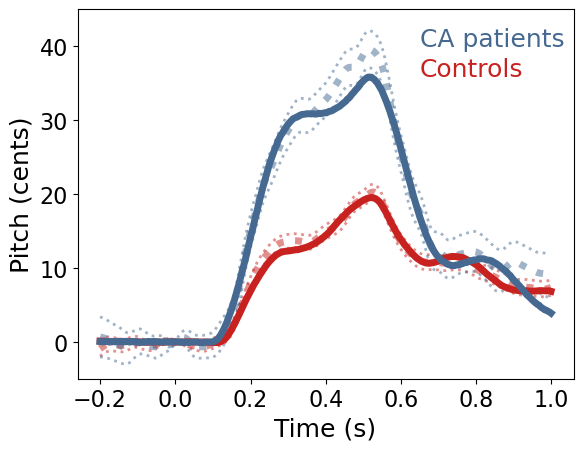

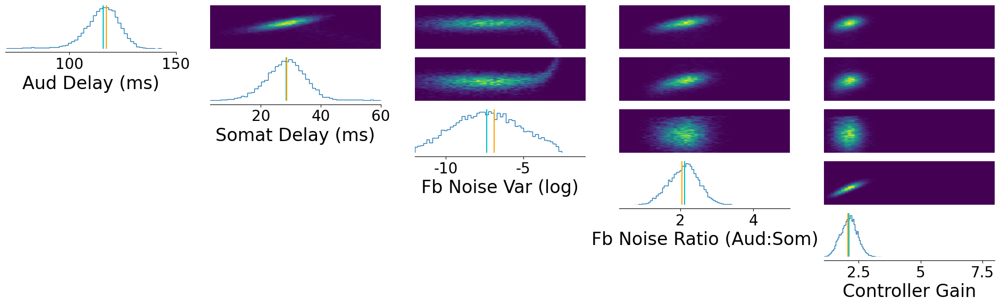

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01779996951421102 min


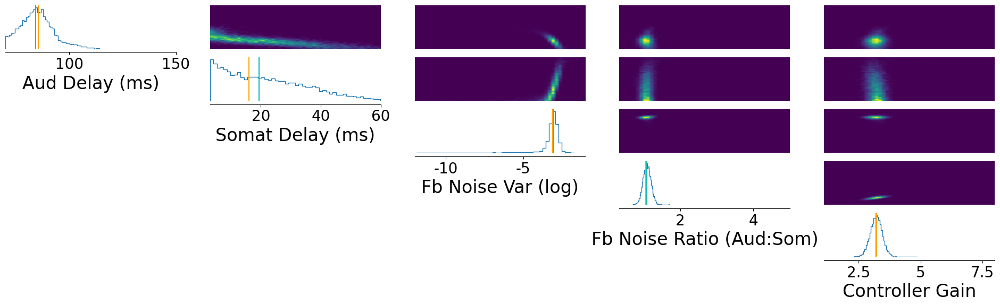

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013750000794728597 min


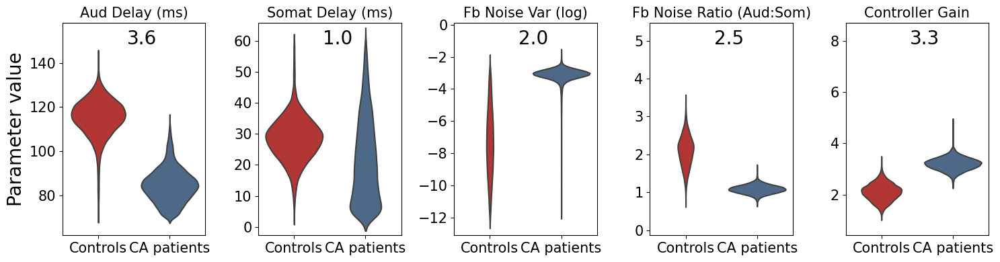

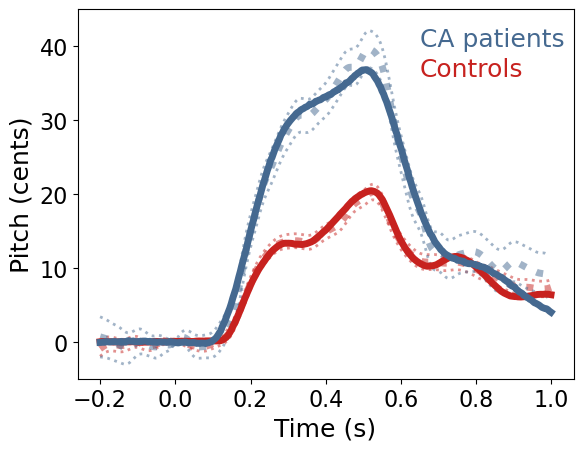

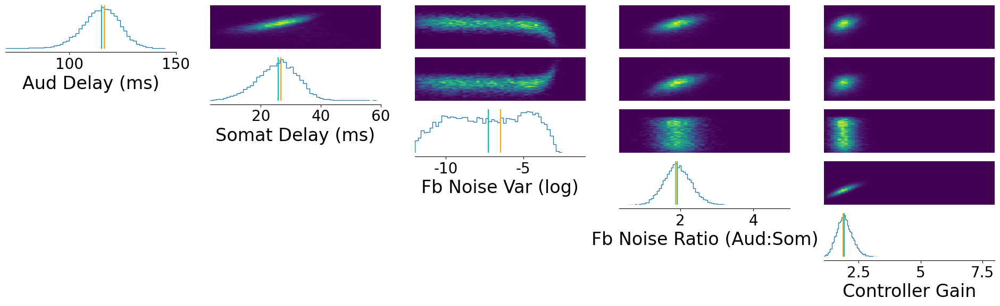

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.013933324813842773 min


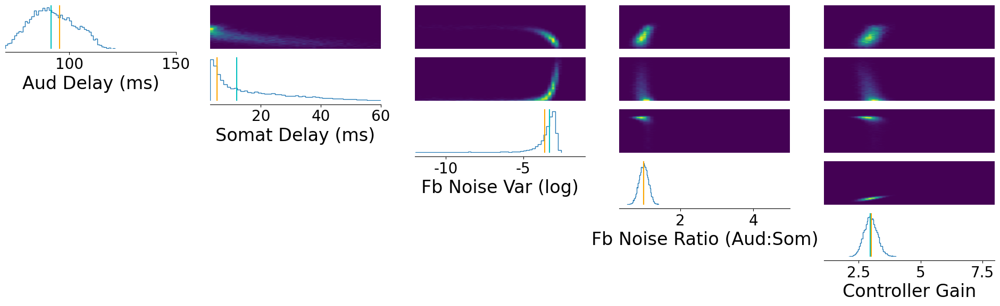

BOOTSTRAP TIME: 0.0004833420117696126 min
PLOT SIM TIME: 0.1639543612798055 min
VIOLIN PLOT TIME: 19.61683920621872 min


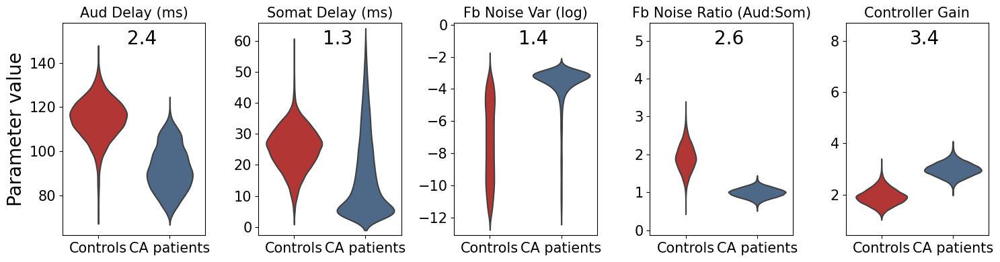

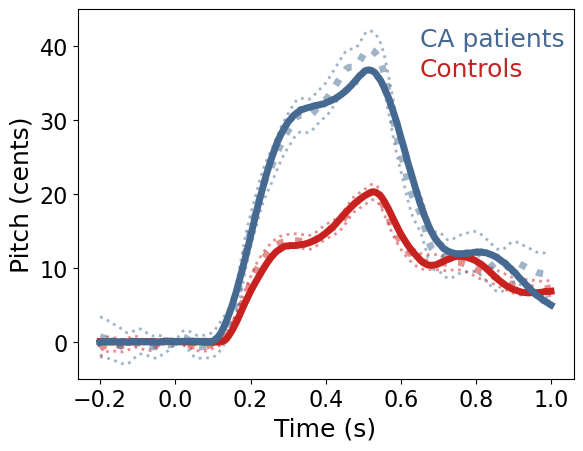

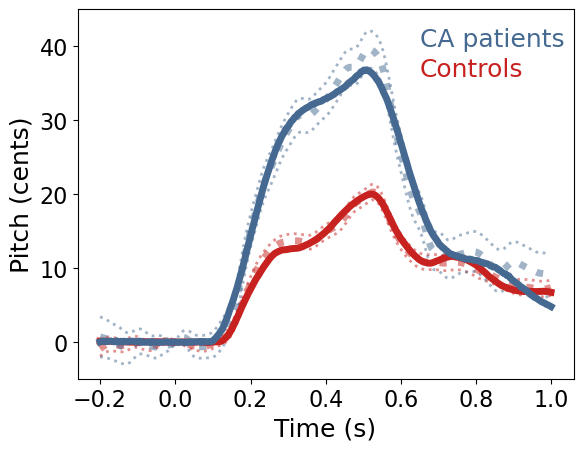

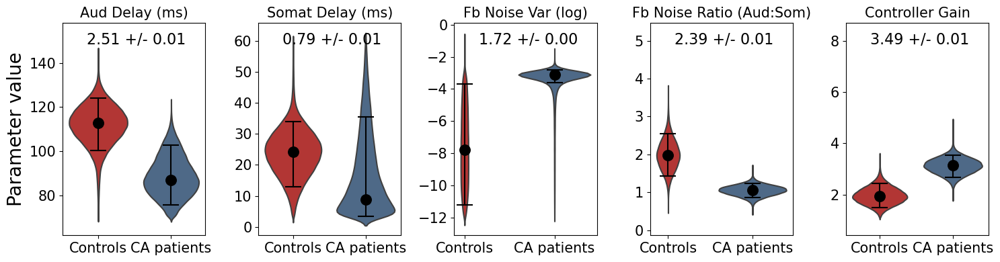

In [10]:
def simulator(parameter_set):
    training_noise_scale = 9
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

inferred_values, rmse_means_all[4,:], rmse_sterr_all[4,:] = run_sbi('training_noise_9',observation_list,n_reps,prior_min_all,prior_max_all,all_labels,train=train)

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011683340867360432 min


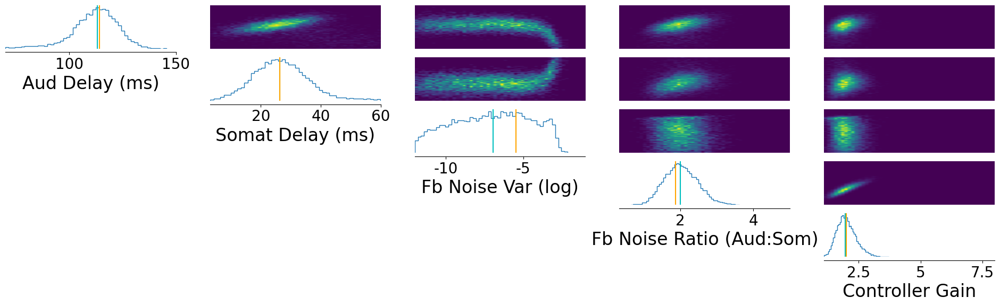

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01174998680750529 min


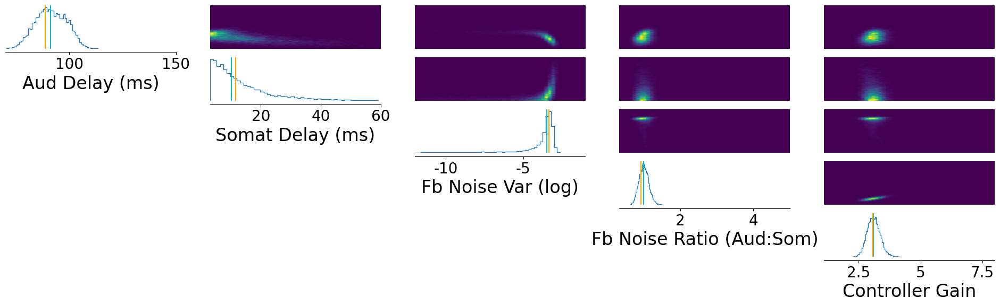

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012149957815806071 min


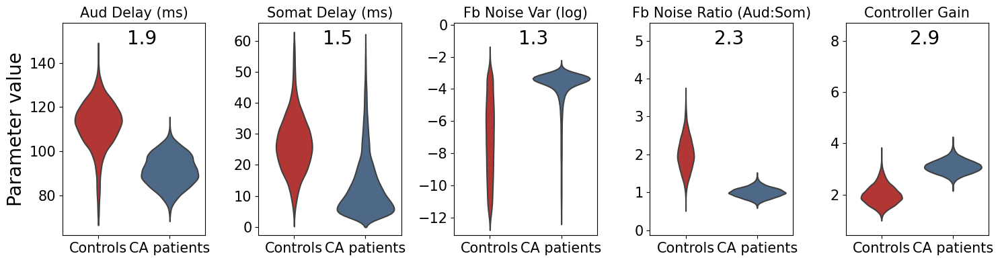

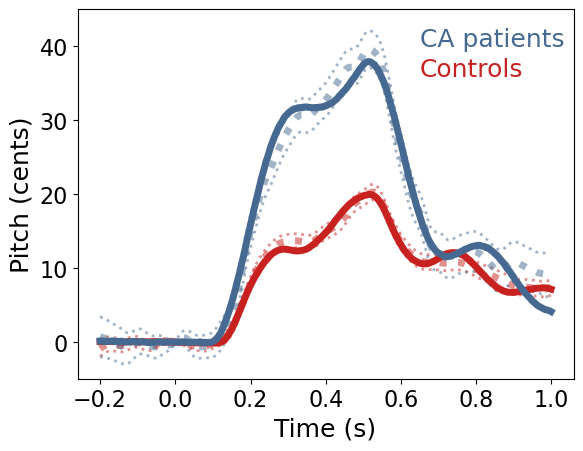

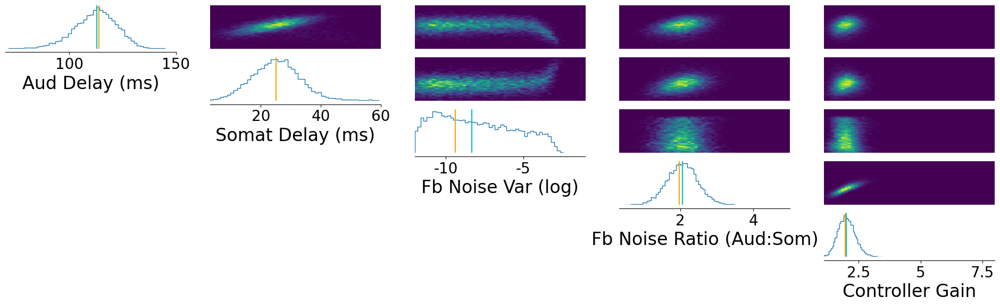

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012749985853830973 min


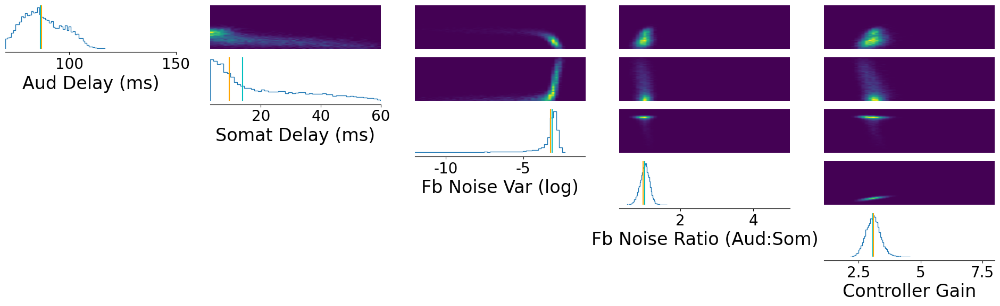

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011466491222381591 min


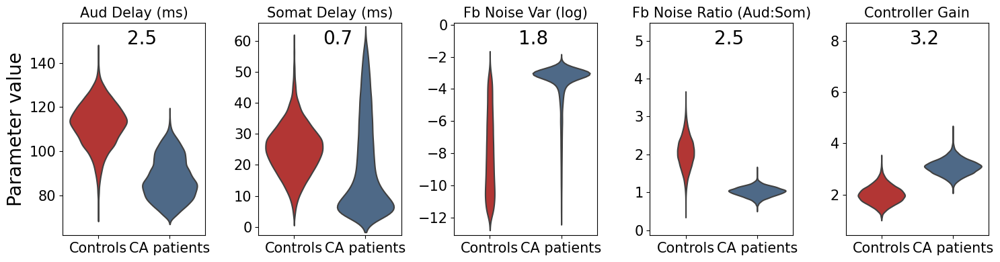

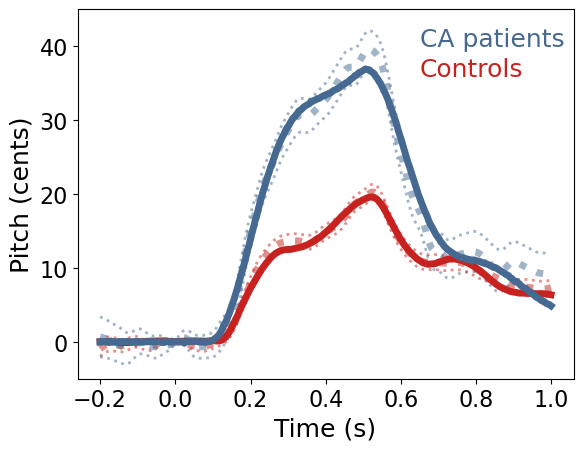

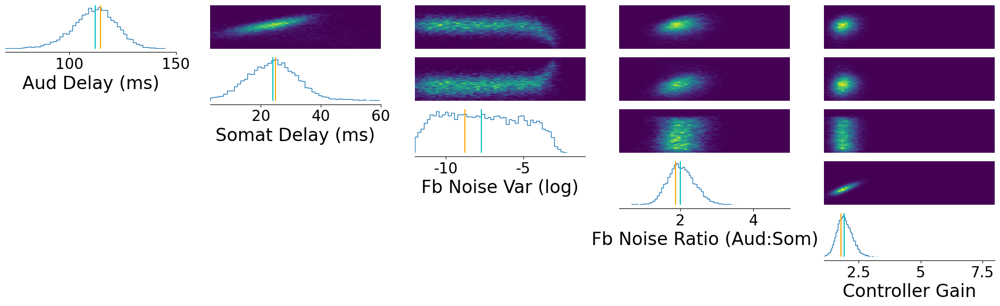

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012183316548665364 min


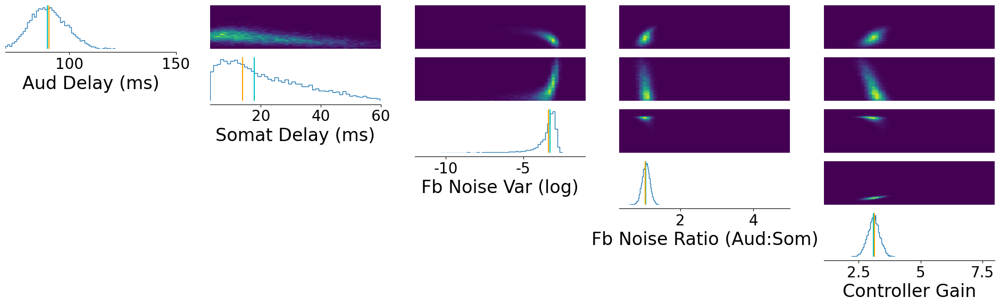

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01064051389694214 min


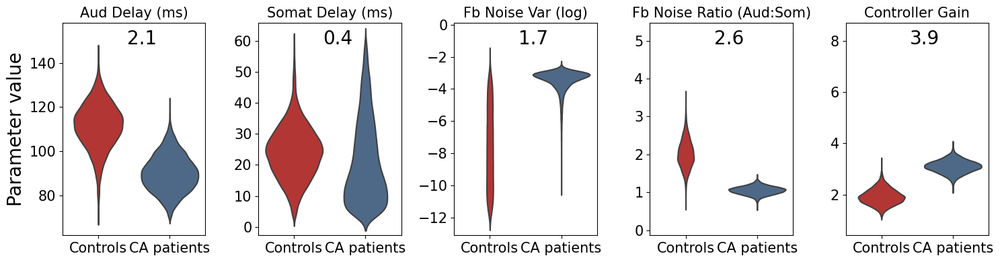

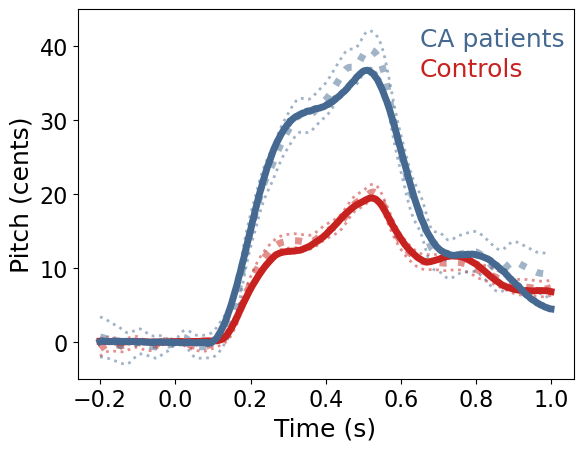

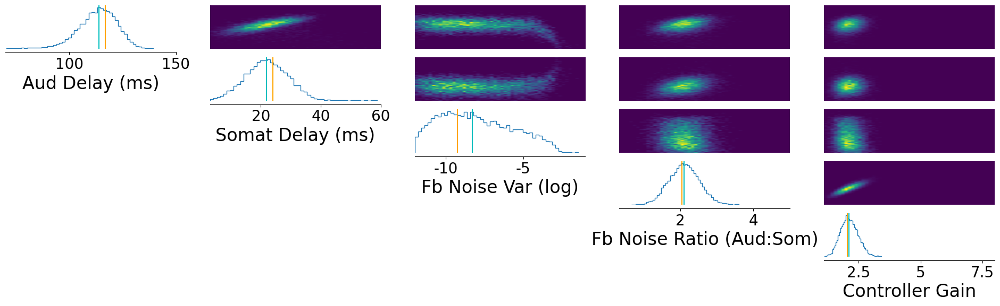

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011957339445749919 min


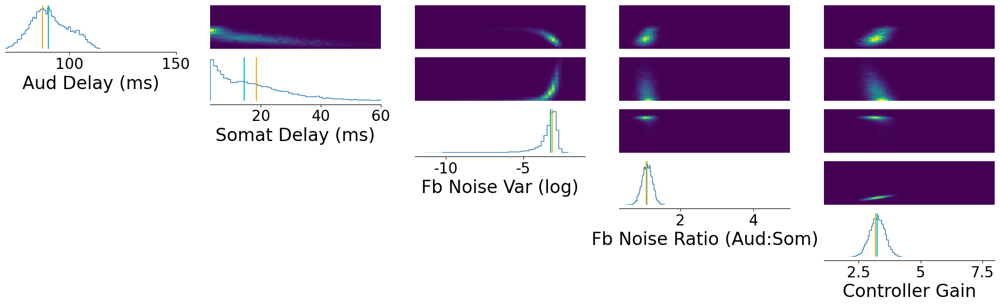

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011482107639312743 min


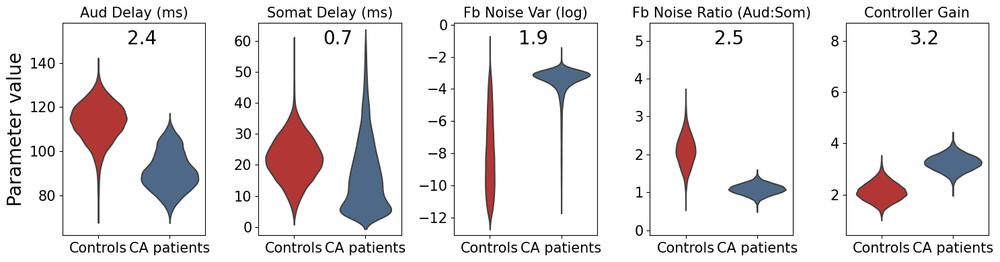

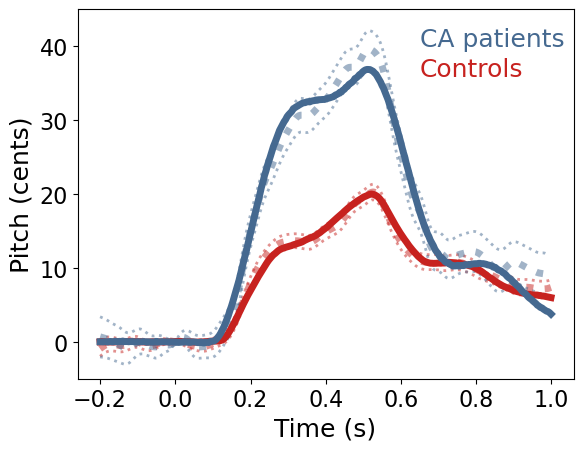

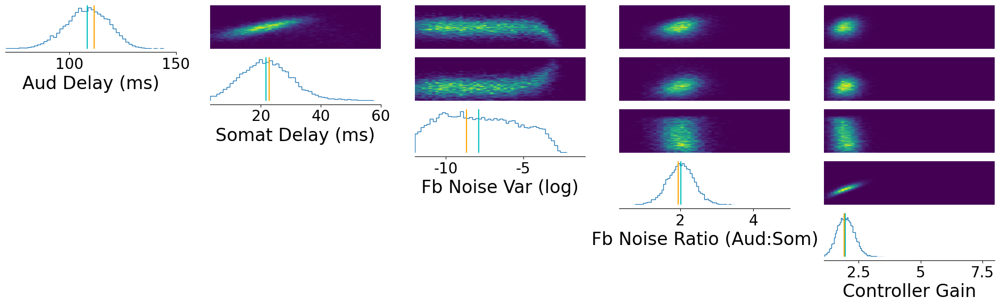

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.012089884281158448 min


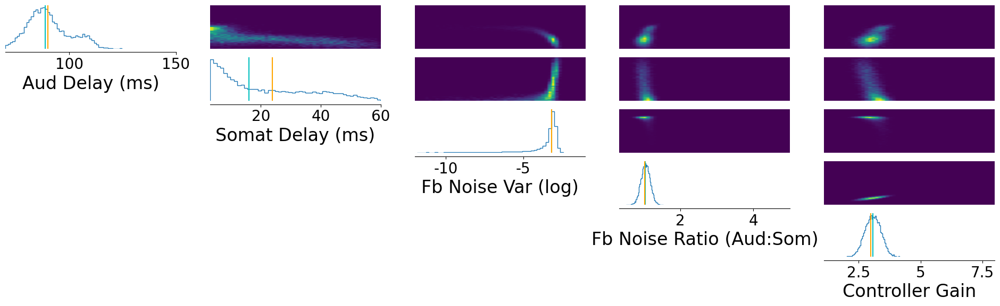

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01108789046605428 min


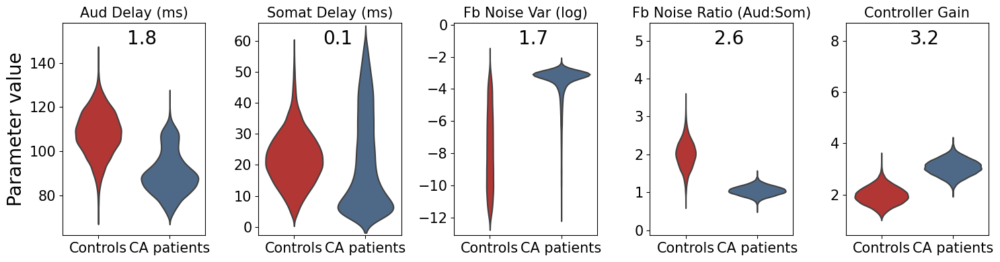

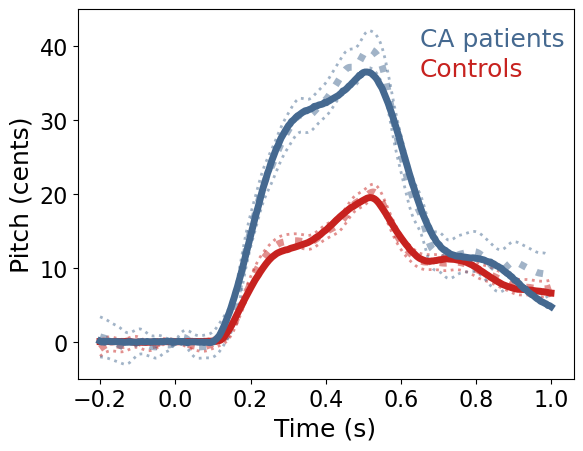

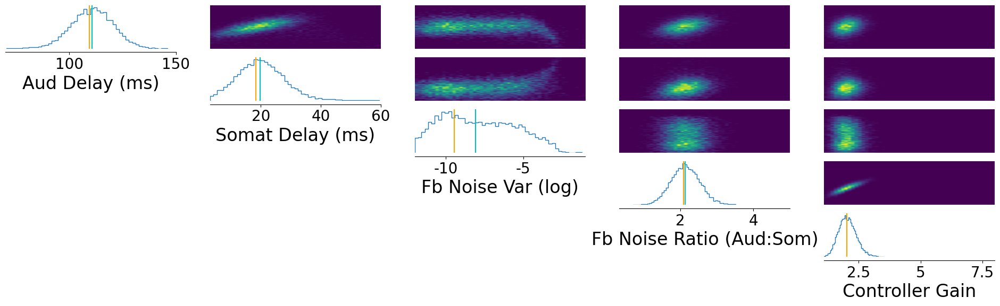

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011383525530497233 min


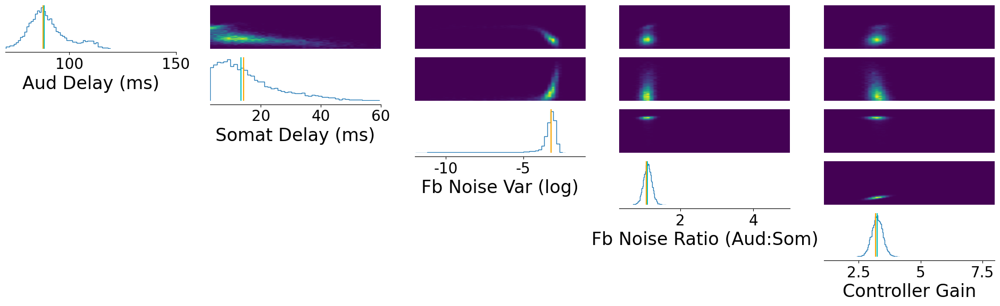

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011892799536387126 min


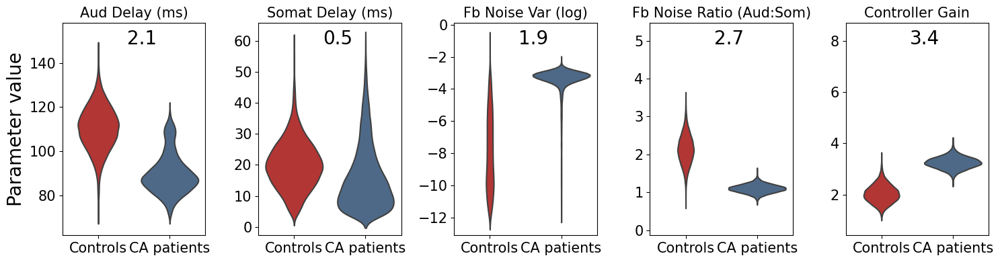

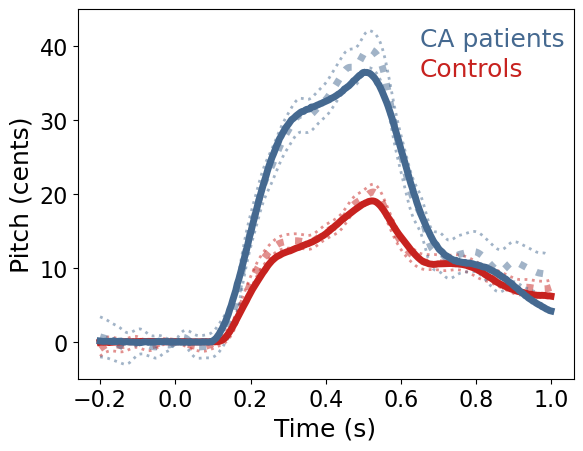

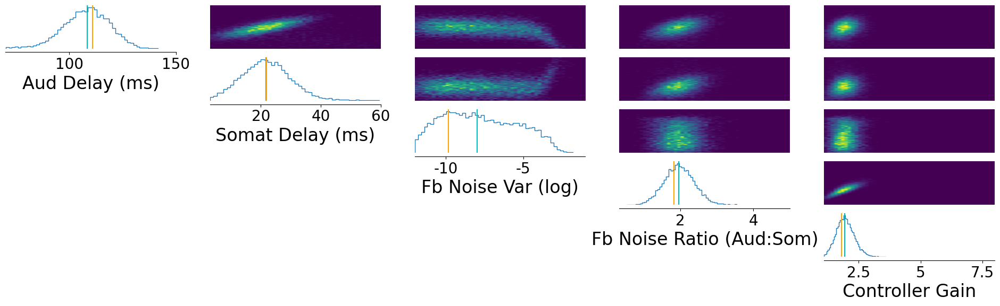

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01181015968322754 min


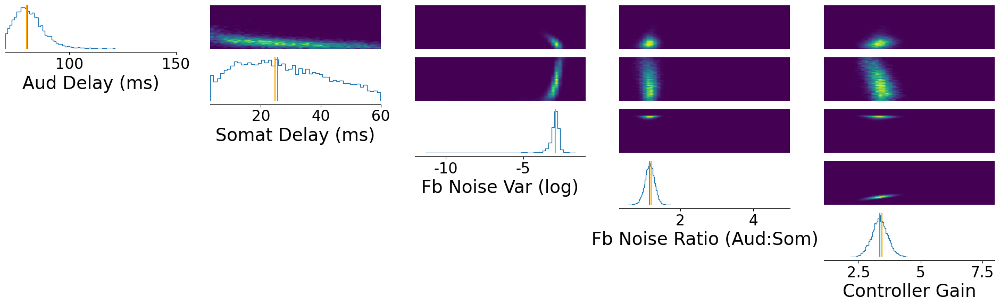

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.01169569492340088 min


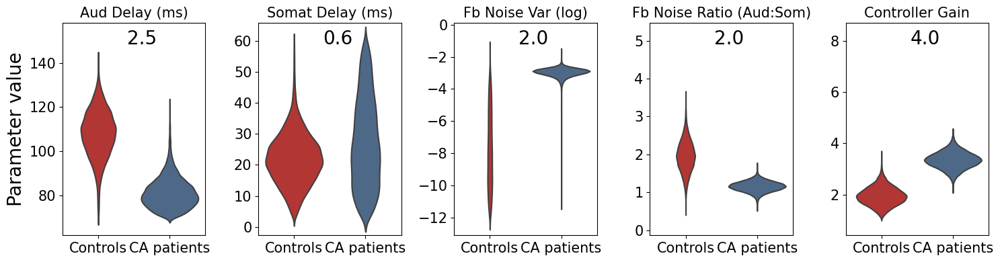

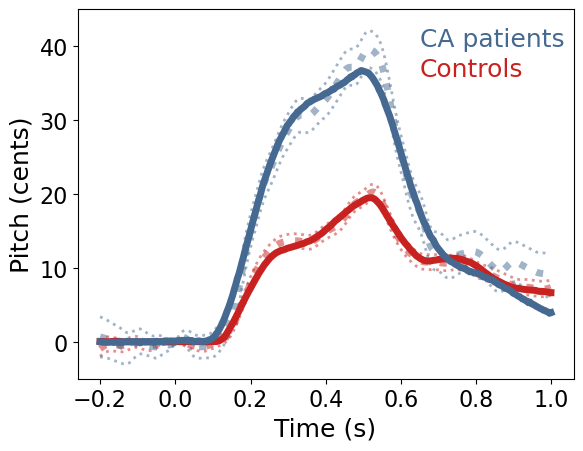

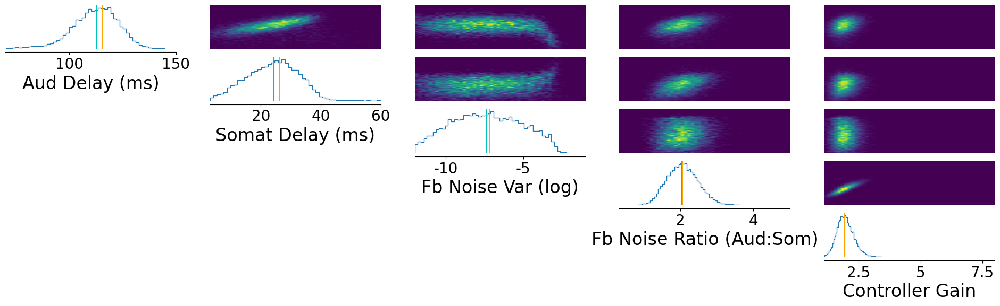

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011891456445058186 min


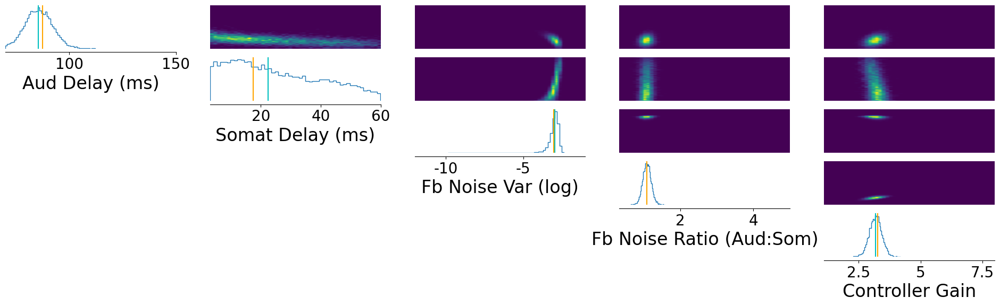

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011367106437683105 min


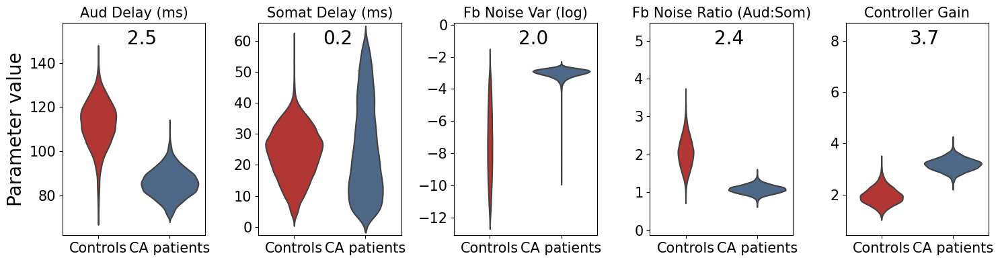

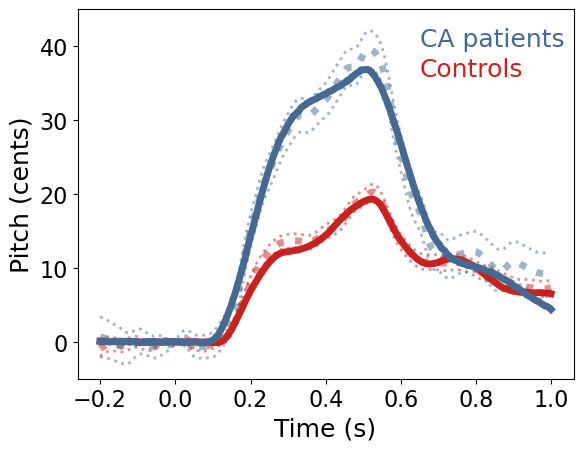

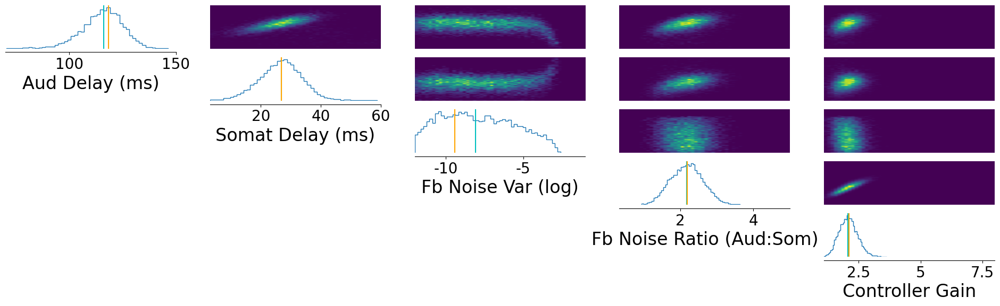

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011546615759531658 min


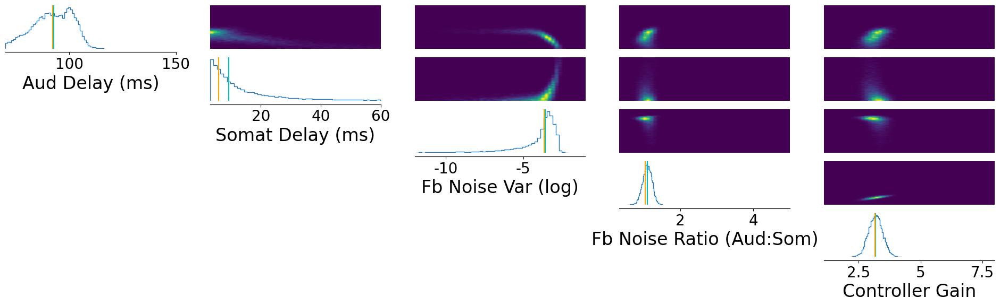

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.011761355400085449 min


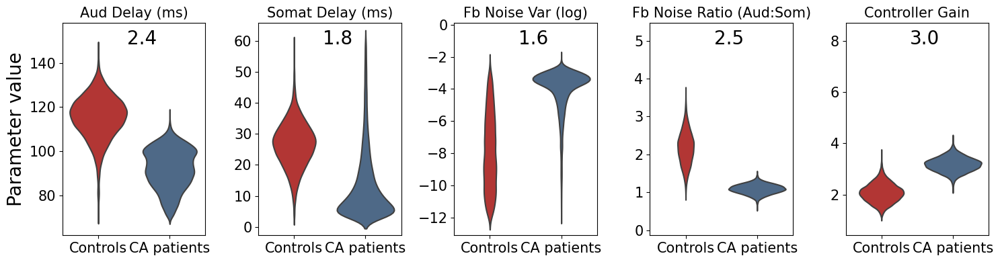

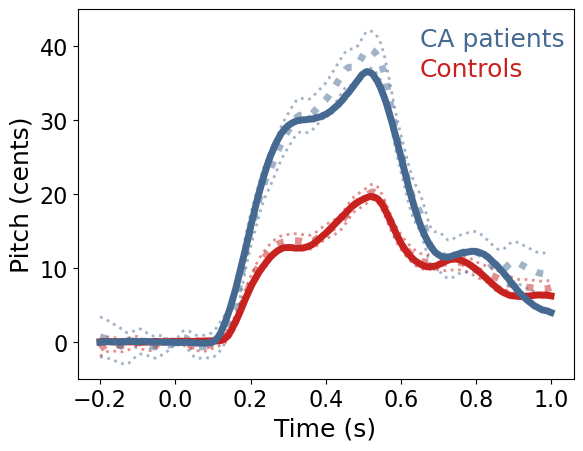

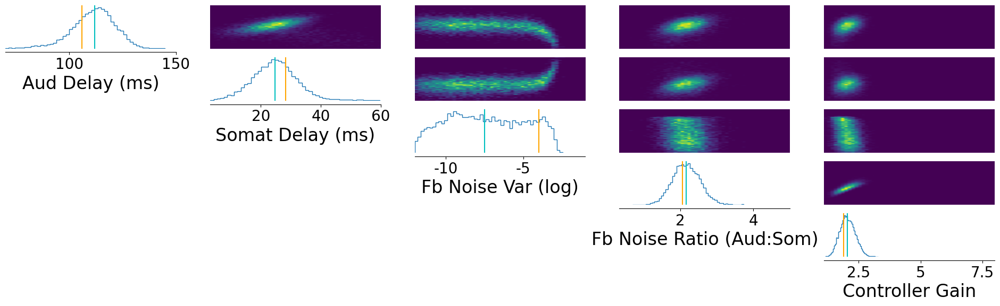

Drawing 10000 posterior samples:   0%|          | 0/10000 [00:00<?, ?it/s]

SAMPLING TIME: 0.017034272352854412 min


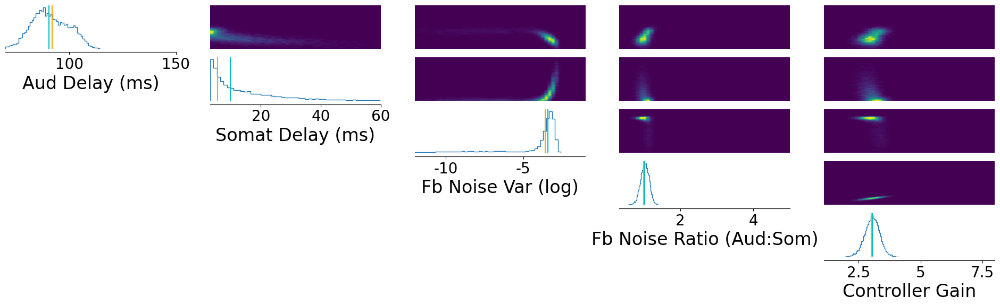

BOOTSTRAP TIME: 0.0005584994951883952 min
PLOT SIM TIME: 0.37184099356333417 min
VIOLIN PLOT TIME: 26.792432355880738 min


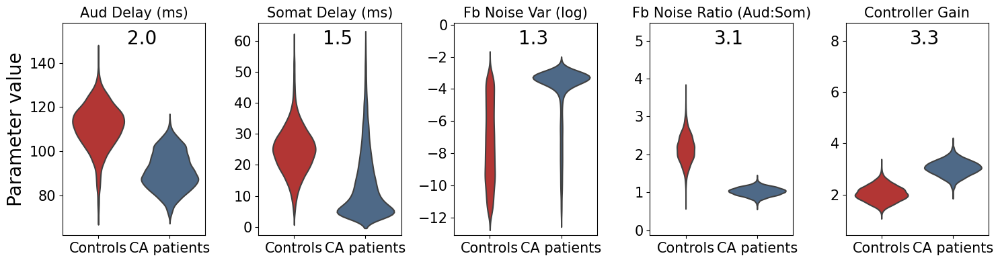

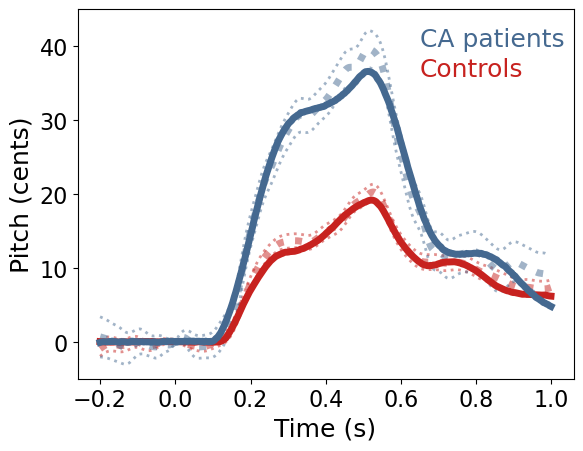

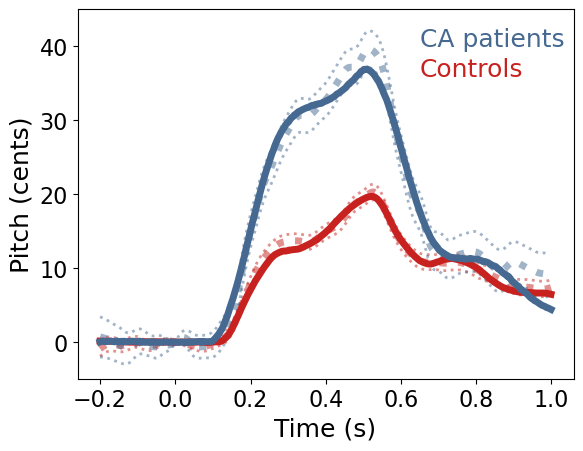

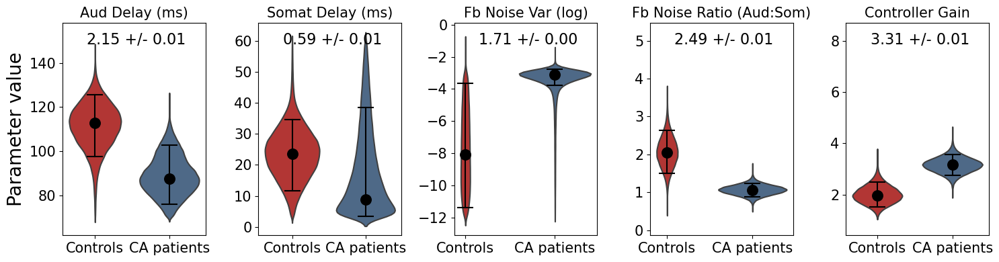

In [11]:
def simulator(parameter_set):
    training_noise_scale = 12
    pitch_output_cents = simulator_no_noise(parameter_set)
    pitch_output_cents_wnoise = pitch_output_cents + ((np.random.rand(len(pitch_output_cents)) - 0.5) * training_noise_scale)
    return pitch_output_cents_wnoise

inferred_values, rmse_means_all[5,:], rmse_sterr_all[5,:] = run_sbi('training_noise_12',observation_list,n_reps,prior_min_all,prior_max_all,all_labels,train=train)

<Figure size 200x300 with 0 Axes>

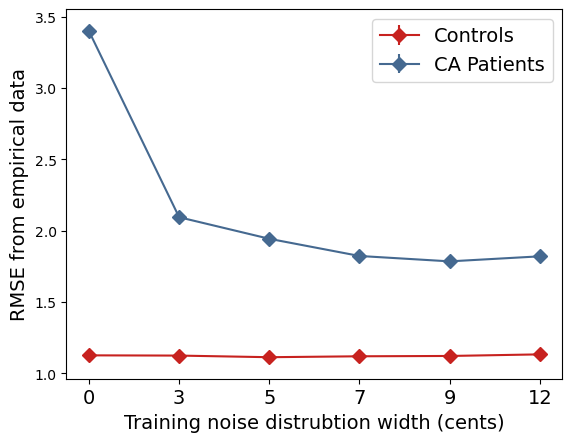

In [12]:
x = np.array([0,3,5,7,9,12])
bar_df = pd.DataFrame(rmse_means_all,columns=['Controls','CA Patients'])
se_df = pd.DataFrame(rmse_sterr_all,columns = ['Controls','CA Patients'])
plt.figure(figsize=(2,3))
bar_df.plot(kind='line',yerr=se_df,rot=0,marker='D',markersize=7,color=[observation_list[0].get('color'),observation_list[1].get('color')])
plt.ylabel('RMSE from empirical data',fontsize=14)
plt.xticks(ticks=range(len(x)),labels=x,fontsize=14)
#plt.yticks(ticks=range(1,6),fontsize=14)
plt.xlabel('Training noise distrubtion width (cents)',fontsize=14)
plt.legend(fontsize=14)
plt.show()